## _ 01. Импорт библиотек.

In [ ]:
# ---- pip install
! pip install xgboost
! pip install scikeras[tensorflow]

# ---- база
import numpy as np                                      # для работы с многомерными массивами 
import pandas as pd                                     # для обработки данных
import matplotlib.pyplot as plt                         # для построения графиков
import seaborn as sns                                   # для статистической визуализации
              
# ---- работа с датафреймами
from pandas import DataFrame

# ---- sklearn
from sklearn.preprocessing import LabelEncoder          # для кодирования переменных
from sklearn.preprocessing import MinMaxScaler, RobustScaler, StandardScaler, PowerTransformer, Normalizer    # для нормализации и стандартизации
from sklearn.model_selection import train_test_split    # для разделения датасета на тренировочную и тестовую выборки
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error, mean_absolute_percentage_error # метрики для алгорритмов машиннного обучения
# -- algorithms & models
from sklearn.neighbors import KNeighborsRegressor       # Метод К-ближайших соседей
from sklearn.svm import SVR                             # Метод опорных векторов
from sklearn.linear_model import LinearRegression       # Линейная регрессия
from sklearn.tree import DecisionTreeRegressor          # Дерево решений
from sklearn.ensemble import AdaBoostRegressor          # AdaBoost
from sklearn.ensemble import GradientBoostingRegressor  # Градиентный бустинг
from sklearn.ensemble import RandomForestRegressor      # Случайный лес
from sklearn.linear_model import SGDRegressor           # Стохастический градиентный спуск
from sklearn.linear_model import Lasso                  # Метод регрессии «Lasso»
from sklearn.pipeline import make_pipeline              # для создания пайплайна
from sklearn.model_selection import GridSearchCV        # для подбора параметров модели машинного обучения
from xgboost import XGBRegressor                        # XGBoost

# ---- scipy
from scipy import stats                                 # Статистические функции
from scipy.stats import shapiro                         # Тест Шапиро-Уилка на нормальность           

# ---- keras
import tensorflow.keras as keras                        
from keras.models import Sequential
from keras.layers import Dense, Flatten, Input, Dropout
from tensorflow.keras import utils
from tensorflow.keras.optimizers import Adam, SGD, RMSprop, Adagrad
# -- my -- no import for KerasRegressor -- Error
# from scikeras.wrappers import KerasRegressor
# - solution 1 -- yes
from tensorflow import keras
try:
    import scikeras
except ImportError:
    !python -m pip install scikeras
from scikeras.wrappers import KerasClassifier, KerasRegressor
# --

# ---- model operations
from joblib import dump, load                           # для сохранения и загрузки моделей 
from tensorflow.keras.models import load_model          # для загрузки моделей 

import warnings                                         # контроль предупреждения
warnings.filterwarnings("default", category=FutureWarning)
warnings.simplefilter(action='ignore', category=FutureWarning)

# ---- flask
import flask
from flask import Flask, request, render_template

# для корректного отображения графиков в окне браузера
%matplotlib inline  

# ---- pretify output
from google.colab import widgets
from google.colab import data_table


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
# --- python version check
# import sys
# print(sys.version)
# --- [alternative] ---
!python --version  # checks version from command line

Python 3.9.16


## _ 02. Загрузка и обработка исходных датасетов.

In [ ]:
# ---- ---- Загрузка исходного датасета из github; --- ----
# -- Разово.  Удалить лишнее из GoogleColab, создать папаку, проверить;
! pwd && ls -la && rm -r /content/sample_data 
! mkdir /content/dataset
print(f'\n---- Мусор ("sample_data") удален, целевая папка "dataset" создана:\n')
# контроль
!ls -la | grep "dataset"

/content
total 24
drwxr-xr-x 1 root root 4096 Apr 26 00:19 .
drwxr-xr-x 1 root root 4096 Apr 26 00:11 ..
drwxr-xr-x 4 root root 4096 Apr 24 17:04 .config
drwxr-xr-x 2 root root 4096 Apr 26 00:19 dataset
drwxr-xr-x 2 root root 4096 Apr 26 00:19 .ipynb_checkpoints
rm: cannot remove '/content/sample_data': No such file or directory
mkdir: cannot create directory ‘/content/dataset’: File exists

---- Мусор ("sample_data") удален, целевая папка "dataset" создана:

drwxr-xr-x 2 root root 4096 Apr 26 00:19 dataset


In [ ]:
# --- ERROR GOOGLE COLLAB ---
# Дурная плавающая ошибка при загрузке датасета из github, GoogleDrive;
# Возникает от запуска к запуску - то ругается на движки при чтении .xlsx, 
# то на сам .csv, то на 28 строку (Error tokenizing data)
# то на отсутствие названия первого столбца,
# то на то, что это не .zip ... Устал автоматизировать ... 
# Определил, что стабильно работает во вражеском collab-e только 
# при мануальной загрузке *.xlsx или *.csv, причем не по запросу из ячейки,
# а только ручками из интерфейса браузера... фиг с ним... 
# Пока 1:0 в борьбе полупроводников с миллионами лет биологической эволюции ..  

print(f'--- Добрый человек, в G-Collab загрузи-ка ручками датасет в папочку "dataset", пожалуйста.')
print(f'Подробности можешь посмотреть в закомментированной ячейке "arxiv. Битва с автоматизацией загрузки."')
print(f'... там детально описаны все пароксизмальные проявления в анамнезе... Лучше просто загрузи ручками.')

# ! pwd && ls -lA && cd /content/dataset/ && pwd && ls -lA


--- Добрый человек, в G-Collab загрузи-ка ручками датасет в папочку "dataset", пожалуйста.
Подробности можешь посмотреть в закомментированной ячейке "arxiv. Битва с автоматизацией загрузки."
... там детально описаны все пароксизмальные проявления в анамнезе... Лучше просто загрузи ручками.


#### arxiv. Битва с автоматизацией загрузки.

In [ ]:
# ---- цель: Автоматизация загрузки датасета из предоставленных файлов *.xlsx и создание объекта pandas ----
# -- v-01 _ Загрузка исходного датасета из github;
# -- Разово.  Удалить лишнее из GoogleColab, создать папаку, проверить;
# ! pwd && ls -la && rm -r /content/sample_data 
# ! mkdir /content/dataset
# print(f'\n---- Мусор ("sample_data") удален, целевая папка создана:\n')
# контроль
# !ls -la | grep "dataset"
# -- Загрузка датасета из гитхаба в папку 'dataset' (не только *.xlsx но и *.csv)
# Грузить - грузит, но при создании объекта pandas ругается то *.xlsx (select engine manually - но ни один не срабатывает),
# то на *.csv ( error tokenizing data.; expected 1 fields in line 28, saw 367;
# -- опробовано:
# !wget -qc https://github.com/wwwmyroot/DS_graduate/blob/main/dataset/in_x_bp.xlsx -P "/content/dataset"
# !wget -qc https://github.com/wwwmyroot/DS_graduate/blob/main/dataset/in_x_nup.xlsx -P "/content/dataset"
# !wget -qc https://github.com/wwwmyroot/DS_graduate/blob/main/dataset/in_x_bp.csv -P "/content/dataset"
# !wget -qc https://github.com/wwwmyroot/DS_graduate/blob/main/dataset/in_x_nup.csv -P "/content/dataset"
# !wget -qc https://github.com/wwwmyroot/DS_graduate/blob/main/dataset/in_1col_x_bp.csv -P "/content/dataset"
# !wget -qc https://github.com/wwwmyroot/DS_graduate/blob/main/dataset/in_1col_x_nup.csv -P "/content/dataset"
# !wget -qc https://github.com/wwwmyroot/DS_graduate/blob/main/dataset/in_x_bp.zip -P "/content/dataset"
# !wget -qc https://github.com/wwwmyroot/DS_graduate/blob/main/dataset/in_x_nup.zip -P "/content/dataset"

# ---- попытки создать pandas-обект ----
# dataset_bp = pd.DataFrame(pd.read_excel("/content/dataset/in_x_bp.xlsx", engine="openpyxl", skiprows=0))
# dataset_nup = pd.DataFrame(pd.read_excel("/content/dataset/in_x_nup.xlsx", engine="openpyxl", skiprows=0))
# dataset_bp = pd.DataFrame(pd.read_excel("/content/dataset/in_x_bp.xlsx", engine="xlrd"))
# dataset_nup = pd.DataFrame(pd.read_excel("/content/dataset/in_x_nup.xlsx", engine="xlrd"))
# dataset_bp = pd.DataFrame(pd.read_csv("/content/dataset/in_1col_x_bp.csv", sep="\t"))
# dataset_nup = pd.DataFrame(pd.read_csv("/content/dataset/in_1col_x_nup.csv", sep="\t"))
# dataset_bp = pd.DataFrame(pd.read_csv("/content/dataset/in_1col_x_bp.csv", sep=","))
# dataset_nup = pd.DataFrame(pd.read_csv("/content/dataset/in_1col_x_nup.csv", sep=","))
# dataset_bp = pd.read_csv("/content/dataset/in_1col_x_bp.csv", delimiter=',', skiprows=0, low_memory=False)
# dataset_nup = pd.read_csv("/content/dataset/in_1col_x_nup.csv", delimiter=',', skiprows=0, low_memory=False)
# dataset_bp = pd.read_csv("/content/dataset/in_1col_x_bp.csv", sep="\t", skiprows=0, low_memory=False)
# dataset_nup = pd.read_csv("/content/dataset/in_1col_x_nup.csv", sep="\t", skiprows=0, low_memory=False)
# dataset_bp = pd.DataFrame(pd.read_excel("/content/dataset/in_x_bp.xlsx", engine="openpyxl"))
# dataset_nup = pd.DataFrame(pd.read_excel("/content/dataset/in_x_nup.xlsx", engine="openpyxl"))
# dataset_bp = pd.DataFrame(pd.read_csv("/content/dataset/in_1col_x_bp.csv"))
# dataset_nup = pd.DataFrame(pd.read_csv("/content/dataset/in_1col_x_nup.csv"))
# dataset_bp = pd.read_csv("/content/dataset/in_1col_x_bp.csv")
# dataset_nup = pd.read_csv("/content/dataset/in_1col_x_nup.csv")

# ---- pretty print after --
# t = widgets.TabBar(["-| план |-", "-| результат |-"])
# with t.output_to(0):
#   print("1) Удалить папку 'sample_data'.")
#   print("2) Cоздать папку 'dataset'.")
#   print("3) Загрузить характеристики базальтопластика.")
#   print("4) Загрузить характеристики нашивки из углепластика.")
#   print("5) Всё проверить.")

# with t.output_to(1):
#   print("1) Удалена папка 'sample_data'.")
#   print("2) Cоздана целевая папка 'dataset'.")
#   print("3) Загружены характеристики базальтопластика. -> Файл 'X_bp.xlsx'.")
#   print("4) Загружены характеристики нашивки из углепластика.-> Файл 'X_nup.xlsx'. ")
#   print("5) Всё проверено. OK.")

## **Первый просмотр сырого датасета.**

In [ ]:
# --- After manual download *.xlsx
dataset_bp = pd.DataFrame(pd.read_excel("/content/dataset/in_x_bp.xlsx", engine="openpyxl", skiprows=0))
dataset_nup = pd.DataFrame(pd.read_excel("/content/dataset/in_x_nup.xlsx", engine="openpyxl", skiprows=0))
dataset_bp.head()

,Unnamed: 0,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2"
0,0,1.857143,2030.0,738.736842,30.00,22.267857,100.000000,210.0,70.0,3000.0,220.0
1,1,1.857143,2030.0,738.736842,50.00,23.750000,284.615385,210.0,70.0,3000.0,220.0
2,2,1.857143,2030.0,738.736842,49.90,33.000000,284.615385,210.0,70.0,3000.0,220.0
3,3,1.857143,2030.0,738.736842,129.00,21.250000,300.000000,210.0,70.0,3000.0,220.0
4,4,2.771331,2030.0,753.000000,111.86,22.267857,284.615385,210.0,70.0,3000.0,220.0


In [ ]:
# Посмотрим размерность первого датасета dataset_bp 
dataset_bp.shape

(1023, 11)

In [ ]:
# Выведем последних 5 позиций датасета
dataset_bp.tail()

,Unnamed: 0,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2"
1018,1018,2.271346,1952.087902,912.855545,86.992183,20.123249,324.774576,209.198700,73.090961,2387.292495,125.007669
1019,1019,3.444022,2050.089171,444.732634,145.981978,19.599769,254.215401,350.660830,72.920827,2360.392784,117.730099
1020,1020,3.280604,1972.372865,416.836524,110.533477,23.957502,248.423047,740.142791,74.734344,2662.906040,236.606764
1021,1021,3.705351,2066.799773,741.475517,141.397963,19.246945,275.779840,641.468152,74.042708,2071.715856,197.126067
1022,1022,3.808020,1890.413468,417.316232,129.183416,27.474763,300.952708,758.747882,74.309704,2856.328932,194.754342


Столбец "Unnamed: 0" является неинформативным, т.к. содержит порядковые номера композитов в таблице и совпадает со столбцом индекса.
Удалить данный столбец можно 2 способами: 

1 - непосредственно при загрузке файла, заменив столбец с индексами столбцом "Unnamed: 0".

2 - используя функцию drop.

In [ ]:
# Воспользуемся первым способом для удаления столбца "Unnamed: 0" и перезагрузим датасет. Выведем 5 первых строк.
dataset_bp = pd.read_excel('/content/dataset/in_x_bp.xlsx', index_col=0)
dataset_bp.head()

,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2"
0,1.857143,2030.0,738.736842,30.00,22.267857,100.000000,210.0,70.0,3000.0,220.0
1,1.857143,2030.0,738.736842,50.00,23.750000,284.615385,210.0,70.0,3000.0,220.0
2,1.857143,2030.0,738.736842,49.90,33.000000,284.615385,210.0,70.0,3000.0,220.0
3,1.857143,2030.0,738.736842,129.00,21.250000,300.000000,210.0,70.0,3000.0,220.0
4,2.771331,2030.0,753.000000,111.86,22.267857,284.615385,210.0,70.0,3000.0,220.0


In [ ]:
# Посмотрим размерность первого датасета dataset_bp после замены столбца
dataset_bp.shape

(1023, 10)

In [ ]:
# Загрузим датасет из файла "in_x_nup.xlsx" (характеристики нашивки из углепластика) и выведем 5 первых позиций датасета
dataset_nup = pd.read_excel('/content/dataset/in_x_nup.xlsx')
dataset_nup.head()

,Unnamed: 0,"Угол нашивки, град",Шаг нашивки,Плотность нашивки
0,0,0,4.0,57.0
1,1,0,4.0,60.0
2,2,0,4.0,70.0
3,3,0,5.0,47.0
4,4,0,5.0,57.0


In [ ]:
# Посмотрим размерность второго датасета dataset_nup
dataset_nup.shape

(1040, 4)

In [ ]:
# Воспользуемся вторым способом (с помощью функции drop) для удаления столбца "Unnamed: 0". Выведем 5 первых строк.
dataset_nup.drop(['Unnamed: 0'], axis=1, inplace=True)
dataset_nup.head()

,"Угол нашивки, град",Шаг нашивки,Плотность нашивки
0,0,4.0,57.0
1,0,4.0,60.0
2,0,4.0,70.0
3,0,5.0,47.0
4,0,5.0,57.0


In [ ]:
# Посмотрим размерность второго датасета dataset_nup после удаления столбца
dataset_nup.shape

(1040, 3)

Датасеты имеют разное количество строк: 1023 строки у dataset_bp, 1040 строк у dataset_nup

In [ ]:
# Объединеним датесеты в один
# Объединение выполним с помощью функции merge() по индексу с типом объединения INNER
dataset = pd.merge(dataset_bp, dataset_nup, 
                   left_index=True, 
                   right_index=True, 
                   how = "inner")

# Выведем 5 первых позиций нового датасета
dataset.head()

,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2","Угол нашивки, град",Шаг нашивки,Плотность нашивки
0,1.857143,2030.0,738.736842,30.00,22.267857,100.000000,210.0,70.0,3000.0,220.0,0,4.0,57.0
1,1.857143,2030.0,738.736842,50.00,23.750000,284.615385,210.0,70.0,3000.0,220.0,0,4.0,60.0
2,1.857143,2030.0,738.736842,49.90,33.000000,284.615385,210.0,70.0,3000.0,220.0,0,4.0,70.0
3,1.857143,2030.0,738.736842,129.00,21.250000,300.000000,210.0,70.0,3000.0,220.0,0,5.0,47.0
4,2.771331,2030.0,753.000000,111.86,22.267857,284.615385,210.0,70.0,3000.0,220.0,0,5.0,57.0


In [ ]:
# Посмотрим размерность объединенного датасета
dataset.shape

(1023, 13)

Объединенный датасет содержит 1023 строки и 13 столбцов. Это означает, что часть данных (а именно 17 строк из датасета dataset_nup) была удалена из таблицы и исключена из дальнейшего исследования.

In [ ]:
# Сохраним объединенный датасет в новый файл для дальнейшей работы
! mkdir /content/dataset_join
dataset.to_excel('/content/dataset_join/X_full.xlsx')

In [ ]:
# Создадим копию объединенного датасета для дальнейшей работы
df = dataset.copy()

## _ 03. Разведочный анализ данных.

In [ ]:
# Датасет для дальнейшей работы выглядит следующим образом:
df

,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2","Угол нашивки, град",Шаг нашивки,Плотность нашивки
0,1.857143,2030.000000,738.736842,30.000000,22.267857,100.000000,210.000000,70.000000,3000.000000,220.000000,0,4.000000,57.000000
1,1.857143,2030.000000,738.736842,50.000000,23.750000,284.615385,210.000000,70.000000,3000.000000,220.000000,0,4.000000,60.000000
2,1.857143,2030.000000,738.736842,49.900000,33.000000,284.615385,210.000000,70.000000,3000.000000,220.000000,0,4.000000,70.000000
3,1.857143,2030.000000,738.736842,129.000000,21.250000,300.000000,210.000000,70.000000,3000.000000,220.000000,0,5.000000,47.000000
4,2.771331,2030.000000,753.000000,111.860000,22.267857,284.615385,210.000000,70.000000,3000.000000,220.000000,0,5.000000,57.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1018,2.271346,1952.087902,912.855545,86.992183,20.123249,324.774576,209.198700,73.090961,2387.292495,125.007669,90,9.076380,47.019770
1019,3.444022,2050.089171,444.732634,145.981978,19.599769,254.215401,350.660830,72.920827,2360.392784,117.730099,90,10.565614,53.750790
1020,3.280604,1972.372865,416.836524,110.533477,23.957502,248.423047,740.142791,74.734344,2662.906040,236.606764,90,4.161154,67.629684
1021,3.705351,2066.799773,741.475517,141.397963,19.246945,275.779840,641.468152,74.042708,2071.715856,197.126067,90,6.313201,58.261074


In [ ]:
# Посмотрим информацию обо всех столбцах датасета
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1023 entries, 0 to 1022
Data columns (total 13 columns):
 #   Column                                Non-Null Count  Dtype  
---  ------                                --------------  -----  
 0   Соотношение матрица-наполнитель       1023 non-null   float64
 1   Плотность, кг/м3                      1023 non-null   float64
 2   модуль упругости, ГПа                 1023 non-null   float64
 3   Количество отвердителя, м.%           1023 non-null   float64
 4   Содержание эпоксидных групп,%_2       1023 non-null   float64
 5   Температура вспышки, С_2              1023 non-null   float64
 6   Поверхностная плотность, г/м2         1023 non-null   float64
 7   Модуль упругости при растяжении, ГПа  1023 non-null   float64
 8   Прочность при растяжении, МПа         1023 non-null   float64
 9   Потребление смолы, г/м2               1023 non-null   float64
 10  Угол нашивки, град                    1023 non-null   int64  
 11  Шаг нашивки      

Датасет состоит из 13 столбцов.

Пропусков в датасете нет, каждый столбец содержит 1023 значения.

Тип данных большинства столбцов - float64 (числа с плавающей точкой), только столбец "Угол нашивки, град" имеет тип int64 (целые числа). 

In [ ]:
# Проверить отсутствие пропусков можно также используя функцию isna()
df.isna().sum()

Соотношение матрица-наполнитель         0
Плотность, кг/м3                        0
модуль упругости, ГПа                   0
Количество отвердителя, м.%             0
Содержание эпоксидных групп,%_2         0
Температура вспышки, С_2                0
Поверхностная плотность, г/м2           0
Модуль упругости при растяжении, ГПа    0
Прочность при растяжении, МПа           0
Потребление смолы, г/м2                 0
Угол нашивки, град                      0
Шаг нашивки                             0
Плотность нашивки                       0
dtype: int64

Т.к. пропуски в данных отсутствуют, очистка датасета не потребуется.

In [ ]:
# Посмотрим количество уникальных значений по всем столбцам датасета с помощью функции nunique()
df.nunique()

Соотношение матрица-наполнитель         1014
Плотность, кг/м3                        1013
модуль упругости, ГПа                   1020
Количество отвердителя, м.%             1005
Содержание эпоксидных групп,%_2         1004
Температура вспышки, С_2                1003
Поверхностная плотность, г/м2           1004
Модуль упругости при растяжении, ГПа    1004
Прочность при растяжении, МПа           1004
Потребление смолы, г/м2                 1003
Угол нашивки, град                         2
Шаг нашивки                              989
Плотность нашивки                        988
dtype: int64

Большинство столбцов содержит около тысячи уникальных значений, кроме столбца "Угол нашивки, град", где уникальных значений всего 2.

In [ ]:
# Посмотрим значения и их количество для столбца "Угол нашивки, град"
df['Угол нашивки, град'].value_counts()

0     520
90    503
Name: Угол нашивки, град, dtype: int64

В столбце "Угол нашивки, град" 520 раз встречается значение "0" и 503 раза - значение "90". Т.к. другие значения данного признака в датасете не встречаются, будем считать его бинарным и категориальным.

In [ ]:
# Для дальнейшей работы заменим значения "0" и "90" в столбце "Угол нашивки, град" на 0 и 1 соответственно. 
# Тип данных столбца зададим integer.
df['Угол нашивки, град'] = df['Угол нашивки, град'].map({0.0:0, 90.0:1}).astype(int)

In [ ]:
# Уберем из названия столбца "Угол нашивки, град" слово "град" и выведем полученный результат
df = df.rename(columns={'Угол нашивки, град': 'Угол нашивки'})
df

,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2",Угол нашивки,Шаг нашивки,Плотность нашивки
0,1.857143,2030.000000,738.736842,30.000000,22.267857,100.000000,210.000000,70.000000,3000.000000,220.000000,0,4.000000,57.000000
1,1.857143,2030.000000,738.736842,50.000000,23.750000,284.615385,210.000000,70.000000,3000.000000,220.000000,0,4.000000,60.000000
2,1.857143,2030.000000,738.736842,49.900000,33.000000,284.615385,210.000000,70.000000,3000.000000,220.000000,0,4.000000,70.000000
3,1.857143,2030.000000,738.736842,129.000000,21.250000,300.000000,210.000000,70.000000,3000.000000,220.000000,0,5.000000,47.000000
4,2.771331,2030.000000,753.000000,111.860000,22.267857,284.615385,210.000000,70.000000,3000.000000,220.000000,0,5.000000,57.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1018,2.271346,1952.087902,912.855545,86.992183,20.123249,324.774576,209.198700,73.090961,2387.292495,125.007669,1,9.076380,47.019770
1019,3.444022,2050.089171,444.732634,145.981978,19.599769,254.215401,350.660830,72.920827,2360.392784,117.730099,1,10.565614,53.750790
1020,3.280604,1972.372865,416.836524,110.533477,23.957502,248.423047,740.142791,74.734344,2662.906040,236.606764,1,4.161154,67.629684
1021,3.705351,2066.799773,741.475517,141.397963,19.246945,275.779840,641.468152,74.042708,2071.715856,197.126067,1,6.313201,58.261074


In [ ]:
# Посмотрим названия всех столбцов датасета
column_names = df.columns
column_names

Index(['Соотношение матрица-наполнитель', 'Плотность, кг/м3',
       'модуль упругости, ГПа', 'Количество отвердителя, м.%',
       'Содержание эпоксидных групп,%_2', 'Температура вспышки, С_2',
       'Поверхностная плотность, г/м2', 'Модуль упругости при растяжении, ГПа',
       'Прочность при растяжении, МПа', 'Потребление смолы, г/м2',
       'Угол нашивки', 'Шаг нашивки', 'Плотность нашивки'],
      dtype='object')

In [ ]:
# Посмотрим числовые статистики с помощью метода describe() 
df.describe()

,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2",Угол нашивки,Шаг нашивки,Плотность нашивки
count,1023.000000,1023.000000,1023.000000,1023.000000,1023.000000,1023.000000,1023.000000,1023.000000,1023.000000,1023.000000,1023.000000,1023.000000,1023.000000
mean,2.930366,1975.734888,739.923233,110.570769,22.244390,285.882151,482.731833,73.328571,2466.922843,218.423144,0.491691,6.899222,57.153929
std,0.913222,73.729231,330.231581,28.295911,2.406301,40.943260,281.314690,3.118983,485.628006,59.735931,0.500175,2.563467,12.350969
min,0.389403,1731.764635,2.436909,17.740275,14.254985,100.000000,0.603740,64.054061,1036.856605,33.803026,0.000000,0.000000,0.000000
25%,2.317887,1924.155467,500.047452,92.443497,20.608034,259.066528,266.816645,71.245018,2135.850448,179.627520,0.000000,5.080033,49.799212
50%,2.906878,1977.621657,739.664328,110.564840,22.230744,285.896812,451.864365,73.268805,2459.524526,219.198882,0.000000,6.916144,57.341920
75%,3.552660,2021.374375,961.812526,129.730366,23.961934,313.002106,693.225017,75.356612,2767.193119,257.481724,1.000000,8.586293,64.944961
max,5.591742,2207.773481,1911.536477,198.953207,33.000000,413.273418,1399.542362,82.682051,3848.436732,414.590628,1.000000,14.440522,103.988901


Здесь:
   * count - количество элементов;
   * mean - среднее арифметическое;
   * std - стандартное отклонение;
   * min, max - минимальное и максимальное значения соответсвенно;
   * 25%, 50%, 75% - 25, 50 и 75 процентные перцентили.

In [ ]:
# Выведем отдельно средние и медианы по столбцам и проанализируем эти значения
mean_median = pd.DataFrame({'Среднее': df.mean(axis=0),
                            'Медиана': df.median(axis=0),
                            'Разница м/у средним и медианой': df.mean(axis=0) - df.median(axis=0)})
mean_median

,Среднее,Медиана,Разница м/у средним и медианой
Соотношение матрица-наполнитель,2.930366,2.906878,0.023488
"Плотность, кг/м3",1975.734888,1977.621657,-1.886769
"модуль упругости, ГПа",739.923233,739.664328,0.258905
"Количество отвердителя, м.%",110.570769,110.564840,0.005929
"Содержание эпоксидных групп,%_2",22.244390,22.230744,0.013646
"Температура вспышки, С_2",285.882151,285.896812,-0.014661
"Поверхностная плотность, г/м2",482.731833,451.864365,30.867468
"Модуль упругости при растяжении, ГПа",73.328571,73.268805,0.059767
"Прочность при растяжении, МПа",2466.922843,2459.524526,7.398317
"Потребление смолы, г/м2",218.423144,219.198882,-0.775739


Статистики, полученные при помощи метода describe(), совпадают со значениями статистик, рассчитанных с применением функций mean() и median().

Среднее значение не является надежным инструментом, поскольку на него сильно влияют выбросы.	
Медиана лучше подходит для искаженных распределений, чтобы получить центральную тенденцию, поскольку она намного более устойчива и разумна.

Из графиков следует, что средние значения анализируемых параметров не значительно отличаются от значений их медиан, что позволяет предположить небольшое количество выбросов в данных.

In [ ]:
# Проведем анализ зависимостей между переменнными
# Для этого рассчитаем значения коэффициентов корреляции
# 1. Коэффициент корреляции Пирсона
df.corr(method = 'pearson')

,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2",Угол нашивки,Шаг нашивки,Плотность нашивки
Соотношение матрица-наполнитель,1.000000,0.003841,0.031700,-0.006445,0.019766,-0.004776,-0.006272,-0.008411,0.024148,0.072531,-0.031073,0.036437,-0.004652
"Плотность, кг/м3",0.003841,1.000000,-0.009647,-0.035911,-0.008278,-0.020695,0.044930,-0.017602,-0.069981,-0.015937,-0.068474,-0.061015,0.080304
"модуль упругости, ГПа",0.031700,-0.009647,1.000000,0.024049,-0.006804,0.031174,-0.005306,0.023267,0.041868,0.001840,-0.025417,-0.009875,0.056346
"Количество отвердителя, м.%",-0.006445,-0.035911,0.024049,1.000000,-0.000684,0.095193,0.055198,-0.065929,-0.075375,0.007446,0.038570,0.014887,0.017248
"Содержание эпоксидных групп,%_2",0.019766,-0.008278,-0.006804,-0.000684,1.000000,-0.009769,-0.012940,0.056828,-0.023899,0.015165,0.008052,0.003022,-0.039073
"Температура вспышки, С_2",-0.004776,-0.020695,0.031174,0.095193,-0.009769,1.000000,0.020121,0.028414,-0.031763,0.059954,0.020695,0.025795,0.011391
"Поверхностная плотность, г/м2",-0.006272,0.044930,-0.005306,0.055198,-0.012940,0.020121,1.000000,0.036702,-0.003210,0.015692,0.052299,0.038332,-0.049923
"Модуль упругости при растяжении, ГПа",-0.008411,-0.017602,0.023267,-0.065929,0.056828,0.028414,0.036702,1.000000,-0.009009,0.050938,0.023003,-0.029468,0.006476
"Прочность при растяжении, МПа",0.024148,-0.069981,0.041868,-0.075375,-0.023899,-0.031763,-0.003210,-0.009009,1.000000,0.028602,0.023398,-0.059547,0.019604
"Потребление смолы, г/м2",0.072531,-0.015937,0.001840,0.007446,0.015165,0.059954,0.015692,0.050938,0.028602,1.000000,-0.015334,0.013394,0.012239


Вывод: существенная зависимость между пременными отсутствует.

In [ ]:
# 2. Коэффициент корреляции Спирмена
df.corr(method = 'spearman')

,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2",Угол нашивки,Шаг нашивки,Плотность нашивки
Соотношение матрица-наполнитель,1.000000,-0.005542,0.031823,0.002496,0.016358,-0.013635,-0.003896,-0.006459,0.017554,0.054084,-0.026190,0.032510,0.004570
"Плотность, кг/м3",-0.005542,1.000000,-0.010097,-0.032907,-0.012287,-0.030447,0.055071,-0.032446,-0.069816,-0.025729,-0.063073,-0.045941,0.080001
"модуль упругости, ГПа",0.031823,-0.010097,1.000000,0.033397,0.002016,0.031247,-0.001318,0.007705,0.033750,0.008010,-0.038800,-0.011851,0.072628
"Количество отвердителя, м.%",0.002496,-0.032907,0.033397,1.000000,-0.001652,0.086970,0.050751,-0.064127,-0.067707,-0.006371,0.030222,0.008440,0.025265
"Содержание эпоксидных групп,%_2",0.016358,-0.012287,0.002016,-0.001652,1.000000,-0.003641,-0.011232,0.061930,-0.019193,0.014230,0.005714,-0.007421,-0.032182
"Температура вспышки, С_2",-0.013635,-0.030447,0.031247,0.086970,-0.003641,1.000000,0.025441,0.024625,-0.028283,0.051763,0.021886,0.043075,0.008160
"Поверхностная плотность, г/м2",-0.003896,0.055071,-0.001318,0.050751,-0.011232,0.025441,1.000000,0.035319,-0.008221,-0.005344,0.055637,0.037675,-0.032404
"Модуль упругости при растяжении, ГПа",-0.006459,-0.032446,0.007705,-0.064127,0.061930,0.024625,0.035319,1.000000,-0.009970,0.052450,0.027458,-0.014210,-0.003225
"Прочность при растяжении, МПа",0.017554,-0.069816,0.033750,-0.067707,-0.019193,-0.028283,-0.008221,-0.009970,1.000000,0.020831,0.025226,-0.071915,0.014950
"Потребление смолы, г/м2",0.054084,-0.025729,0.008010,-0.006371,0.014230,0.051763,-0.005344,0.052450,0.020831,1.000000,-0.002940,0.009288,0.016236


Вывод: зависимость между переменными не наблюдается.

In [ ]:
# 3. Коэффициент корреляции Кендалла
df.corr(method = 'kendall')

,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2",Угол нашивки,Шаг нашивки,Плотность нашивки
Соотношение матрица-наполнитель,1.000000,-0.003135,0.021247,0.001410,0.010180,-0.009480,-0.002060,-0.004157,0.011614,0.035145,-0.021395,0.022723,0.002788
"Плотность, кг/м3",-0.003135,1.000000,-0.008059,-0.021963,-0.007758,-0.019947,0.037302,-0.021151,-0.047426,-0.017079,-0.051525,-0.031220,0.052935
"модуль упругости, ГПа",0.021247,-0.008059,1.000000,0.022382,0.002351,0.021028,-0.000442,0.005458,0.022959,0.005169,-0.031695,-0.008305,0.049347
"Количество отвердителя, м.%",0.001410,-0.021963,0.022382,1.000000,0.000010,0.059034,0.033110,-0.043140,-0.046507,-0.003677,0.024690,0.006232,0.016607
"Содержание эпоксидных групп,%_2",0.010180,-0.007758,0.002351,0.000010,1.000000,-0.002170,-0.006859,0.041994,-0.013441,0.009756,0.004668,-0.004539,-0.021968
"Температура вспышки, С_2",-0.009480,-0.019947,0.021028,0.059034,-0.002170,1.000000,0.017196,0.016481,-0.019106,0.035313,0.017880,0.029552,0.005268
"Поверхностная плотность, г/м2",-0.002060,0.037302,-0.000442,0.033110,-0.006859,0.017196,1.000000,0.024051,-0.005099,-0.004446,0.045452,0.025514,-0.022320
"Модуль упругости при растяжении, ГПа",-0.004157,-0.021151,0.005458,-0.043140,0.041994,0.016481,0.024051,1.000000,-0.006599,0.034814,0.022431,-0.010024,-0.002600
"Прочность при растяжении, МПа",0.011614,-0.047426,0.022959,-0.046507,-0.013441,-0.019106,-0.005099,-0.006599,1.000000,0.013580,0.020609,-0.048049,0.009821
"Потребление смолы, г/м2",0.035145,-0.017079,0.005169,-0.003677,0.009756,0.035313,-0.004446,0.034814,0.013580,1.000000,-0.002402,0.005962,0.010792


**Вывод: статистическая зависимость между пременными отсутствует.**

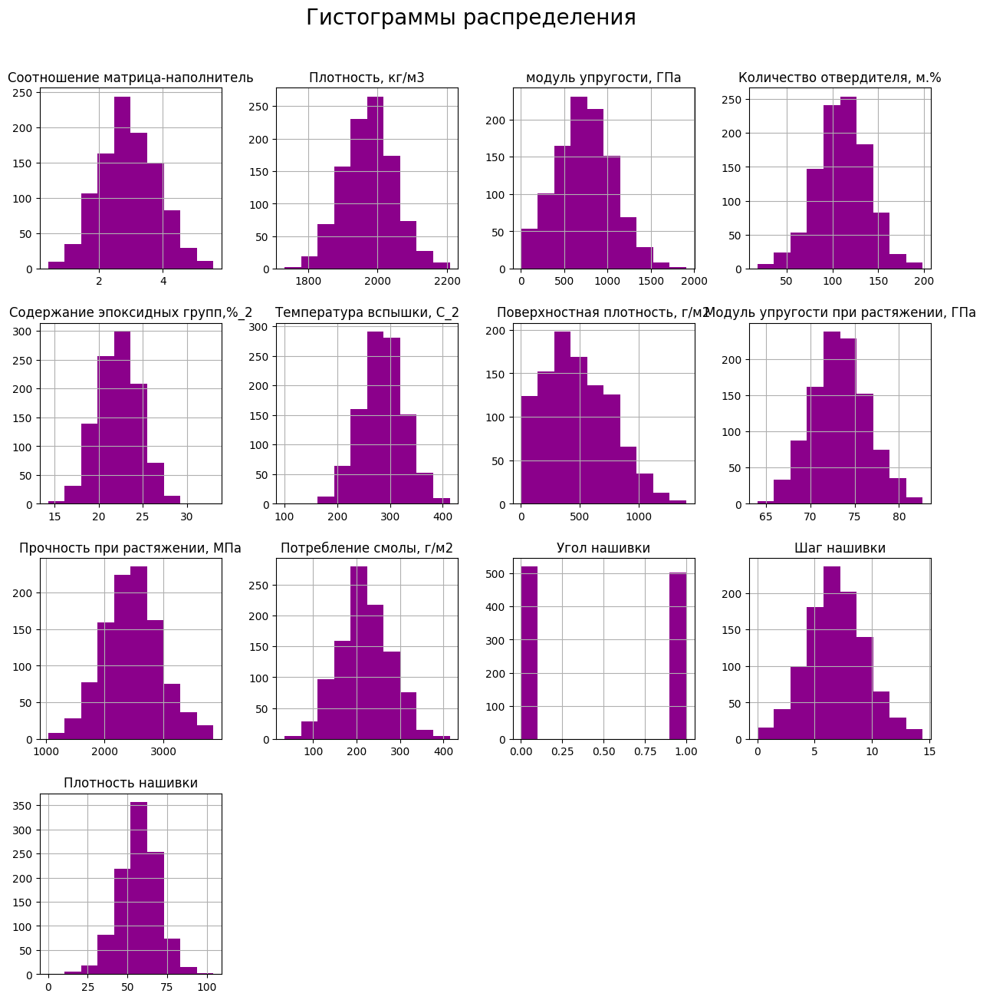

In [ ]:
# Визуализируем исходный (необработанный) датасет
# 1. Гистограммы расределения
df.hist(figsize = (15,15), color = 'darkmagenta')
plt.suptitle('Гистограммы распределения', fontsize=20,  y=0.95)
plt.show()

Гистограмма — это классический инструмент визуализации, который представляет собой распределение одной или нескольких переменных путем подсчета количества наблюдений, попадающих в интервалы разбиения. 

Анализ графиков показывает, что распределения всех параметров (кроме "Угла нашивки" и "Поверхностной плотности, г/м2") стремятся к нормальному. Параметр "Угол нашивки" имеет два значения: 0 и 1, что соответствует величинам 0 и 90 градусов. В дальнейшем целесообразно рассматривать данный признак как категориальный.

Связанный с гистограммой тип графиков — график плотности, который можно назвать непрерывным сглаженным аналогом гистограммы. Самый распространённый вариант построения такого графика — ядерная оценка плотности. В этом методе для каждой точки данных строится непрерывная кривая — ядро. Все эти кривые складываются вместе, чтобы получить единую гладкую оценку плотности. 

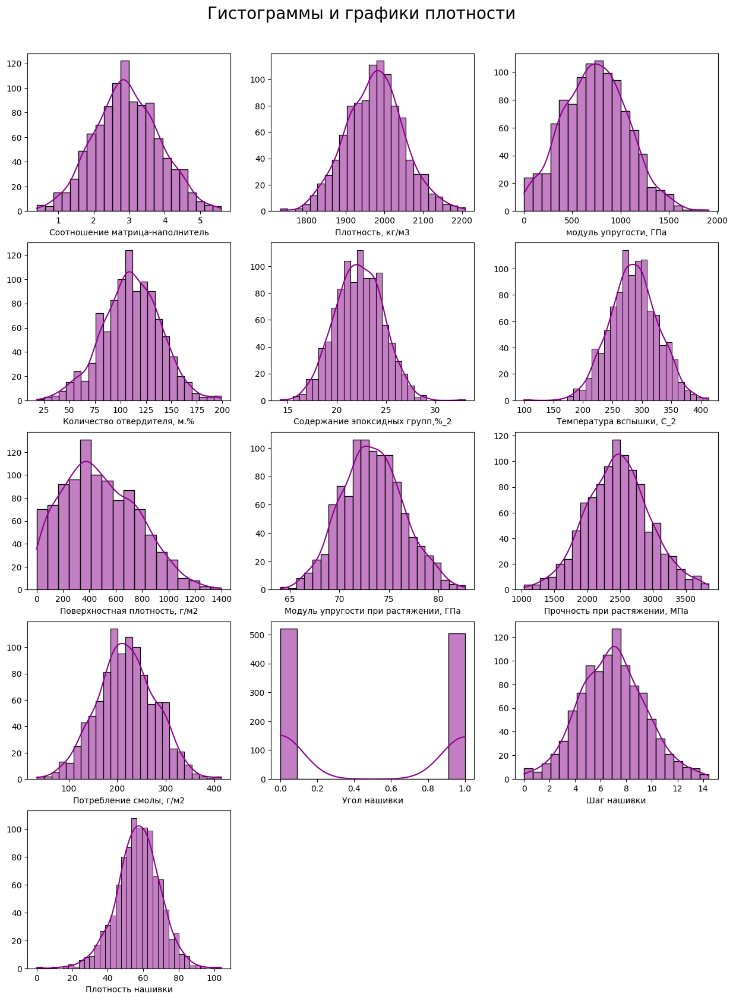

In [ ]:
# 2. Гистограммы и графики плотности
n_subplots = len(df.columns)                        # считаем количество графиков
n_cols = 3                                          # задаем количество столбцов
n_rows = (n_subplots + n_cols - 1) // n_cols        # вычисляем количество строк

plt.figure(figsize=(15,20))
plt.suptitle('Гистограммы и графики плотности', fontsize=20,  y=0.92)
for i, col in enumerate(df.columns, 1):
    plt.subplot(n_rows, n_cols, i)
    sns.histplot(df[col], kde=True, color='darkmagenta') 
    plt.ylabel("")
plt.show()

Графики, приведенные выше, свидетельствуют о том, что распределения всех параметров (кроме "Угла нашивки" и "Поверхностной плотности, г/м2") стремятся к нормальному. Параметр "Угол нашивки" имеет два значения: 0 и 1.

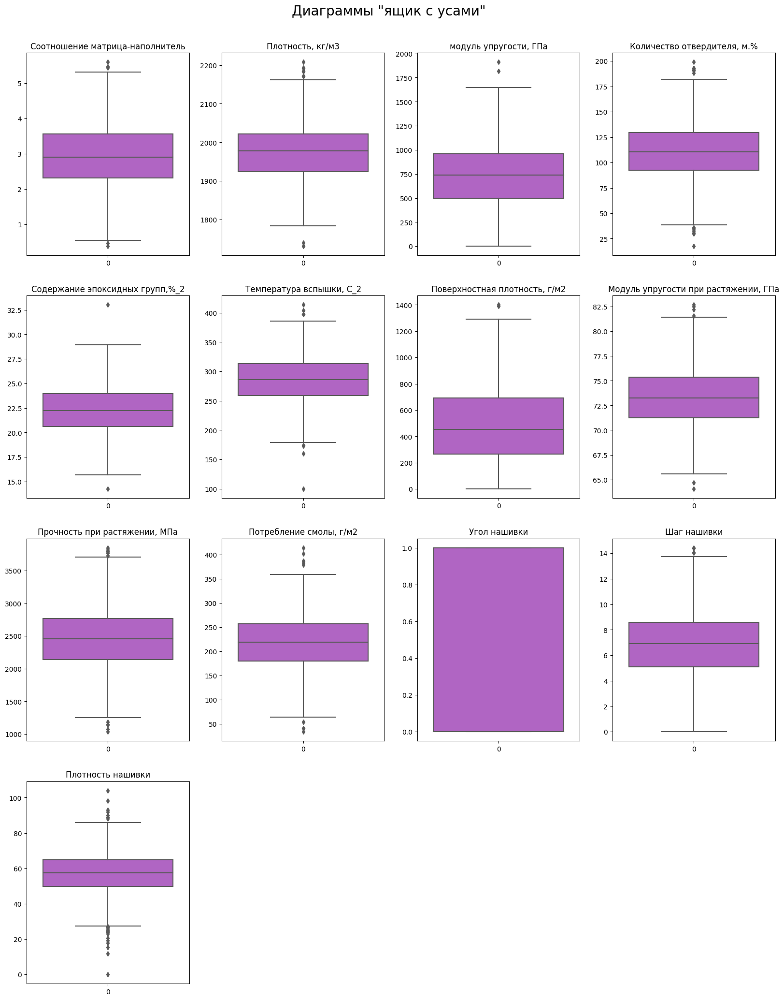

In [ ]:
# 3. Диаграммы "ящик с усами"
n_subplots = len(df.columns)                        # считаем количество графиков
n_cols = 4                                          # задаем количество столбцов
n_rows = (n_subplots + n_cols - 1) // n_cols        # вычисляем количество строк

plt.figure(figsize=(20,25))
plt.suptitle('Диаграммы "ящик с усами"', fontsize=20,  y=0.92)
for i, col in enumerate(df.columns, 1):
    plt.subplot(n_rows, n_cols, i)
    sns.boxplot(data=df[col], color='mediumorchid') 
    plt.title(df[col].name, size=12)
plt.show()

Boxplot - график, использующийся в описательной статистике, компактно изображающий одномерное распределение вероятностей.

Такой вид диаграммы в удобной форме показывает медиану, нижний и верхний квантили, минимальное и максимальное значение выборки и выбросы. 


Выброс (в статистике) — это измерительная точка данных, которая значительно выделяется из общей выборки. Выбросы могут быть вызваны вариативностью измерений или указывать на экспериментальную ошибку; в последнем случае они иногда исключаются из набора данных. Выброс может вызвать серьезные проблемы при статистическом анализе.

В boxplot можно считать нижний и верхний усики как о границы распределения данных. Любые точки данных, которые показывают выше или ниже усов, могут считаться выбросами или аномальными.

Из диаграмм "ящик с усами" видно, что выбросы имеют все характеристики, кроме параметра "Угол нашивки".

Влияние выбросов на модель:

* Данные оказались в искаженном формате.
* Изменяет общее статистическое распределение данных с точки зрения среднего значения, дисперсии и т.д.
* Приводит к искажению уровня точности модели.

Из-за вышеуказанных причин необходимо обнаружить и избавиться от выбросов до моделирования набора данных.

<Figure size 2000x2000 with 0 Axes>

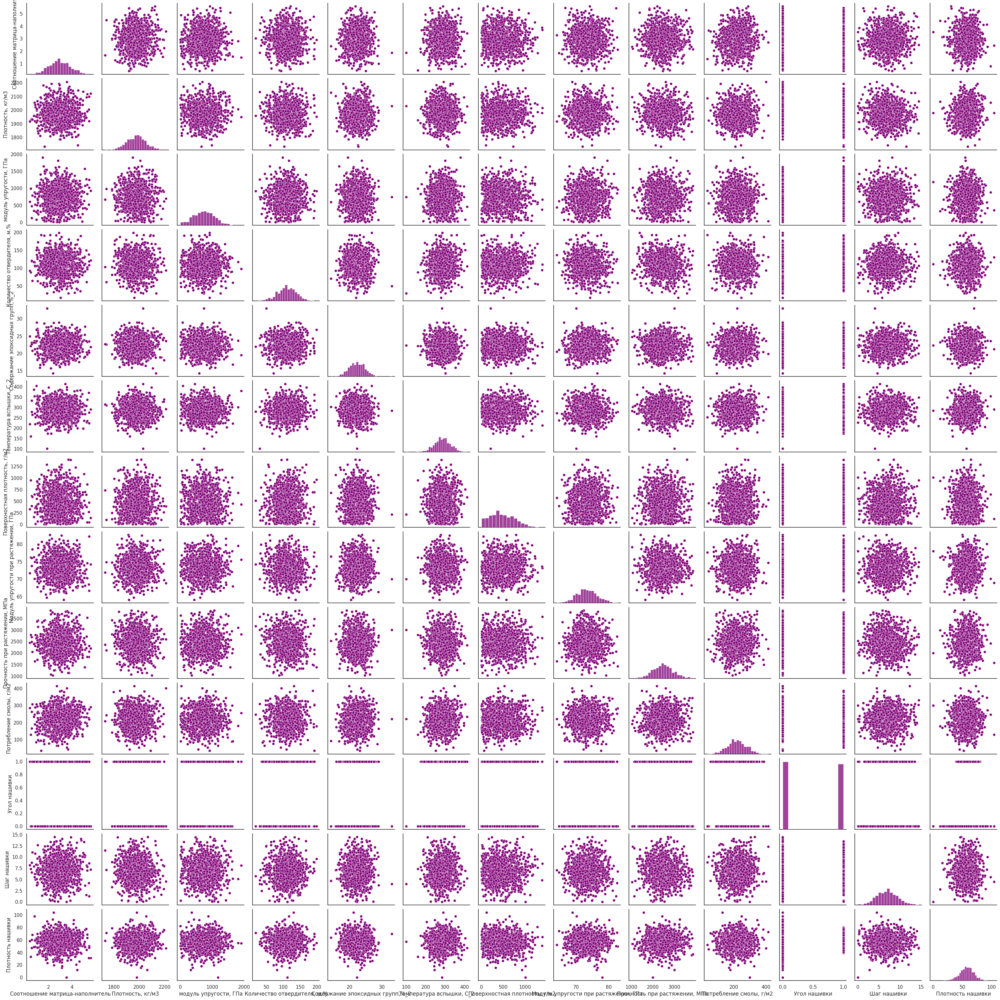

In [ ]:
# 4. Попарные графики рассеяния точек с помощью функции sns.pairplot()
plt.figure(figsize=(20,20))
sns.set(style='white', palette='RdPu_r')
sns.pairplot(df)
plt.show()

<Figure size 2000x2000 with 0 Axes>

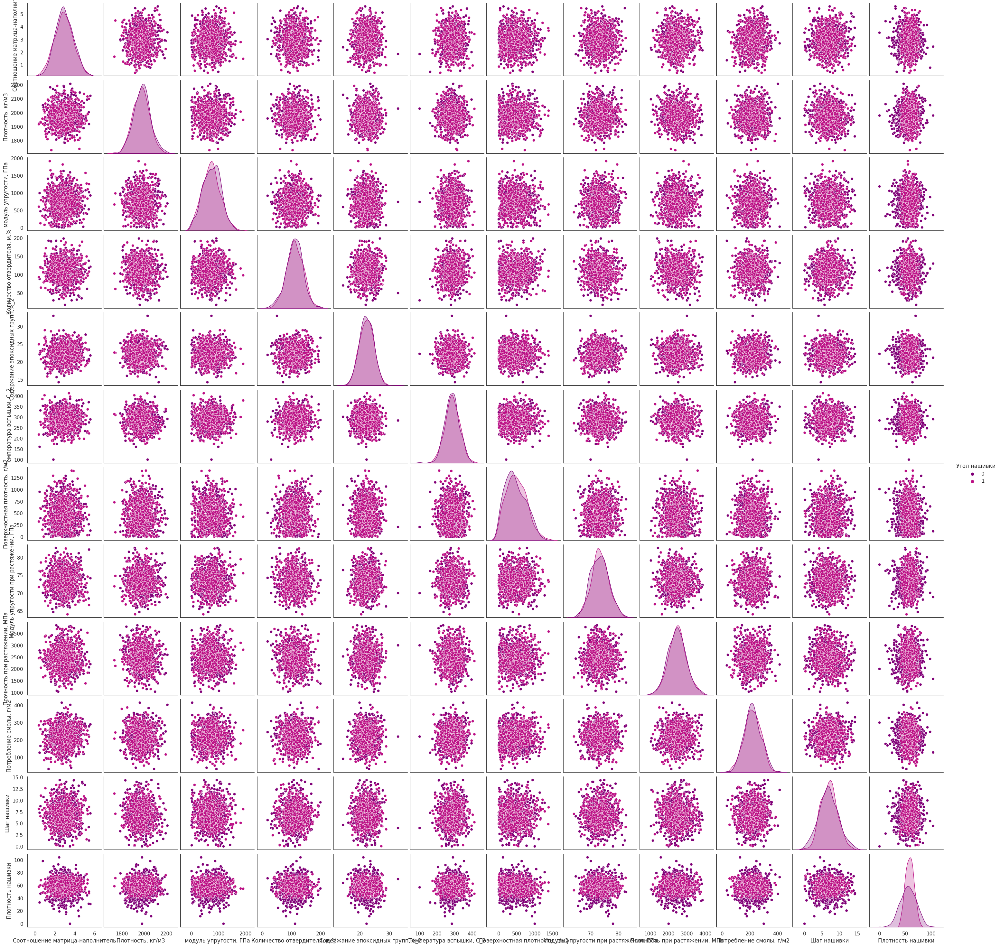

In [46]:
# Попарные графики рассеяния точек с помощью функции sns.pairplot() 
# с учетом кростабуляции для категориального признака "Угол нашивки"
plt.figure(figsize=(20,20))
sns.set(style='white', palette='RdPu_r')
sns.pairplot(df, hue='Угол нашивки')
plt.show()

Матричная диаграмма рассеяния представляет собой все возможные попарные диаграммы рассеяния, представленные в виде большой квадратной матрицы. Диагональные элементы матрицы являются графиками ядерной оценки плотности распределения вероятности каждой из переменных. А остальные элементы — это диаграммы рассеяния переменных относительно друг друга.

Приведенные выше графики свидетельствуют об отсутствии линейной зависимости между характеристиками композитных материалов.

Функция sns.pairplot() является надстройкой (упрощенной версией) другой функции этой библиотеки, sns.PairGrid(). 

<Figure size 2000x2000 with 0 Axes>

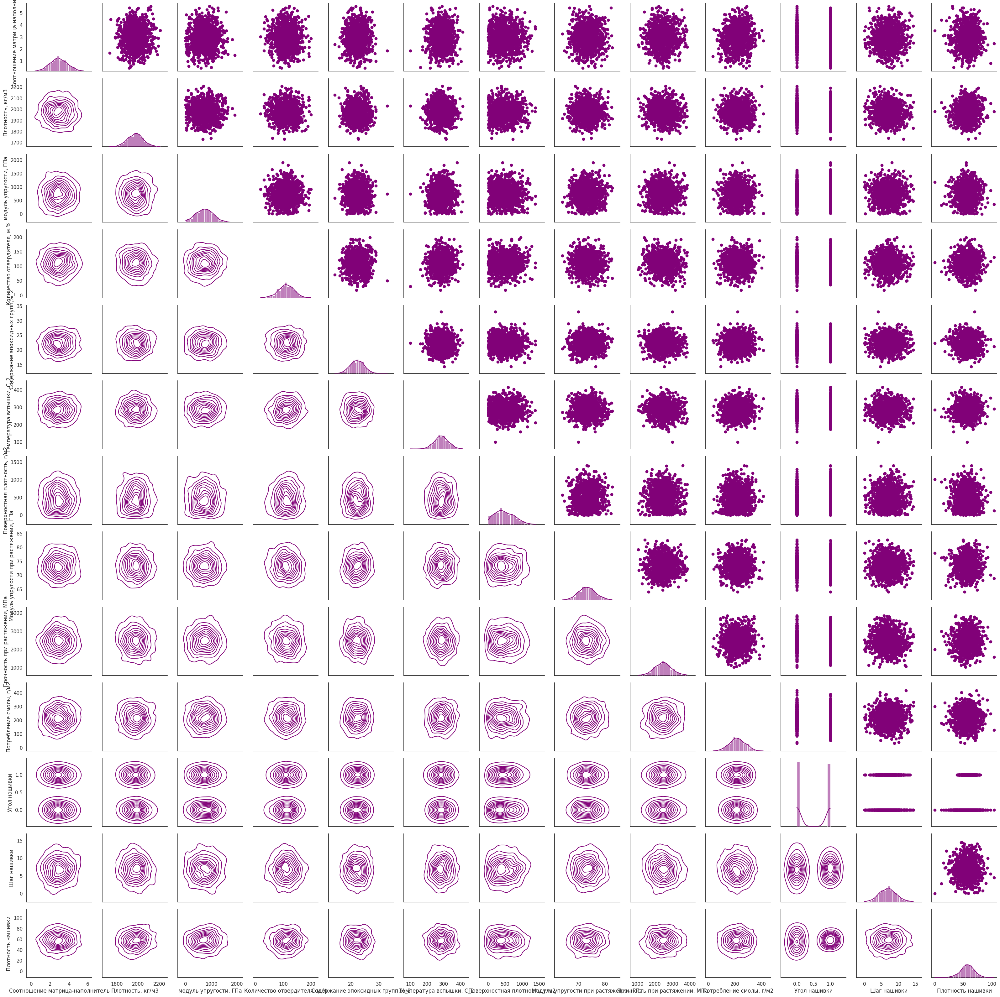

In [47]:
# 5. Попарные графики рассеяния точек с помощью функции sns.pairgrid()
plt.figure(figsize=(20,20))
sns.set(style='white', palette='RdPu_r')

g = sns.PairGrid(df)
g.map_upper(plt.scatter)                   # над диагональю изобразим сами точки
g.map_diag(sns.histplot, kde=True)         # на диагонали расположим одномерные ядерные оценки плотности с гистограммами
g.map_lower(sns.kdeplot)                   # под диагональю - двумерные 
plt.show()

**Вывод: зависимость между параметрами не наблюдается.**

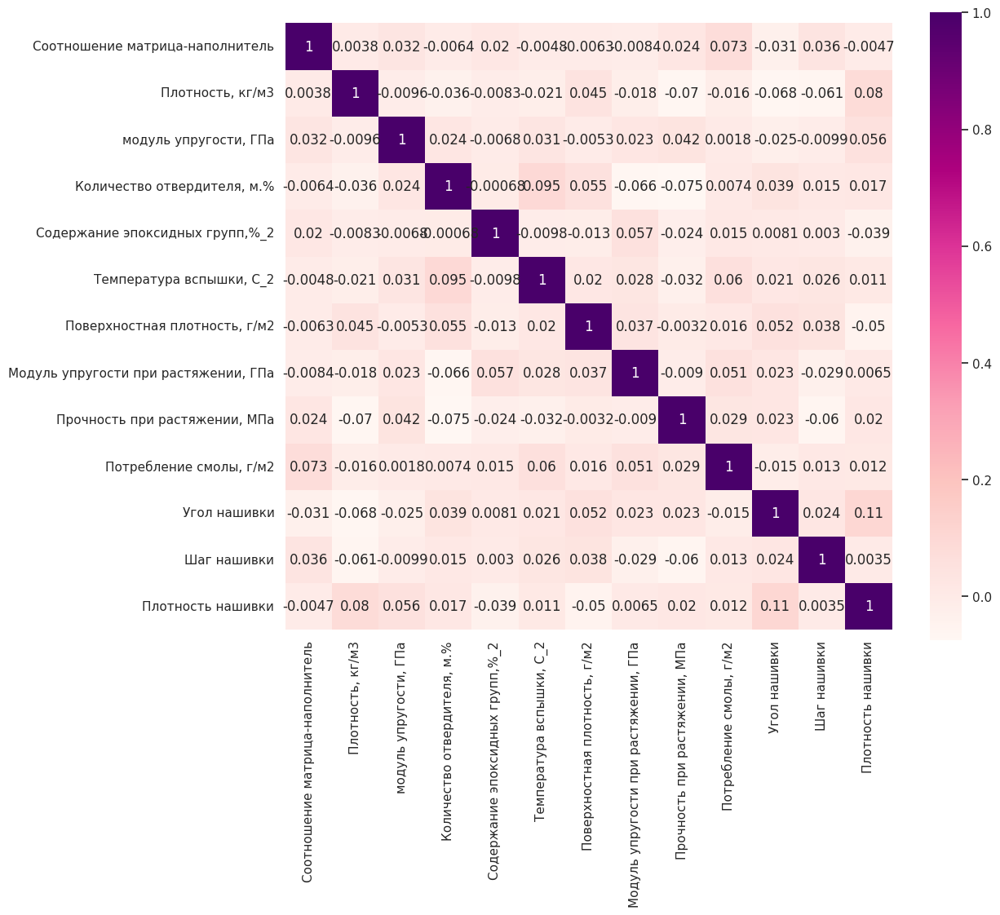

In [48]:
# 6. Визуализируем матрицу корреляции в виде тепловой карты
f, ax = plt.subplots(figsize=(12,10))
sns.heatmap(df.corr(), annot=True, ax=ax, square = True, cmap='RdPu')
plt.show()

**Вывод: зависимость между всеми параметрами крайне слабая. 
Наибольшая корреляция наблюдается между "Плотностью нашивки" и "Углом нашивки" и равняется 0,11.**

### **_Продублируем анализ данных с помощью бибилиотек профайлинга.**

In [49]:
import os
! pip install -U ydata-profiling[notebook,unicode]

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 345.9/345.9 kB 22.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 102.7/102.7 kB 13.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.5/78.5 kB 9.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 679.8/679.8 kB 50.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.8/11.8 MB 101.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 33.8/33.8 MB 19.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 36.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.7/4.7 MB 107.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 91.6 MB/s eta 0:00:00
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27096 sha256=956cdbdcf52d64f8c40199d37a626fe5d24561746f2cb5b

In [50]:
from ydata_profiling import ProfileReport

In [51]:
profile_bp = ProfileReport(dataset_bp, title="Profiling Report bp")
profile_nup = ProfileReport(dataset_nup, title="Profiling Report nup")

print(f'------------ bp i-frame ------------')
profile_bp.to_notebook_iframe()
print(f'------------ nup i-frame ------------')
profile_nup.to_notebook_iframe()

------------ bp i-frame ------------


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

------------ nup i-frame ------------


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## _ 04.  Предобработка данных.

### _ 04.1. Работа с выбросами.

Произведем поиск и удаление выбросов в данных. 

Для поиска выбросов воспользуемся двумя методами:
* 1) Стандартное отклонение (правило трех сигм)
* 2) Метод межквартильного диапазона (IQR - Inter Quartile Range)

Метод 1 - Стандартное отклонение (правило трех сигм): когда данные подчиняются нормальному распределению, 99,7% значений должны находиться в пределах 3 стандартных отклонений от среднего; когда значение превышает это расстояние, это можно считать выбросом.

Для реализации этого метода применяют z-оценку. Z-оценка показывает количество стандартных отклонений данного значения от среднего. Формула для расчета z-показателя:

z = (X - μ) / σ

где:
* X — это одно необработанное значение данных.
* μ - среднее значение 
* σ - стандартное отклонение 

Наблюдение можно идентифицировать как выброс, если его z-оценка меньше -3 или больше 3.
Выбросы = наблюдения с z-показателями > 3 или < -3.

-----------------------------------------------------------------------------------------------------------------

Метод 2 - Метод межквартильного диапазона (IQR - Inter Quartile Range): 

Межквартильный размах (IQR) — это разница между 75-м процентилем и 25-м процентилем в наборе данных. Он измеряет разброс средних 50% значений.

Другими словами, IQR - это первый квартиль (Q1), вычтенный из третьего квартиля (Q3); эти квартили можно четко увидеть на диаграмме "ящик с усами".

IQR = Q3 - Q1

Наблюдение можно рассматривать как выброс, если оно в 1,5 раза превышает межквартильный размах, превышающий третий квартиль (Q3), или в 1,5 раза превышает межквартильный размах, меньше первого квартиля (Q1).

Выбросы = наблюдения > Q3 + 1,5*IQR или Q1 – 1,5*IQR

In [52]:
# 1. Поиск анамалий в признаках
# Метод 1 - Стандартное отклонение (правило трех сигм)
# Для этого для каждого значения всех параметров необходимо получить его z-оценку

# Создадим функцию для поиска выбросов
def detect_outliers_zscore(data):
    outliers = []                          # создаем пустой список, куда будем записывать выбросы
    mean = np.mean(data)                   
    std = np.std(data)                     
    for i in data:
        z_score = (i-mean)/std
        if (np.abs(z_score) > 3):
            outliers.append(i)
    return outliers

sum_of_outliers = 0                        # счетчик количества выбросов
for col in df.columns:
    df_outliers_zscore = detect_outliers_zscore(df[col])
    sum_of_outliers += len(df_outliers_zscore)
    print("Количество выбросов в столбце ", df[col].name, ": ", len(df_outliers_zscore))
print("Всего выбросов при использовании метода трех сигм: ", sum_of_outliers)

Количество выбросов в столбце  Соотношение матрица-наполнитель :  0
Количество выбросов в столбце  Плотность, кг/м3 :  3
Количество выбросов в столбце  модуль упругости, ГПа :  2
Количество выбросов в столбце  Количество отвердителя, м.% :  2
Количество выбросов в столбце  Содержание эпоксидных групп,%_2 :  2
Количество выбросов в столбце  Температура вспышки, С_2 :  3
Количество выбросов в столбце  Поверхностная плотность, г/м2 :  2
Количество выбросов в столбце  Модуль упругости при растяжении, ГПа :  1
Количество выбросов в столбце  Прочность при растяжении, МПа :  0
Количество выбросов в столбце  Потребление смолы, г/м2 :  3
Количество выбросов в столбце  Угол нашивки :  0
Количество выбросов в столбце  Шаг нашивки :  0
Количество выбросов в столбце  Плотность нашивки :  7
Всего выбросов при использовании метода трех сигм:  25


In [53]:
# Метод 2 - Метод межквартильного диапазона (IQR - Inter Quartile Range):
def detect_outliers_IQR(data):
    outliers = []                          # создаем пустой список, куда будем записывать выбросы
    Q1 = data.quantile(0.25)                
    Q3 = data.quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR           # нижняя граница
    upper_bound = Q3 + 1.5 * IQR           # верхняя граница
    for i in data:
        if (i <= lower_bound) | (i >= upper_bound):
            outliers.append(i)
    return outliers

sum_of_outliers = 0                        # счетчик количества выбросов
for col in df.columns:
    df_outliers_IQR = detect_outliers_IQR(df[col])
    sum_of_outliers += len(df_outliers_IQR)
    print("Количество выбросов в столбце ", df[col].name, ": ", len(df_outliers_IQR))
print("Всего выбросов при использовании метода межквартильного диапазона: ", sum_of_outliers)

Количество выбросов в столбце  Соотношение матрица-наполнитель :  6
Количество выбросов в столбце  Плотность, кг/м3 :  9
Количество выбросов в столбце  модуль упругости, ГПа :  2
Количество выбросов в столбце  Количество отвердителя, м.% :  14
Количество выбросов в столбце  Содержание эпоксидных групп,%_2 :  2
Количество выбросов в столбце  Температура вспышки, С_2 :  8
Количество выбросов в столбце  Поверхностная плотность, г/м2 :  2
Количество выбросов в столбце  Модуль упругости при растяжении, ГПа :  6
Количество выбросов в столбце  Прочность при растяжении, МПа :  11
Количество выбросов в столбце  Потребление смолы, г/м2 :  8
Количество выбросов в столбце  Угол нашивки :  0
Количество выбросов в столбце  Шаг нашивки :  4
Количество выбросов в столбце  Плотность нашивки :  21
Всего выбросов при использовании метода межквартильного диапазона:  93


При использовании метода трех сигм было выявлено 25 выбросов, при использовании метода межквартильного диапазона - 93 выброса.

Подход к поиску выбросов в интервале между квартилями является наиболее часто используемым и наиболее надежным подходом, применяемым в области исследований.

Для дальнейшей работы с выбросами воспользуемся результатами второго метода.

In [54]:
# 2. Работа с выбросами
# 2.1. Удалим выбросы, используя метод межквартильного диапазона

# Созадим копию дататсета для дальнейшей работы
df_clean = df.copy()

# Создадим пустой список для индексов пропусков, которые необходимо удалить
idx_outlier_list = []

for col in df_clean.columns:
    # Находим выбросы
    df_outliers_IQR = detect_outliers_IQR(df_clean[col])
    # Находим индексы элементов, которые отнесли к выбросам
    idx_outlier = np.where(df_clean[col].isin(df_outliers_IQR))[0] 
    # Заполняем список индексов
    idx_outlier_list.extend(idx_outlier)

# Удаляем выбросы из датасета исходя из их индексов    
df_clean = df_clean.drop(idx_outlier_list) 

# Обновим индексы датасета
df_clean.reset_index(drop=True, inplace=True)

# Посмотрим размерность очищенного датасета
df_clean.shape

(936, 13)

In [55]:
# Проверим остались ли в очищенном датасете выбросы
sum_of_outliers_2 = 0                       
for col in df_clean.columns:
    df_outliers_IQR = detect_outliers_IQR(df_clean[col])
    sum_of_outliers_2 += len(df_outliers_IQR)
    print("Количество выбросов в столбце ", df_clean[col].name, ": ", len(df_outliers_IQR))
print("Всего выбросов при использовании метода межквартильного диапазона: ", sum_of_outliers_2)

Количество выбросов в столбце  Соотношение матрица-наполнитель :  0
Количество выбросов в столбце  Плотность, кг/м3 :  0
Количество выбросов в столбце  модуль упругости, ГПа :  1
Количество выбросов в столбце  Количество отвердителя, м.% :  0
Количество выбросов в столбце  Содержание эпоксидных групп,%_2 :  0
Количество выбросов в столбце  Температура вспышки, С_2 :  0
Количество выбросов в столбце  Поверхностная плотность, г/м2 :  0
Количество выбросов в столбце  Модуль упругости при растяжении, ГПа :  1
Количество выбросов в столбце  Прочность при растяжении, МПа :  4
Количество выбросов в столбце  Потребление смолы, г/м2 :  1
Количество выбросов в столбце  Угол нашивки :  0
Количество выбросов в столбце  Шаг нашивки :  0
Количество выбросов в столбце  Плотность нашивки :  3
Всего выбросов при использовании метода межквартильного диапазона:  10


In [56]:
# 2.2. Повторно удалим выбросы, т.к. в данных присутствуют 10 выбросов

# Создадим пустой список для индексов пропусков, которые необходимо удалить
idx_outlier_list_2 = []

for col in df_clean.columns:
    # Находим выбросы
    df_outliers_IQR = detect_outliers_IQR(df_clean[col])
    # Находим индексы элементов, которые отнесли к выбросам
    idx_outlier = np.where(df_clean[col].isin(df_outliers_IQR))[0] 
    # Заполняем список индексов
    idx_outlier_list_2.extend(idx_outlier)

# Удаляем выбросы из датасета исходя из их индексов    
df_clean = df_clean.drop(idx_outlier_list_2) 

# Обновим индексы датасета
df_clean.reset_index(drop=True, inplace=True)

# Посмотрим размерность очищенного датасета
df_clean.shape

(926, 13)

In [57]:
# Проверим остались ли в очищенном датасете выбросы
sum_of_outliers_3 = 0                        
for col in df_clean.columns:
    df_outliers_IQR = detect_outliers_IQR(df_clean[col])
    sum_of_outliers_3 += len(df_outliers_IQR)
    print("Количество выбросов в столбце ", df_clean[col].name, ": ", len(df_outliers_IQR))
print("Всего выбросов при использовании метода межквартильного диапазона: ", sum_of_outliers_3)

Количество выбросов в столбце  Соотношение матрица-наполнитель :  0
Количество выбросов в столбце  Плотность, кг/м3 :  0
Количество выбросов в столбце  модуль упругости, ГПа :  0
Количество выбросов в столбце  Количество отвердителя, м.% :  0
Количество выбросов в столбце  Содержание эпоксидных групп,%_2 :  0
Количество выбросов в столбце  Температура вспышки, С_2 :  0
Количество выбросов в столбце  Поверхностная плотность, г/м2 :  0
Количество выбросов в столбце  Модуль упругости при растяжении, ГПа :  0
Количество выбросов в столбце  Прочность при растяжении, МПа :  2
Количество выбросов в столбце  Потребление смолы, г/м2 :  1
Количество выбросов в столбце  Угол нашивки :  0
Количество выбросов в столбце  Шаг нашивки :  0
Количество выбросов в столбце  Плотность нашивки :  1
Всего выбросов при использовании метода межквартильного диапазона:  4


In [58]:
# 2.3. Еще раз удалим выбросы,  т.к. в данных все еще присутствует 4 выброса

# Создадим пустой список для индексов пропусков, которые необходимо удалить
idx_outlier_list_3 = []

for col in df_clean.columns:
    # Находим выбросы
    df_outliers_IQR = detect_outliers_IQR(df_clean[col])
    # Находим индексы элементов, которые отнесли к выбросам
    idx_outlier = np.where(df_clean[col].isin(df_outliers_IQR))[0] 
    # Заполняем список индексов
    idx_outlier_list_3.extend(idx_outlier)

# Удаляем выбросы из датасета исходя из их индексов    
df_clean = df_clean.drop(idx_outlier_list_3) 

# Обновим индексы датасета
df_clean.reset_index(drop=True, inplace=True)

# Посмотрим размерность очищенного датасета
df_clean.shape

(922, 13)

In [59]:
sum_of_outliers_4 = 0                        
for col in df_clean.columns:
    df_outliers_IQR = detect_outliers_IQR(df_clean[col])
    sum_of_outliers_4 += len(df_outliers_IQR)
    print("Количество выбросов в столбце ", df_clean[col].name, ": ", len(df_outliers_IQR))
print("Всего выбросов при использовании метода межквартильного диапазона: ", sum_of_outliers_4)

Количество выбросов в столбце  Соотношение матрица-наполнитель :  0
Количество выбросов в столбце  Плотность, кг/м3 :  0
Количество выбросов в столбце  модуль упругости, ГПа :  0
Количество выбросов в столбце  Количество отвердителя, м.% :  0
Количество выбросов в столбце  Содержание эпоксидных групп,%_2 :  0
Количество выбросов в столбце  Температура вспышки, С_2 :  0
Количество выбросов в столбце  Поверхностная плотность, г/м2 :  0
Количество выбросов в столбце  Модуль упругости при растяжении, ГПа :  0
Количество выбросов в столбце  Прочность при растяжении, МПа :  0
Количество выбросов в столбце  Потребление смолы, г/м2 :  0
Количество выбросов в столбце  Угол нашивки :  0
Количество выбросов в столбце  Шаг нашивки :  0
Количество выбросов в столбце  Плотность нашивки :  0
Всего выбросов при использовании метода межквартильного диапазона:  0


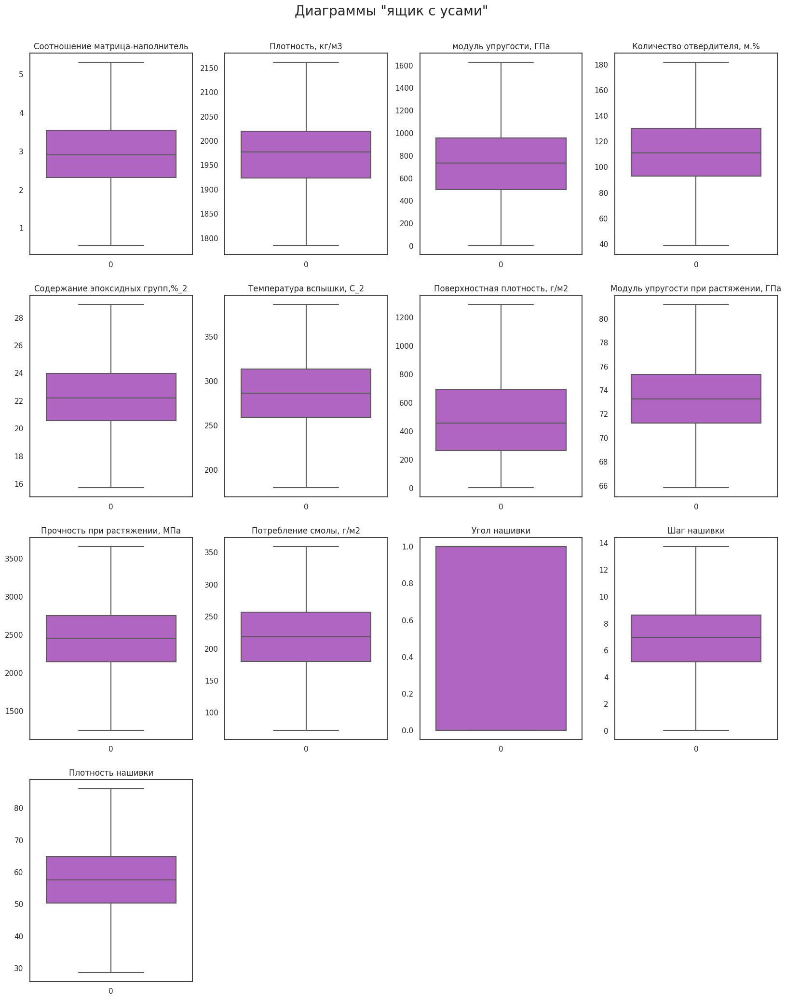

In [60]:
# Визуализируем очищенный датасет с помощью диаграмм "ящик с усами"
n_subplots = len(df_clean.columns)                        # считаем количество графиков
n_cols = 4                                                # задаем количество столбцов
n_rows = (n_subplots + n_cols - 1) // n_cols              # вычисляем количество строк

plt.figure(figsize=(20,25))
plt.suptitle('Диаграммы "ящик с усами"', fontsize=20,  y=0.92)
for i, col in enumerate(df_clean.columns, 1):
    plt.subplot(n_rows, n_cols, i)
    sns.boxplot(data=df_clean[col], color='mediumorchid') 
    plt.title(df_clean[col].name, size=12)
plt.show()

Вывод: выбросы из данных удалены после трех этапов очистки.

### _ 04.2. Нормализация и стандартизация данных.

Многие алгоритмы машинного обучения построены на предположении о Гауссовом (нормальном) распределении входных данных. Поэтому для качественной работы таких моделей, обязательна проверка данных на нормальность, а при необходимости - приведение их к распределению, близкому к нормальному.

Кроме того, в данном датасете присутствуют численные признаки разных масштабов, поэтому необходимо отмасштабировать признаки.

Нормализация - процедура предобработки входной информации (обучающих, тестовых и валидационных выборок, а также реальных данных), при которой значения признаков во входном векторе приводятся к некоторому заданному диапазону, например, [0...1] или [-1...1].

Ключевая цель нормализации - приведение данных в самых разных единицах измерения и диапазонных значениях к единому виду, который позволит сравнить данные между собой и использовать для расчета схожести объектов в выборке. До начала обучения модели необходимо привести все признаки к равному влиянию друг на друга. В Python-библиотеке Scikit-learn есть для этого классы MinMaxScaler и RobustScaler.

Проверку на нормальность можно проводить несколькими способами:

* построение гистограммы признака
* построение QQ-графика
* проведение теста на нормальность

Стандартизация - приведения данных к определенному формату и представлению, которые обеспечивают их корректное применение в многомерном анализе. Стандартизация позволяет устранить возможное влияние отклонений по каждому признаку и приводит все исходные значения в датасете к набору значений к нормальному распределению с математическим ожиданием равным 0 и стандартным отклонением равным 1. В результате получается стандартизированная шкала, которая определяет место каждого значения в наборе данных и измеряет его отклонение от среднего в единицах стандартного отклонения.

Недостатком стандартизации является возможность присутствия в этих шкалах отрицательных значений, что может привести к потере логики анализа данных. Отрицательные значения могут исключаться путем дополнительных преобразований.

Для стандартизации данных в Scikit-learn есть класс StandardScaler, который применяет к каждому из атрибутов следующее: вычитает из значений среднее и делит полученную разность на стандартное отклонение. 

Проанализируем данные, полученные после удаления выбросов. 

In [61]:
# Посмотрим статистические характеристики датасета после удаления выбросов
df_clean.describe()

,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2",Угол нашивки,Шаг нашивки,Плотность нашивки
count,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000
mean,2.927964,1974.118744,736.119982,111.136066,22.200570,286.181128,482.429070,73.303464,2461.491315,218.048059,0.510846,6.931939,57.562887
std,0.895472,71.040648,327.607008,26.753228,2.393926,39.420764,280.437329,3.025864,453.564734,57.137475,0.500154,2.514184,11.122204
min,0.547391,1784.482245,2.436909,38.668500,15.695894,179.374391,0.603740,65.793845,1250.392802,72.530873,0.000000,0.037639,28.661632
25%,2.320191,1923.318006,498.538615,92.856591,20.556328,259.205321,264.345872,71.241213,2148.175736,179.875097,0.000000,5.143644,50.275385
50%,2.907832,1977.321002,736.178435,111.162090,22.177681,286.220763,457.732246,73.247594,2455.974462,218.697660,1.000000,6.972862,57.584225
75%,3.549367,2020.053266,956.955626,130.109815,23.956980,313.012786,695.531920,75.310130,2751.233766,256.623860,1.000000,8.612094,64.840898
max,5.314144,2161.565216,1628.000000,181.828448,28.955094,386.067992,1291.340115,81.203147,3654.434359,359.052220,1.000000,13.732404,86.012427


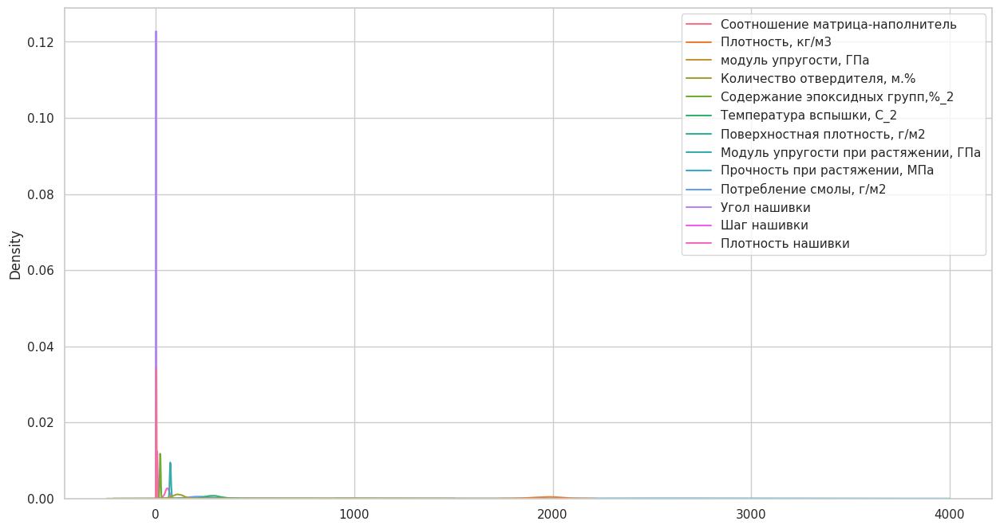

In [62]:
# Построим графики распределения всех параметров
plt.figure(figsize=(15,8))
sns.set(context='notebook', style='whitegrid')
sns.kdeplot(data=df_clean)
plt.show()

**Графики выше показывает, что численные признаки датасета разных масштабов.**

In [63]:
# Выведем отдельно средние и медианы по столбцам и проанализируем эти значения
mean_median = pd.DataFrame({'Среднее': df_clean.mean(axis=0),
                            'Медиана': df_clean.median(axis=0),
                            'Разница м/у средним и медианой': df_clean.mean(axis=0) - df_clean.median(axis=0),
                            'Разница м/у средним и медианой, %': ((df_clean.mean(axis=0) - df_clean.median(axis=0)) / df_clean.median(axis=0)) * 100})
mean_median

,Среднее,Медиана,Разница м/у средним и медианой,"Разница м/у средним и медианой, %"
Соотношение матрица-наполнитель,2.927964,2.907832,0.020132,0.692327
"Плотность, кг/м3",1974.118744,1977.321002,-3.202258,-0.161949
"модуль упругости, ГПа",736.119982,736.178435,-0.058453,-0.007940
"Количество отвердителя, м.%",111.136066,111.162090,-0.026024,-0.023411
"Содержание эпоксидных групп,%_2",22.200570,22.177681,0.022889,0.103207
"Температура вспышки, С_2",286.181128,286.220763,-0.039636,-0.013848
"Поверхностная плотность, г/м2",482.429070,457.732246,24.696824,5.395474
"Модуль упругости при растяжении, ГПа",73.303464,73.247594,0.055870,0.076276
"Прочность при растяжении, МПа",2461.491315,2455.974462,5.516853,0.224630
"Потребление смолы, г/м2",218.048059,218.697660,-0.649600,-0.297031


Медиана и среднее в очищенной выборке откличатся не существенно, кроме столбцов "Поверхностная плотность, г/м2" и "Угол нашивки".

#### **_ 04.2.1. Проверка на нормальность.**



**1. Тест Шапиро-Уилка на нормальность**

Тест Шапиро-Уилка используется для определения того, соответствует ли выборка нормальному распределению .

Функция scipy.stats.shapiro() возвращает тестовую статистику и соответствующее p-значение.

Если p-значение ниже определенного уровня значимости (0,05), то у нас есть достаточно доказательств, чтобы сказать, что данные выборки не получены из нормального распределения.

In [64]:
# Проведем тест Шапиро-Уилка на нормальность
for col in df_clean.columns:
    print(df_clean[col].name, shapiro(df_clean[col]))

Соотношение матрица-наполнитель ShapiroResult(statistic=0.9971880316734314, pvalue=0.10904344916343689)
Плотность, кг/м3 ShapiroResult(statistic=0.997011661529541, pvalue=0.08352091163396835)
модуль упругости, ГПа ShapiroResult(statistic=0.995254397392273, pvalue=0.0058130305260419846)
Количество отвердителя, м.% ShapiroResult(statistic=0.9966756105422974, pvalue=0.05000615119934082)
Содержание эпоксидных групп,%_2 ShapiroResult(statistic=0.9977133870124817, pvalue=0.23541033267974854)
Температура вспышки, С_2 ShapiroResult(statistic=0.9971266984939575, pvalue=0.09941922873258591)
Поверхностная плотность, г/м2 ShapiroResult(statistic=0.9776217937469482, pvalue=1.0688074730813568e-10)
Модуль упругости при растяжении, ГПа ShapiroResult(statistic=0.9955782890319824, pvalue=0.009416559711098671)
Прочность при растяжении, МПа ShapiroResult(statistic=0.9973730444908142, pvalue=0.14375117421150208)
Потребление смолы, г/м2 ShapiroResult(statistic=0.9955164790153503, pvalue=0.008584197610616684

В данном случае нулевая гипотеза отвергается (p-value < 0.05) в случаях:
 - модуль упругости, ГПа
 - Поверхностная плотность, г/м2
 - Модуль упругости при растяжении, ГПа
 - Потребление смолы, г/м2 
 - Угол нашивки
 
что подразумевает, что распределения НЕ является нормальными. 

Однако, проверка нормальности статистическими тестами является очень строгой, т.к. идет сравнение с идеальным распределением. Поэтому несмотря на то, что статистический тест говорит о ненормальности распределения, стоит посмотреть на гистограмму распределения.

**2. Гистограммы признаков до стандартизации/нормализации.**

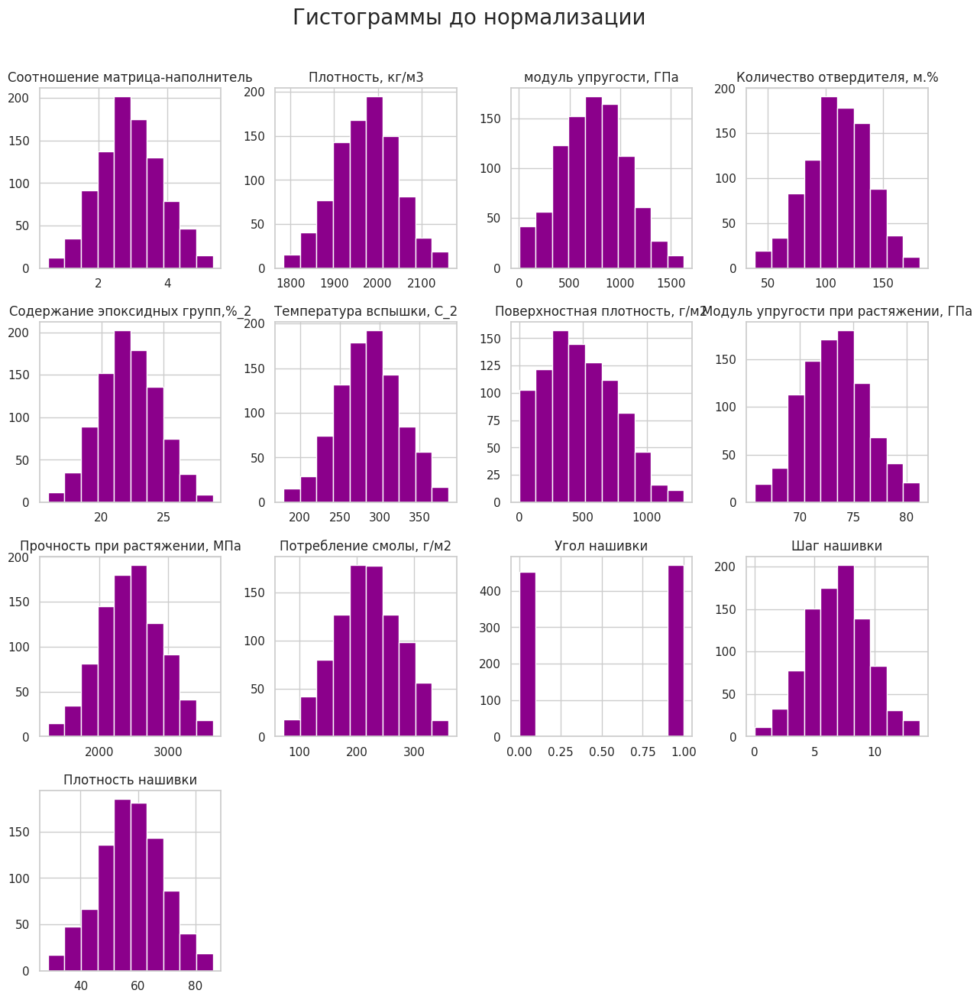

In [65]:
# Построим гистограммы расределения до нормализации
df_clean.hist(figsize = (15,15), color = 'darkmagenta')
plt.suptitle('Гистограммы до нормализации', fontsize=20,  y=0.95)
plt.show()

Анализ графиков показывает, что распределения всех параметров (кроме "Угла нашивки" и "Поверхностной плотности, г/м2") стремятся к нормальному. Параметр "Угол нашивки" имеет два значения: 0 и 1, что соответствует величинам 0 и 90 градусов. 

**3. QQ-графики.**

График QQ, сокращение от графика «квантиль-квантиль», используется для оценки того, потенциально ли набор данных получен из некоторого теоретического распределения.

В большинстве случаев этот тип графика используется для определения того, соответствует ли набор данных нормальному распределению.

Если данные распределены нормально, точки на графике QQ будут лежать на прямой диагональной линии.

И наоборот, чем больше точки на графике значительно отклоняются от прямой диагональной линии, тем менее вероятно, что набор данных следует нормальному распределению.

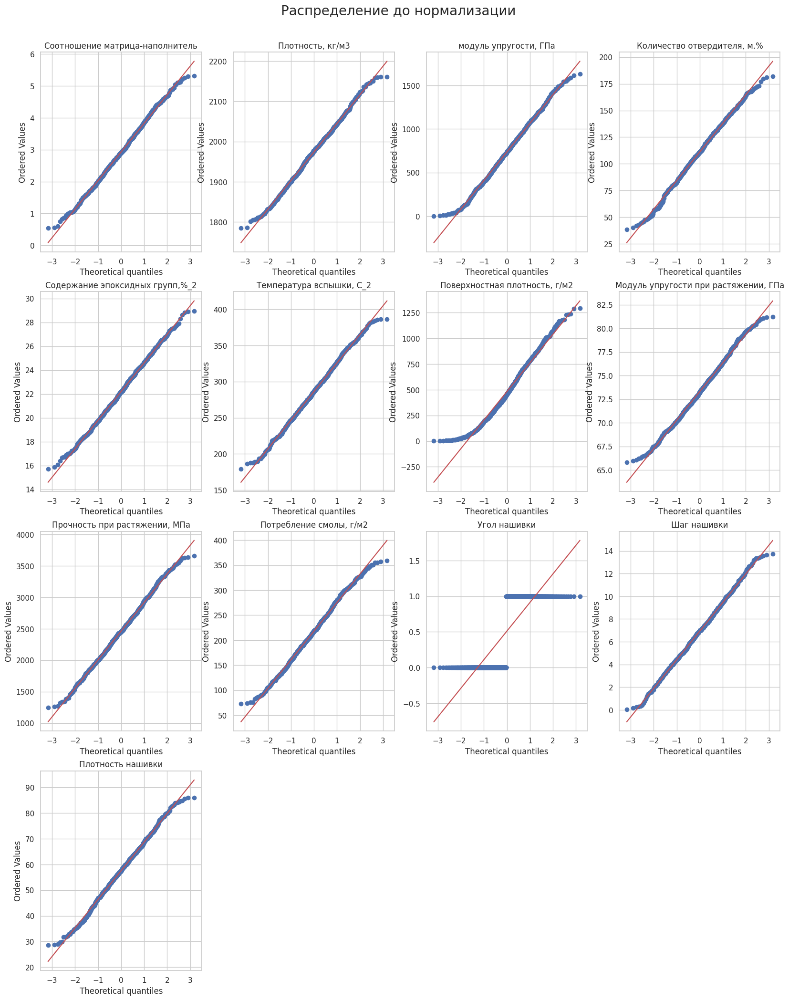

In [66]:
# Построим QQ-графики до нормализации
n_subplots = len(df_clean.columns)                        # считаем количество графиков
n_cols = 4                                                # задаем количество столбцов
n_rows = (n_subplots + n_cols - 1) // n_cols              # вычисляем количество строк

plt.figure(figsize=(20,25))
plt.suptitle('Распределение до нормализации', fontsize=20,  y=0.92)
for i, col in enumerate(df_clean.columns, 1):
    plt.subplot(n_rows, n_cols, i)
    stats.probplot(df_clean[col], dist='norm', plot=plt)
    plt.title(df_clean[col].name, size=12)
plt.show()

Из графиков видно, что большинство данных близки к нормальному распределению, которое на данном графике представляет красная линия.

#### **_ 04.2.2. Нормализация данных.**

##### **_04.2.2.1. MinMaxScaler.**

Из каждого значения признака, MinMaxScaler вычитает минимальное значение признака и делит на диапазон. Диапазон это разница между минимумом и максимумом этого признака.

MinMaxScaler сохраняет форму исходного распределения. Он не меняет содержательно информацию содержащуюся в исходных данных.

ледует обратить внимание, что MinMaxScaler не снижает важность выбросов.

Диапазон по умолчанию для признака после MinMaxScaler находится между 0 и 1.

In [67]:
# 1.1. MinMaxScaler()
# Выполним масштабирование признаков, чтобы все значения находились в определенном интервале.
# Для масштабирования воспользуемся функцией MinMaxScaler(), по умолчанию - (0,1).
minmax_scl = MinMaxScaler()                                                             # создаем minmax_scl
dataset_norm_minmax = minmax_scl.fit_transform(np.array(df_clean[df_clean.columns]))    # обучаем minmax_scl
df_norm_minmax = pd.DataFrame(data = dataset_norm_minmax, columns = df_clean.columns)   # преобразуем обратно в dataframe
df_norm_minmax.describe()                                                               # выводим описательную статистику

,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2",Угол нашивки,Шаг нашивки,Плотность нашивки
count,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000
mean,0.499412,0.502904,0.451341,0.506200,0.490578,0.516739,0.373295,0.487343,0.503776,0.507876,0.510846,0.503426,0.503938
std,0.187858,0.188395,0.201534,0.186876,0.180548,0.190721,0.217269,0.196366,0.188668,0.199418,0.500154,0.183587,0.193933
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.371909,0.368184,0.305188,0.378514,0.366571,0.386228,0.204335,0.353512,0.373447,0.374647,0.000000,0.372844,0.376869
50%,0.495189,0.511396,0.451377,0.506382,0.488852,0.516931,0.354161,0.483718,0.501481,0.510143,1.000000,0.506414,0.504310
75%,0.629774,0.624719,0.587193,0.638735,0.623046,0.646553,0.538397,0.617568,0.624299,0.642511,1.000000,0.626112,0.630842
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


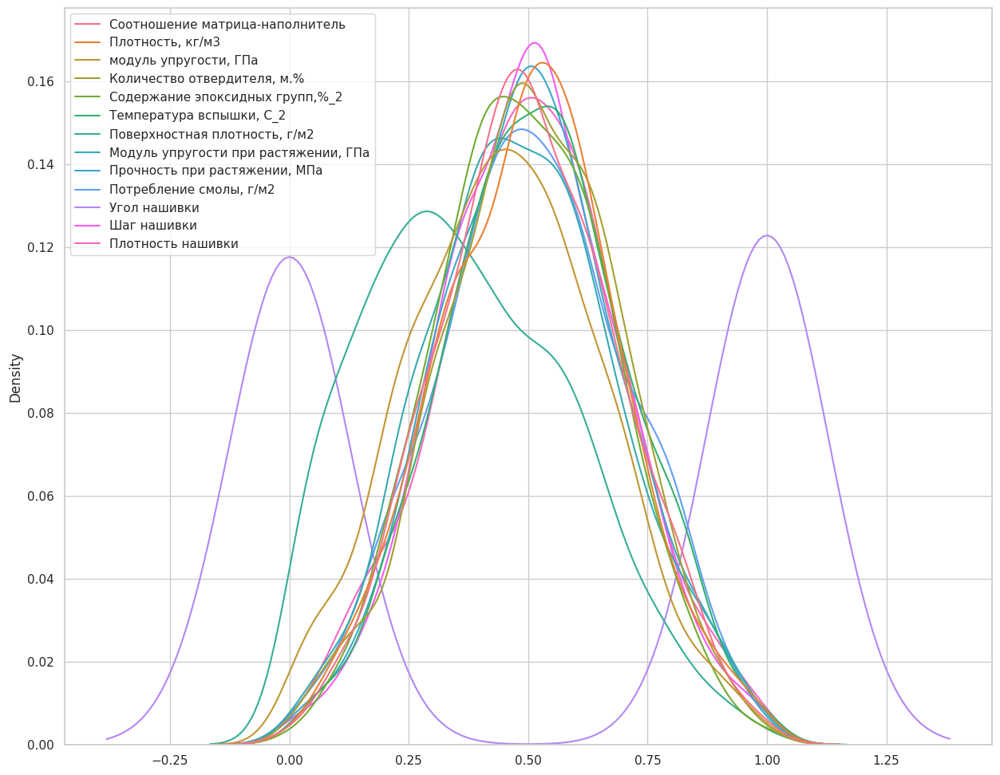

In [68]:
# Визуализируем полученный результат
plt.figure(figsize=(15,12))
sns.set(context='notebook', style='whitegrid')
sns.kdeplot(data=df_norm_minmax)
plt.show()

Все параметры имеют одинаковый относительный масштаб. Относительные пробелы между значениями каждого объекта были сохранены.
Максимальное значение признака равно 1, минимальное - 0.

In [69]:
# Для создания приложения для прогнозирования характеристик композитных материалов создадим масштабаторы
minmax_scl_x = MinMaxScaler()
minmax_scl_y = MinMaxScaler()  

# Зададим x и y для нейронной сети
X = df_clean.drop(['Соотношение матрица-наполнитель'], axis = 1)
y = df_clean[['Соотношение матрица-наполнитель']]

# Обучим масштабаторы для x и y
minmax_scl_x.fit(X.values)
minmax_scl_y.fit(y.values)

# Сохраним масштабаторы 
dump(minmax_scl_x, 'minmax_scl_x.pkl')
dump(minmax_scl_y, 'minmax_scl_y.pkl')

['minmax_scl_y.pkl']

In [70]:
a = df_clean.drop(['Соотношение матрица-наполнитель'], axis = 1)
a.shape

(922, 12)

##### **_ 04.2.2.2. RobustScaler.**
RobustScaler преобразует вектор признака, вычитая медиану и деля на межквартильный размах (75% значение — 25% значение).
RobustScaler следует использовать для уменьшения эффекта от выбросов по сравнению с MinMaxScaler.

Заметим, что диапазон для каждого признака после применения RobustScaler больше, чем он был для MinMaxScaler.

In [71]:
# 1.2. RobustScaler()
# Cтандартизация признака, однако преобразование происходит с помощью перцентилей, тем самым снижается эффект выбросов
robust_scl = RobustScaler()                                                               # создаем robust_scl
dataset_norm_robust = robust_scl.fit_transform(np.array(df_clean[df_clean.columns]))      # обучаем robust_scl
df_norm_robust = pd.DataFrame(data = dataset_norm_robust, columns = df_clean.columns)     # преобразуем обратно в dataframe
df_norm_robust.describe()                                                                 # выводим описательную статистику

,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2",Угол нашивки,Шаг нашивки,Плотность нашивки
count,922.000000,922.000000,9.220000e+02,922.000000,9.220000e+02,922.000000,922.000000,922.000000,9.220000e+02,9.220000e+02,922.000000,922.000000,9.220000e+02
mean,0.016378,-0.033103,-1.275099e-04,-0.000699,6.730776e-03,-0.000737,0.057276,0.013731,9.148130e-03,-8.463985e-03,-0.489154,-0.011799,-1.464983e-03
std,0.728514,0.734382,7.146485e-01,0.718145,7.039609e-01,0.732626,0.650386,0.743654,7.521079e-01,7.444742e-01,0.500154,0.724872,7.635986e-01
min,-1.920345,-1.993469,-1.600598e+00,-1.945968,-1.906042e+00,-1.985717,-1.060165,-1.831876,-1.999114e+00,-1.904484e+00,-1.000000,-1.999517,-1.985690e+00
25%,-0.478077,-0.558256,-5.183922e-01,-0.491380,-4.767770e-01,-0.502076,-0.448499,-0.493100,-5.103965e-01,-5.058396e-01,-1.000000,-0.527388,-5.017908e-01
50%,0.000000,0.000000,1.240327e-16,0.000000,-5.223686e-16,0.000000,0.000000,0.000000,-3.770855e-16,1.851817e-16,0.000000,0.000000,-2.439455e-16
75%,0.521923,0.441744,4.816078e-01,0.508620,5.232230e-01,0.497924,0.551501,0.506900,4.896035e-01,4.941604e-01,0.000000,0.472612,4.982092e-01
max,1.957663,1.904623,1.945437e+00,1.896919,1.992975e+00,1.855639,1.933290,1.955202,1.987304e+00,1.828753e+00,0.000000,1.948866,1.951747e+00


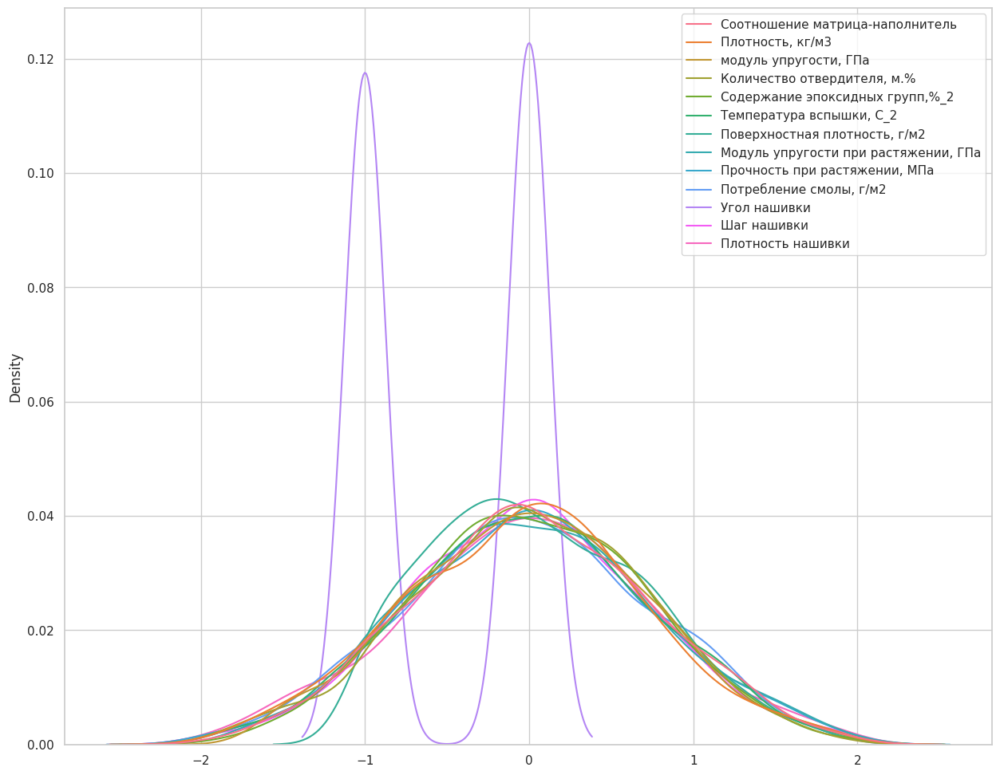

In [72]:
# Визуализируем полученный результат
plt.figure(figsize=(15,12))
sns.set(context='notebook', style='whitegrid')
sns.kdeplot(data=df_norm_robust)
plt.show()

После использования RobustScaler() данные приняли отрицательные значения. 
Средние значения находятся в районе 0.
Максимальное значение параметров находится в районе 2, минимальное - в районе -2.

#### **_ 04.2.3. Стандартизация данных.**

##### **_ 04.2.3.1. StandardScaler.**
StandardScaler стандартизирует функцию путем вычитания среднего значения, а затем масштабирования до дисперсии единиц. Единица отклонения означает деление всех значений на стандартное отклонение.

StandardScaler приводит к распределению со стандартным отклонением равным 1 и среднем значением распределения  равным 0. 

In [73]:
# 1.3. StandardScaler()
# Выполним стандартизацию признаков (вычитание среднего и масштабирование дисперсией)
# Воспользуемся функцией StandardScaler()
std_scl = StandardScaler()                                                              # создаем std_scl
dataset_norm_std = std_scl.fit_transform(np.array(df_clean[df_clean.columns]))          # обучаем std_scl
df_norm_std = pd.DataFrame(data = dataset_norm_std, columns = df_clean.columns)         # преобразуем обратно в dataframe
df_norm_std.describe()                                                                  # выводим описательную статистику

,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2",Угол нашивки,Шаг нашивки,Плотность нашивки
count,9.220000e+02,9.220000e+02,9.220000e+02,9.220000e+02,9.220000e+02,9.220000e+02,9.220000e+02,9.220000e+02,9.220000e+02,9.220000e+02,922.000000,9.220000e+02,9.220000e+02
mean,-5.779903e-17,-1.741677e-15,2.080765e-16,2.600956e-16,1.040383e-16,-3.467942e-17,2.504625e-17,-4.009326e-15,-7.668005e-16,-2.350494e-16,0.000000,-1.396810e-16,-1.055796e-15
std,1.000543e+00,1.000543e+00,1.000543e+00,1.000543e+00,1.000543e+00,1.000543e+00,1.000543e+00,1.000543e+00,1.000543e+00,1.000543e+00,1.000543,1.000543e+00,1.000543e+00
min,-2.659900e+00,-2.670857e+00,-2.240737e+00,-2.710211e+00,-2.718633e+00,-2.710874e+00,-1.719054e+00,-2.483157e+00,-2.671627e+00,-2.548173e+00,-1.021932,-2.743651e+00,-2.599929e+00
25%,-6.790861e-01,-7.154821e-01,-7.255959e-01,-6.836332e-01,-6.872118e-01,-6.846759e-01,-7.780760e-01,-6.819110e-01,-6.911596e-01,-6.684524e-01,-1.021932,-7.116685e-01,-6.555766e-01
50%,-2.249388e-02,4.510088e-02,1.785201e-04,9.732731e-04,-9.566481e-03,1.005999e-03,-8.811319e-02,-1.847416e-02,-1.216992e-02,1.137525e-02,0.978538,1.628558e-02,1.919567e-03
75%,6.943159e-01,6.469458e-01,6.744529e-01,7.095984e-01,7.340927e-01,6.810173e-01,7.603072e-01,6.635309e-01,6.391584e-01,6.755065e-01,0.978538,6.686332e-01,6.547228e-01
max,2.666164e+00,2.640013e+00,2.723886e+00,2.643821e+00,2.823057e+00,2.535239e+00,2.886028e+00,2.612136e+00,2.631577e+00,2.469145e+00,0.978538,2.706308e+00,2.559293e+00


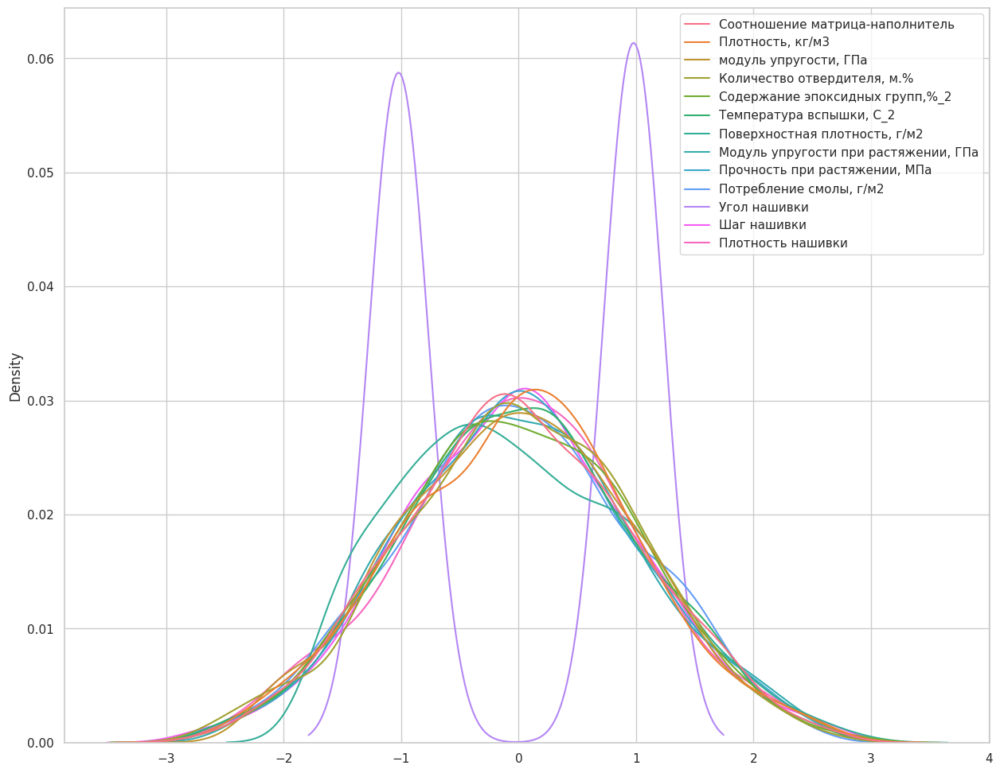

In [74]:
# Визуализируем полученный результат
plt.figure(figsize=(15,12))
sns.set(context='notebook', style='whitegrid')
sns.kdeplot(data=df_norm_std)
plt.show()

На графике выше видно, что у всех распределений среднее равно нулю и единичная дисперсия. 
Максимальное значение параметров находится в районе 3, минимальное -  в районе -3.

Алгоритмы глубокого обучения часто требуют нулевого среднего и единичной дисперсии. Регрессионные алгоритмы также выигрывают от нормально распределенных данных с небольшими размерами выборки.

##### **_ 04.2.3.3. Normalizer.**

Normalizer работает на строках, а не на столбцах. 

По умолчанию, к каждому наблюдению применяется L2 нормализация, так чтобы значения в строке имели единичную норму. Единичная норма в L2 значит, что если мы возведем в квадрат каждый элемент и просуммируем их, в результате получим 1. В качестве альтернативы L2 можно использовать, L1 (манхеттенскую) нормализацию.

In [75]:
# 1.4. Преобразование с помощью Normalizer()
normalize = Normalizer()                                                                            # создаем normalize
dataset_norm_normalizer = normalize.fit_transform(np.array(df_norm_minmax[df_norm_minmax.columns])) # обучаем normalize
df_norm_normalizer = pd.DataFrame(data = dataset_norm_normalizer, columns = df_norm_minmax.columns) # преобразуем обратно в dataframe
df_norm_normalizer.describe()                                                                       # выводим описательную статистику

,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2",Угол нашивки,Шаг нашивки,Плотность нашивки
count,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000
mean,0.257826,0.260766,0.232659,0.261797,0.253591,0.266653,0.191569,0.251385,0.260907,0.261720,0.248030,0.260017,0.259149
std,0.094072,0.097385,0.102114,0.095110,0.092344,0.095951,0.109361,0.098591,0.097229,0.100080,0.244429,0.093712,0.098338
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.195775,0.191248,0.163413,0.197690,0.190283,0.200663,0.108216,0.181112,0.196715,0.195002,0.000000,0.201442,0.192792
50%,0.259166,0.260873,0.231372,0.263703,0.252287,0.265188,0.184998,0.251656,0.259117,0.263073,0.414600,0.259017,0.259595
75%,0.325115,0.328747,0.305227,0.331158,0.316076,0.332639,0.271430,0.318993,0.329162,0.328578,0.482933,0.318151,0.322414
max,0.564813,0.522069,0.522787,0.543068,0.531648,0.507854,0.552173,0.550966,0.590885,0.576162,0.658865,0.567565,0.592974


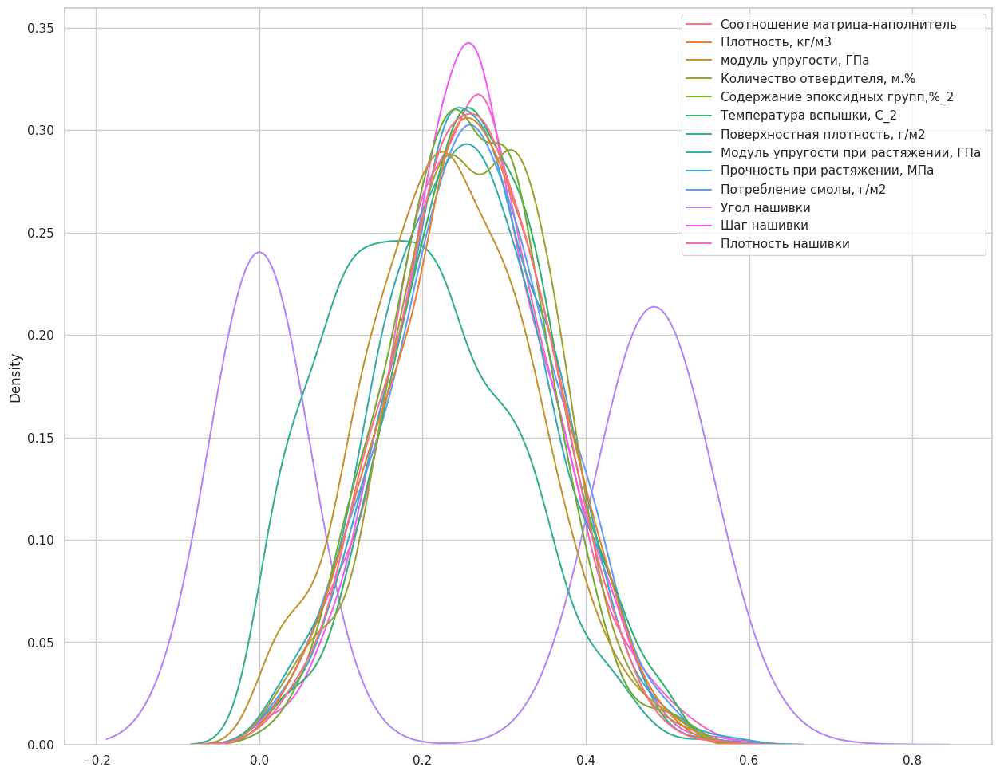

In [76]:
# Визуализируем полученный результат
plt.figure(figsize=(15,12))
sns.set(context='notebook', style='whitegrid')
sns.kdeplot(data=df_norm_normalizer)
plt.show()

Все значения теперь находятся в диапазоне от 0 до 1.

##### **_ 04.2.3.4. PowerTransformer.**

Преобразование удаляет сдвиг из распределения данных, чтобы сделать распределение более нормальным (гауссовским).

Популярными примерами являются лог-преобразование (положительные значения) или обобщенные версии, такие как преобразование Бокса-Кокса (положительные значения) или преобразование Йео-Джонсона (положительные и отрицательные значения).

In [77]:
# 1.5. Преобразование Йео-Джонсона из метода PowerTransformer()
yeo = PowerTransformer(method='yeo-johnson', standardize=True)                          # создаем yeo
dataset_norm_yeo = yeo.fit_transform(np.array(df_clean[df_clean.columns]))              # обучаем yeo
df_norm_yeo = pd.DataFrame(data = dataset_norm_yeo, columns = df_clean.columns)         # преобразуем обратно в dataframe
df_norm_yeo.describe()                                                                  # выводим описательную статистику

,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2",Угол нашивки,Шаг нашивки,Плотность нашивки
count,9.220000e+02,9.220000e+02,9.220000e+02,9.220000e+02,9.220000e+02,9.220000e+02,9.220000e+02,9.220000e+02,9.220000e+02,9.220000e+02,922.000000,9.220000e+02,9.220000e+02
mean,-1.175247e-16,-1.525894e-15,-2.581690e-16,-1.811036e-16,2.851419e-16,-7.128547e-17,-4.623922e-17,2.052444e-14,-1.753237e-16,3.111514e-16,0.000000,-1.194513e-16,-1.464242e-16
std,1.000543e+00,1.000543e+00,1.000543e+00,1.000543e+00,1.000543e+00,1.000543e+00,1.000543e+00,1.000543e+00,1.000543e+00,1.000543e+00,1.000543,1.000543e+00,1.000543e+00
min,-2.767889e+00,-2.675708e+00,-2.513112e+00,-2.604888e+00,-2.795257e+00,-2.733083e+00,-2.387515e+00,-2.620347e+00,-2.747470e+00,-2.583828e+00,-1.021932,-2.841821e+00,-2.577907e+00
25%,-6.699407e-01,-7.150902e-01,-6.963250e-01,-6.940707e-01,-6.811185e-01,-6.827710e-01,-6.954159e-01,-6.696717e-01,-6.848027e-01,-6.647379e-01,-1.021932,-7.045494e-01,-6.579290e-01
50%,-8.529465e-03,4.586944e-02,3.534853e-02,-1.335891e-02,1.171888e-03,4.132026e-03,3.559536e-02,5.497152e-03,-1.846912e-03,1.653428e-02,0.978538,2.622876e-02,-1.458918e-03
75%,7.001159e-01,6.473802e-01,6.852768e-01,7.049707e-01,7.386407e-01,6.824725e-01,7.913927e-01,6.774945e-01,6.444365e-01,6.776027e-01,0.978538,6.725164e-01,6.531693e-01
max,2.592976e+00,2.635512e+00,2.549303e+00,2.723799e+00,2.754981e+00,2.519473e+00,2.350242e+00,2.485302e+00,2.577432e+00,2.445652e+00,0.978538,2.653187e+00,2.576665e+00


При нормализации данных в методе PowerTransformer() был задан параметр стандартизации (standartize=True), который привел распределение к стандартному (вычитание среднего и масштабирование дисперсией).

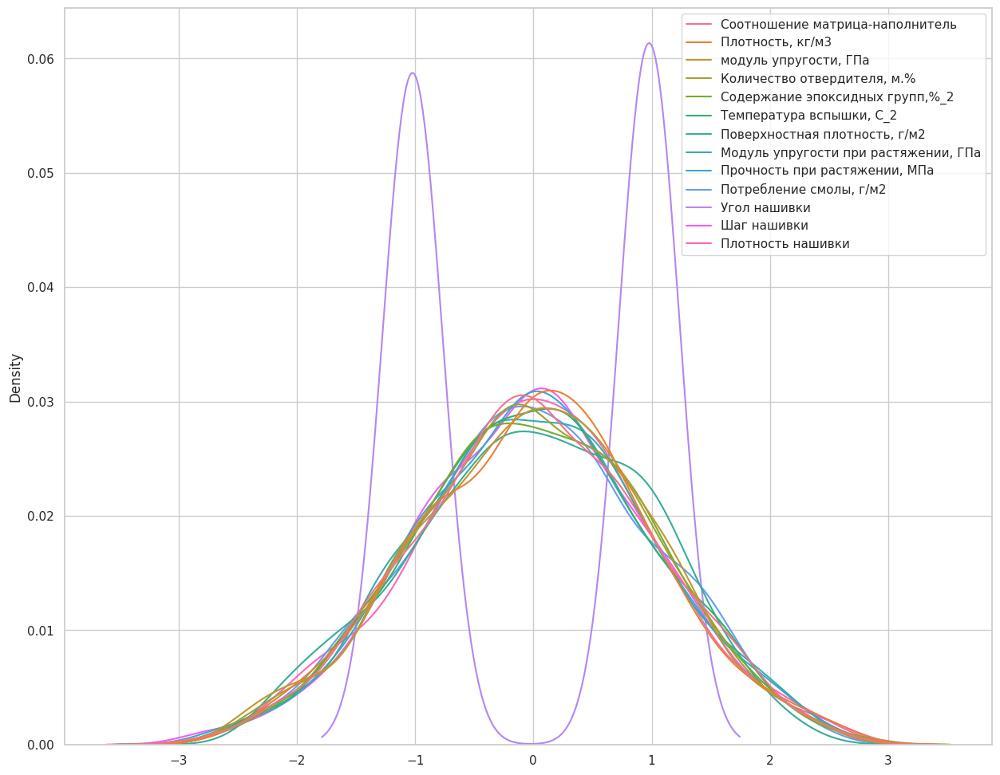

In [78]:
# Визуализируем полученный результат
plt.figure(figsize=(15,12))
sns.set(context='notebook', style='whitegrid')
sns.kdeplot(data=df_norm_yeo)
plt.show()

Средние значения находятся в районе 0. Максимальное значение параметров находится в районе 3, минимальное - в районе -3.

Для дальнейшей работы воспользуемся датастом, отформатированным с помощью функции MinMaxScaler().  

#### **_04.2.4. Проверка на нормальность после нормализации.**

In [79]:
# 1. Тест Шапиро-Уилка на нормальность
for col in df_norm_minmax.columns:
    print(df_norm_minmax[col].name, shapiro(df_norm_minmax[col]))

Соотношение матрица-наполнитель ShapiroResult(statistic=0.9971882104873657, pvalue=0.10907094180583954)
Плотность, кг/м3 ShapiroResult(statistic=0.997011661529541, pvalue=0.08352091163396835)
модуль упругости, ГПа ShapiroResult(statistic=0.9952542185783386, pvalue=0.005811706185340881)
Количество отвердителя, м.% ShapiroResult(statistic=0.9966757893562317, pvalue=0.050019025802612305)
Содержание эпоксидных групп,%_2 ShapiroResult(statistic=0.9977133870124817, pvalue=0.23541033267974854)
Температура вспышки, С_2 ShapiroResult(statistic=0.9971266984939575, pvalue=0.09941922873258591)
Поверхностная плотность, г/м2 ShapiroResult(statistic=0.9776219129562378, pvalue=1.0689168300492824e-10)
Модуль упругости при растяжении, ГПа ShapiroResult(statistic=0.9955782890319824, pvalue=0.009416559711098671)
Прочность при растяжении, МПа ShapiroResult(statistic=0.9973730444908142, pvalue=0.14375117421150208)
Потребление смолы, г/м2 ShapiroResult(statistic=0.995516300201416, pvalue=0.008582196198403835

После стандартизации нулевая гипотеза отвергается (p-value < 0.05) в случаях:

 - модуль упругости, ГПа
 - Поверхностная плотность, г/м2
 - Модуль упругости при растяжении, ГПа
 - Потребление смолы, г/м2
 - Угол нашивки

**что подразумевает, что распределения НЕ являются нормальными.**

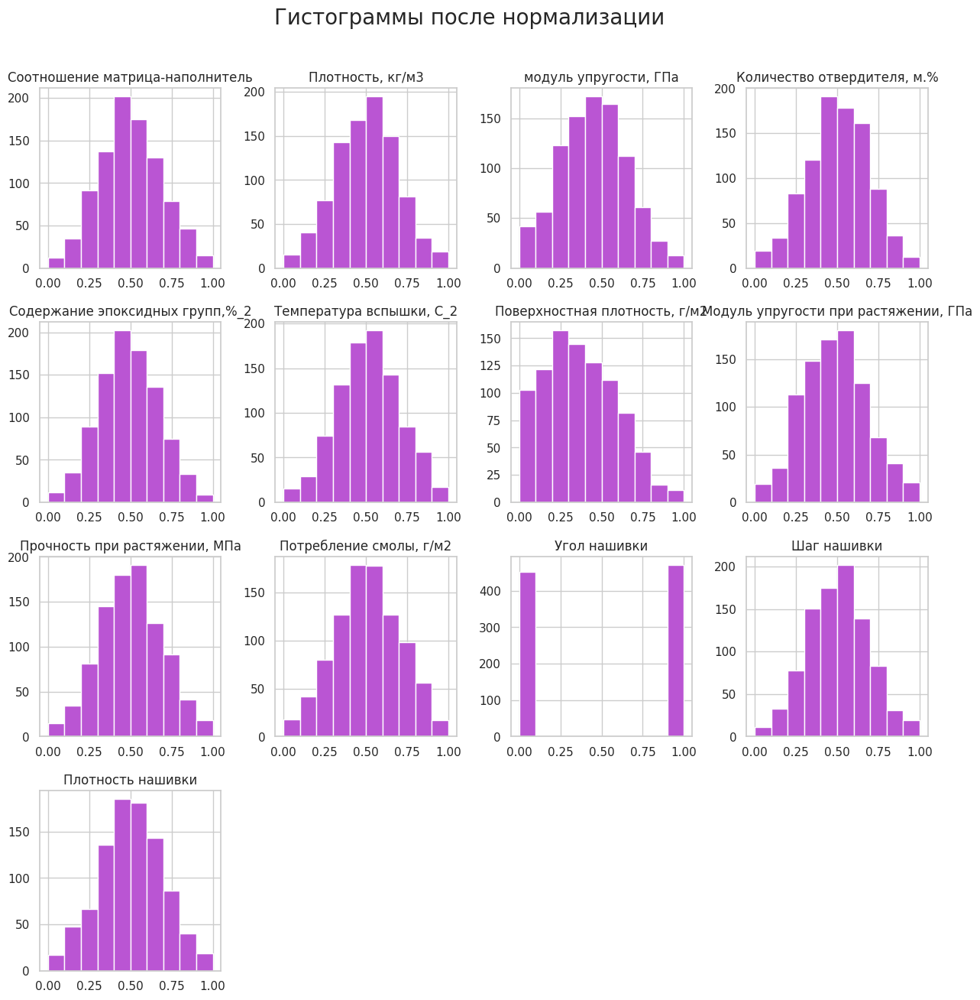

In [80]:
# 2. Гистограммы расределения после нормализации
df_norm_minmax.hist(figsize = (15,15), color = 'mediumorchid')
plt.suptitle('Гистограммы после нормализации', fontsize=20,  y=0.95)
plt.show()

После нормализации изменился диапазон данных: параметры распределены в интервале от -3 до 3. 
Среднее значение равно нулю, дисперсия - 1.
Скорректировались формы графиков распределения, они стали больше похожи на нормальное.

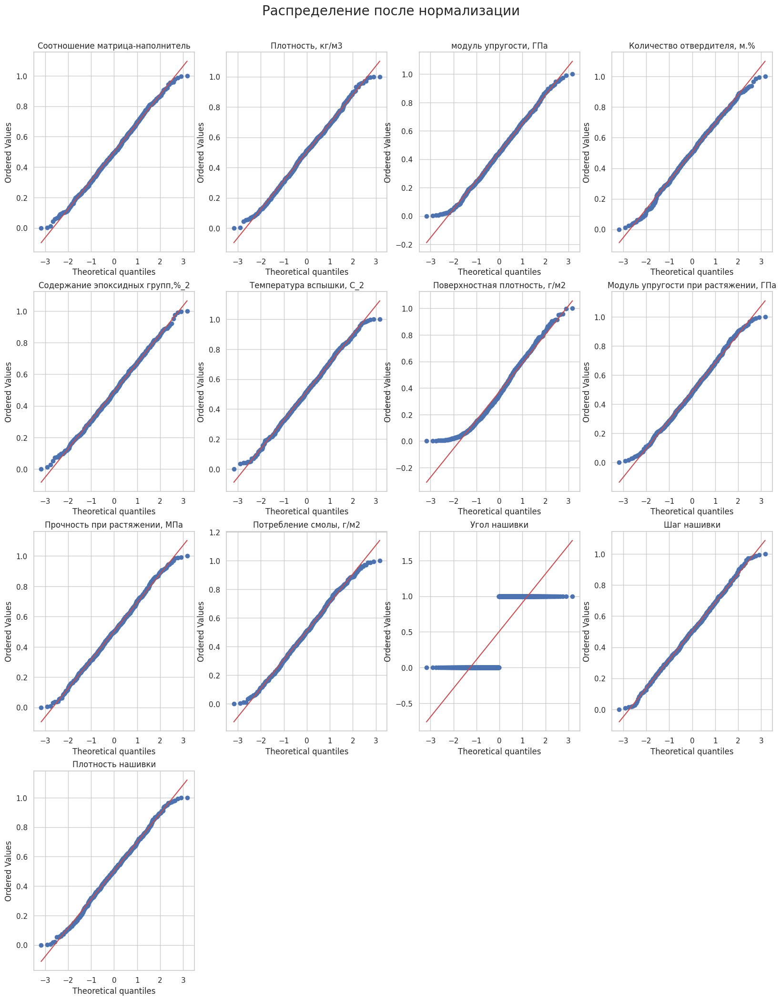

In [81]:
# 3. QQ-графики после нормализации
n_subplots = len(df_norm_minmax.columns)                  # считаем количество графиков
n_cols = 4                                                # задаем количество столбцов
n_rows = (n_subplots + n_cols - 1) // n_cols              # вычисляем количество строк

plt.figure(figsize=(20,25))
plt.suptitle('Распределение после нормализации', fontsize=20,  y=0.92)
for i, col in enumerate(df_norm_minmax.columns, 1):
    plt.subplot(n_rows, n_cols, i)
    stats.probplot(df_norm_minmax[col], dist='norm', plot=plt)
    plt.title(df_norm_minmax[col].name, size=12)
plt.show()

**После нормализации распределение данных значительно не изменилось.**

## _ 05.  Модели для прогноза модуля упругости при растяжении и прочности при растяжении.

В случае прогнозирования модуля упругости при растяжении и прочности при растяжении будет решаться задача регрессии. Задача регрессии – это задача обучения с учителем.

In [82]:
# Создадим копию нормализованного датасета для дальнейшей работы
df_norm = df_norm_minmax.copy()

### _ 05.1. Прогнозирование модуля упругости.

In [83]:
# Разделим датасет на тренировочную и тестовую выборки. 
# При построении модели 30% данных оставим на тестирование модели, на остальных происходит обучение моделей. 
X_train_elastic, X_test_elastic, y_train_elastic, y_test_elastic = train_test_split(
                                                                   df_norm.drop(['Модуль упругости при растяжении, ГПа', 'Прочность при растяжении, МПа'], axis=1), 
                                                                   df_norm[['Модуль упругости при растяжении, ГПа']], 
                                                                   test_size = 0.3, 
                                                                   random_state = 42, 
                                                                   shuffle = True
                                                                   )

In [84]:
# Посмотрим размерность тренировочной и тестовой выборок
print('Размер тренировочного датасета: {}\nРазмер тестового датасета:{}'.format(X_train_elastic.shape, X_test_elastic.shape))

Размер тренировочного датасета: (645, 11)
Размер тестового датасета:(277, 11)


In [85]:
X_train_elastic

,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Потребление смолы, г/м2",Угол нашивки,Шаг нашивки,Плотность нашивки
481,0.266219,0.643037,0.278232,0.234584,0.439240,0.321655,0.495611,0.623998,1.0,0.571430,0.433990
650,0.178334,0.586130,0.463191,0.348338,0.616075,0.320131,0.204285,0.391352,1.0,0.317517,0.537455
483,0.297796,0.532890,0.354250,0.758052,0.625457,0.716345,0.348479,0.237919,1.0,0.554280,0.619605
355,0.590224,0.605695,0.692900,0.360136,0.654481,0.389632,0.456376,0.392215,0.0,0.474980,0.306469
850,0.258455,0.170680,0.502517,0.470569,0.576124,0.477262,0.229392,0.682036,1.0,0.623942,0.429910
...,...,...,...,...,...,...,...,...,...,...,...
106,0.803910,0.303772,0.201130,0.287544,0.329381,0.622672,0.026298,0.576014,0.0,0.549851,0.495193
270,0.577452,0.777923,0.431133,0.526907,0.377453,0.646398,0.841346,0.500515,0.0,0.584309,0.410964
860,0.359950,0.378127,0.731477,0.305836,0.655804,0.372042,0.227940,0.590147,1.0,0.380169,0.529197
435,0.517953,0.781825,0.688797,0.467451,0.715422,0.431429,0.226518,0.329278,0.0,0.050576,0.965176


In [86]:
y_train_elastic

,"Модуль упругости при растяжении, ГПа"
481,0.245292
650,0.966796
483,0.395444
355,0.163582
850,0.467485
...,...
106,0.566234
270,0.294088
860,0.791823
435,0.285892


Рассмотрим работу различных моделей на стандартных параметрах.

In [87]:
# Создадим функцию, которая обрабатывает различные модели, переданные в качестве аргумента, и выдает для них метрики эффективности
# Метрики вычисляются как для тестовых данных, так и для тренировочных данных - тренировочные метрики находятся в ()
def Model_Comparision_Train_Test(AllModels, x_train, y_train, x_test, y_test):
    return_df = pd.DataFrame(columns=['Model', 'R2_score', 'MAE', 'MSE', 'RMSE', 'MAPE'])
    for myModel in AllModels:
        myModel.fit(x_train, y_train)

        # Предсказание и вычисление метрик для тренирвоочного набора данных 
        y_pred_train = myModel.predict(x_train)
        r2_score_train, mae_train, mse_train, rmse_train, mape_train = extract_metrics_from_predicted(y_train, y_pred_train)
        
        # Предсказание и вычисление метрик для тестового набора данных 
        y_pred_test = myModel.predict(x_test)
        r2_score_test, mae_test, mse_test, rmse_test, mape_test = extract_metrics_from_predicted(y_test, y_pred_test)
        
        # Создадим обобщающий датафрейм для всех рассчитанных метрик
        summary = pd.DataFrame([[type(myModel).__name__,
                                         ''.join([str(round(r2_score_test,4)), " (", str(round(r2_score_train,4)), ")"]),
                                         ''.join([str(round(mae_test,2)), " (", str(round(mae_train,2)), ")"]),
                                         ''.join([str(round(mse_test,2)), " (", str(round(mse_train,2)), ")"]),
                                         ''.join([str(round(rmse_test,2)), " (", str(round(rmse_train,2)), ")"]),
                                         ''.join([str(round(mape_test,2)), " (", str(round(mape_train,2)), ")"])]],
                                         columns=['Model', 'R2_score', 'MAE', 'MSE', 'RMSE', 'MAPE'])
        return_df = pd.concat([return_df, summary], axis=0)

    # Установим в качестве индекса столбец с названием модели
    return_df.set_index('Model', inplace=True)
    return(return_df)

# Создадим функцию для расчета метрик
def extract_metrics_from_predicted(y_true, y_pred):
    r2 = r2_score(y_true, y_pred)
    mae = mean_absolute_error(y_true, y_pred)
    mse = mean_squared_error(y_true, y_pred)
    rmse = np.sqrt(mse)
    mape = mean_absolute_percentage_error(y_true, y_pred)
    return (r2, mae, mse, rmse, mape)

In [88]:
# Рассчитаем метрики для следующих моделей:
KNR = KNeighborsRegressor()
SVReg = SVR()
LR = LinearRegression()
DTR = DecisionTreeRegressor()
Abr = AdaBoostRegressor(base_estimator=DecisionTreeRegressor())
Gbr = GradientBoostingRegressor()
XgbR = XGBRegressor()
RFR = RandomForestRegressor() #n_estimators = 20, max_depth = 10, random_state = 42)
SGDR = SGDRegressor()
LassoR = Lasso(alpha=0.1)

Model_Comparision_Train_Test([KNR, SVReg, LR, DTR, Abr, Gbr, XgbR, RFR, SGDR, LassoR], X_train_elastic, np.ravel(y_train_elastic), X_test_elastic, np.ravel(y_test_elastic))

,R2_score,MAE,MSE,RMSE,MAPE
Model,,,,,
KNeighborsRegressor,-0.1435 (0.197),0.18 (0.14),0.05 (0.03),0.22 (0.17),0.65 (2088968184903.12)
SVR,-0.2554 (0.4649),0.18 (0.11),0.05 (0.02),0.23 (0.14),0.66 (1409875462373.38)
LinearRegression,-0.0245 (0.0172),0.17 (0.15),0.04 (0.04),0.21 (0.19),0.65 (3530183592566.66)
DecisionTreeRegressor,-0.8662 (1.0),0.23 (0.0),0.08 (0.0),0.28 (0.0),0.76 (0.0)
AdaBoostRegressor,-0.136 (0.9999),0.18 (0.0),0.05 (0.0),0.22 (0.0),0.69 (0.0)
GradientBoostingRegressor,-0.1161 (0.4548),0.17 (0.11),0.05 (0.02),0.22 (0.14),0.68 (1828505402718.78)
XGBRegressor,-0.1728 (0.9989),0.18 (0.0),0.05 (0.0),0.22 (0.01),0.7 (28797473498.31)
RandomForestRegressor,-0.052 (0.8509),0.17 (0.06),0.04 (0.01),0.21 (0.07),0.65 (1084215978956.75)
SGDRegressor,-0.0661 (-0.0241),0.17 (0.16),0.04 (0.04),0.21 (0.19),0.64 (3552640482911.06)


Отрицательные значение коэффициента детерминации означают слабую обобщающую способность моделей.

Если R2 отрицательна, то модель работает хуже, чем простой подсчет среднего.

Лучшие показатели R2 и MAE на тестовой выборке у алгоритма регрессии «Lasso», на тренировочной выборке - у алгоритмов DecisionTreeRegressor, XGBRegressor и AdaBoostRegressor. 

Обратим внимание на параметр MAPE - неотрицательный с плавающей запятой. Наилучшее значение равно 0.0. 
Но необходимо учесть, что неверные прогнозы могут привести к сколь угодно большим значениям MAPE, особенно если некоторые y_true значения очень близки к нулю. 

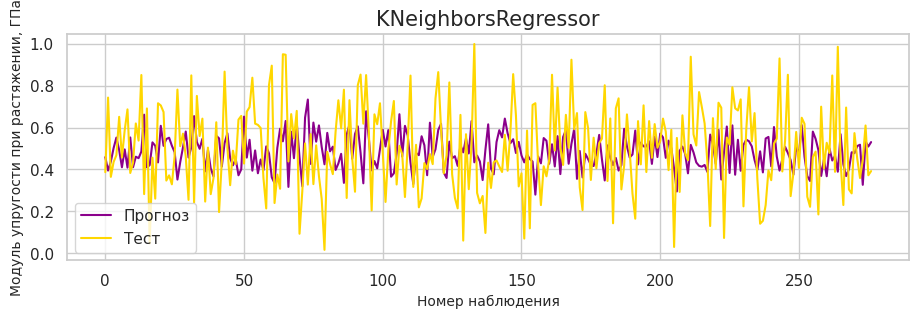

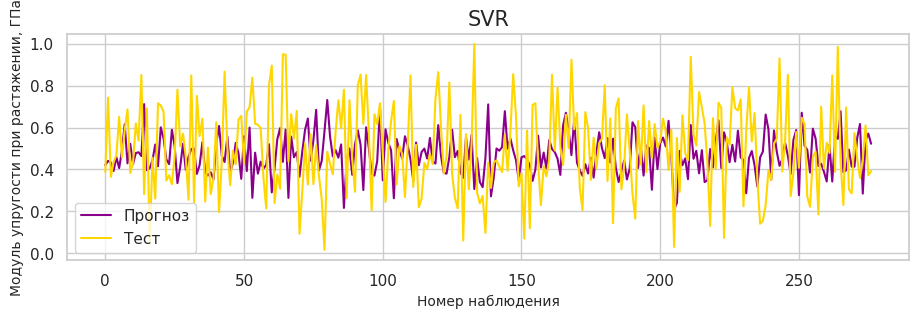

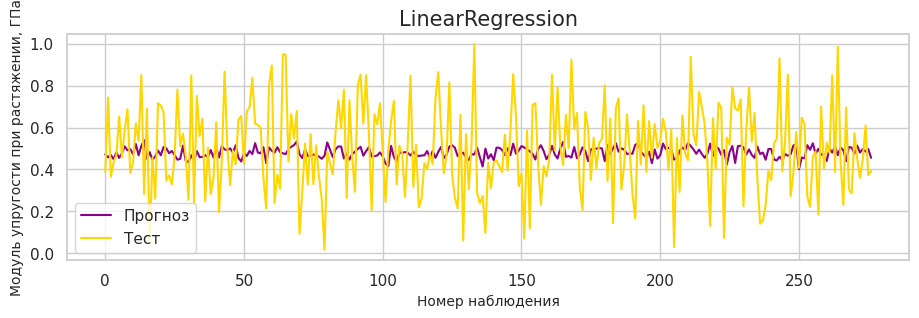

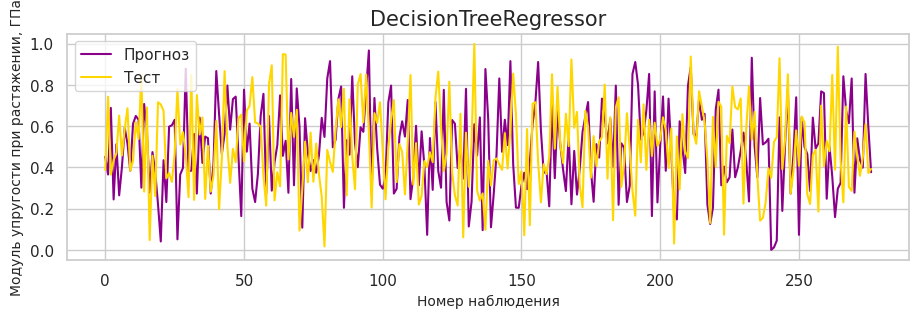

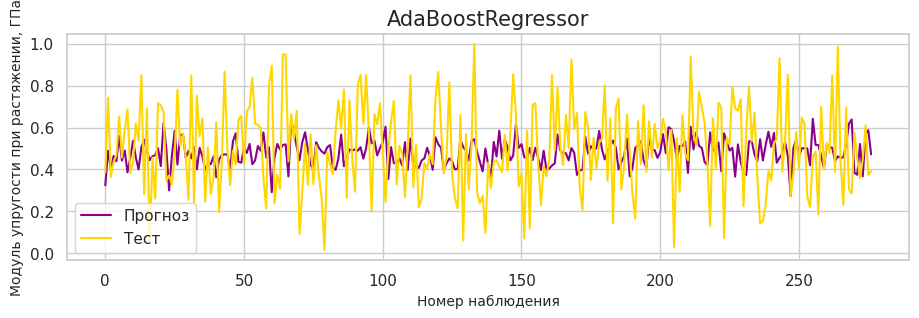

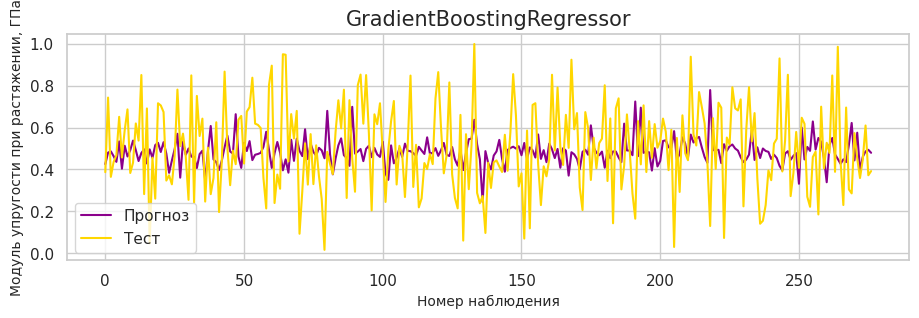

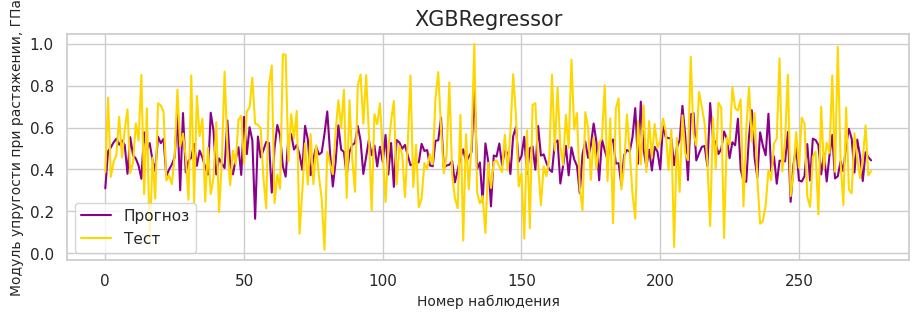

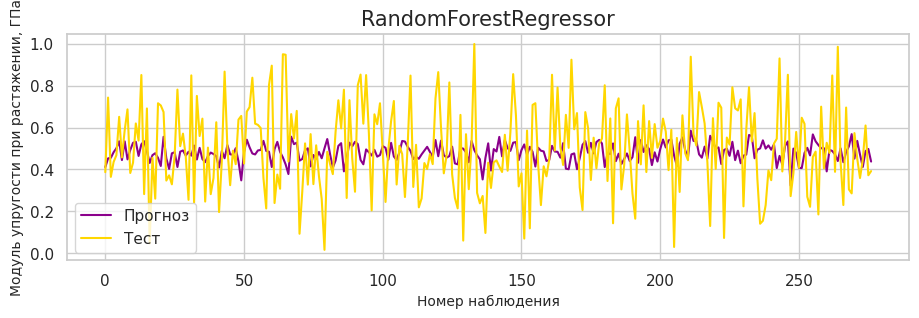

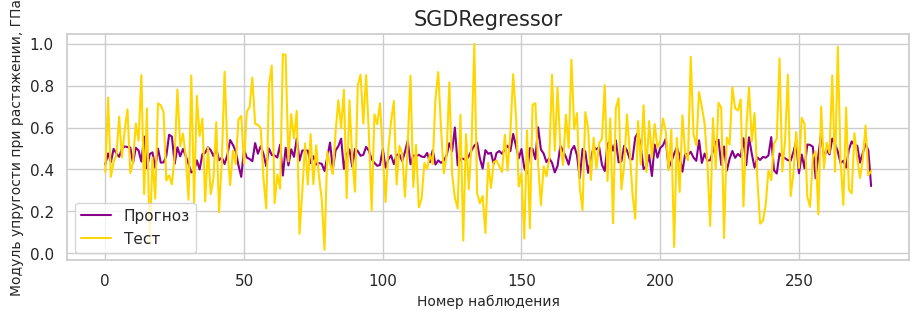

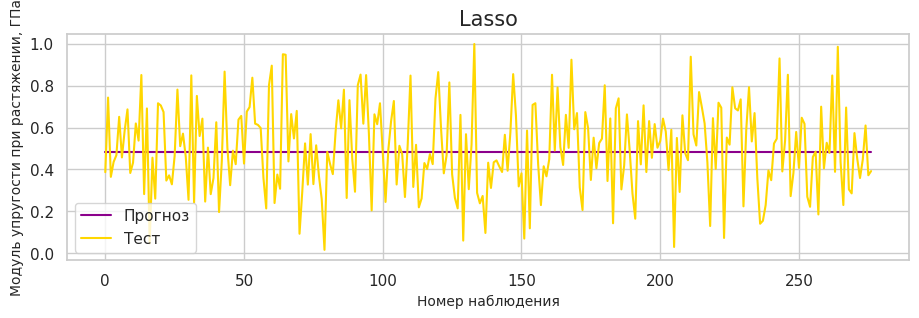

In [ ]:
# Визуализируем прогнозные результаты y_pred для каждой модели
def Model_Comparision_Visualization(AllModels, x_train, y_train, x_test, y_test):
    for i, myModel in enumerate(AllModels, 1):
        myModel.fit(x_train, y_train)
        
        # Предсказание значений для тестового набора данных
        y_pred_test = myModel.predict(x_test)
        
        # Рисуем графики для значений у: тестового и прогнозного
        plt.figure(figsize = (50, 10))
        plt.subplot(n_rows, n_cols, i)      
        plt.plot(y_pred_test, label = "Прогноз", color = "darkmagenta")
        plt.plot(y_test, label = "Тест", color = "gold")
        plt.xlabel("Номер наблюдения", size=10)
        plt.ylabel("Модуль упругости при растяжении, ГПа", size=10)
        plt.title(type(myModel).__name__, size=15)
        plt.legend()
        plt.show()         
    
n_subplots = len([KNR, SVReg, LR, DTR, Abr, Gbr, XgbR, RFR, SGDR, LassoR])          # считаем количество графиков
n_cols = 4                                                                          # задаем количество столбцов
n_rows = (n_subplots + n_cols - 1) // n_cols                                        # вычисляем количество строк

# Выводим на экран графики прогнозных и тестов значений для каждой модели
Model_Comparision_Visualization([KNR, SVReg, LR, DTR, Abr, Gbr, XgbR, RFR, SGDR, LassoR], X_train_elastic, np.ravel(y_train_elastic), X_test_elastic, np.ravel(y_test_elastic))

Задачу выбора модели усложняет тот факт, что у многих типов моделей существуют разные вариации, особые параметры. Гиперпараметр модели – это численное значение, которое влияет на работу модели, но не подбирается в процессе обучения. Они задаются при определении модели и должны оставаться неизменными до схождения алгоритма обучения. 

Поиск по сетке – полный перебор всех комбинаций значений гиперпараметров для поиска оптимальных значений. Для его организации надо задать список гиперпараметров и их конкретных значений. Поиск по сетке имеет экспоненциальную сложность. Чем больше параметров и значений задать, тем лучше получится модель, но дольше поиск. Рекомендуется использовать кросс-валидацию. По умолчанию используется оценка модели, встроенная в сам объект модели через метод score, то есть точность (accuracy) для классификации и коэффициент детерминации (r-квадрат) для регрессии.

In [ ]:
# Проведем поиск гиперпараметров моделей с помощью поиска по сетке с перекрестной проверкой, количество блоков равно 10 (cv = 10)
# Воспользуемся методом GridSearchCV() 

# Создадим функцию для выбора лучшей модели
def Model_Selection(x_train, y_train, x_test, y_test):
    best_score = -10.0
    best_regressor = 0
    best_model = ''
    
    # Создаем список всех моделей регрессоров
    regressors = ['kneighborsregressor', 'svr', 'linearregression', 'decisiontreeregressor', 'adaboostregressor', 
                  'gradientboostingregressor', 'xgbregressor', 'randomforestregressor', 'sgdregressor', 'lasso']

    # Создаем словарь с набором всех используемых компонентов пайплайнов
    all_models = {'kneighborsregressor': KNeighborsRegressor(),
                  'svr': SVR(),
                  'linearregression': LinearRegression(),
                  'decisiontreeregressor': DecisionTreeRegressor(),
                  'adaboostregressor': AdaBoostRegressor(base_estimator = DecisionTreeRegressor()),
                  'gradientboostingregressor': GradientBoostingRegressor(),
                  'xgbregressor': XGBRegressor(),
                  'randomforestregressor': RandomForestRegressor(),
                  'sgdregressor': SGDRegressor(),
                  'lasso': Lasso()
                 }

    # Создаем словарь с наборами гиперпараметров всех моделей
    all_params = {'kneighborsregressor':       {'kneighborsregressor__n_neighbors': [i for i in range(1, 201, 2)],
                                                'kneighborsregressor__weights':     ['uniform', 'distance'],
                                                'kneighborsregressor__algorithm':   ['auto', 'ball_tree', 'kd_tree', 'brute']
                                               },
                  'svr':                       {'svr__kernel': ['linear', 'poly', 'rbf', 'sigmoid'],
                                                'svr__C':      [0.01, 0.1, 1],
                                                'svr__gamma':  [0.01, 0.1, 1]
                                               },
                  'linearregression':          {'linearregression__fit_intercept': [True, False]},
                  'decisiontreeregressor':     {'decisiontreeregressor__max_depth':         [3, 5, 7, 9, 11, 13, 15],
                                                'decisiontreeregressor__min_samples_leaf':  [1, 2, 5, 10, 20, 50, 100, 150, 200],
                                                'decisiontreeregressor__min_samples_split': [200, 250, 300],
                                                'decisiontreeregressor__max_features':      ['auto', 'sqrt', 'log2']   
                                               },       
                  'adaboostregressor':         {'adaboostregressor__base_estimator__max_depth':        [i for i in range(2, 11, 2)],
                                                'adaboostregressor__base_estimator__min_samples_leaf': [5,  10],
                                                'adaboostregressor__n_estimators':                     [10, 50, 100, 250, 1000],
                                                'adaboostregressor__learning_rate':                    [0.01, 0.05, 0.1, 0.5]
                                               },
                  'gradientboostingregressor': {'gradientboostingregressor__learning_rate': [0.01,  0.02, 0.03, 0.04],
                                                'gradientboostingregressor__subsample'    : [0.9, 0.5, 0.2, 0.1],
                                                'gradientboostingregressor__n_estimators' : [100, 500, 1000, 1500],
                                                'gradientboostingregressor__max_depth'    : [4, 6, 8, 10]
                                               },
                  'xgbregressor':              {'xgbregressor__learning_rate':    [0.05, 0.10, 0.15],
                                                'xgbregressor__max_depth':        [ 3, 4, 5, 6, 8],
                                                'xgbregressor__min_child_weight': [ 1, 3, 5, 7],
                                                'xgbregressor__gamma':            [ 0.0, 0.1, 0.2],
                                                'xgbregressor__colsample_bytree': [ 0.3, 0.4]
                                               },         
                  'randomforestregressor':     {'randomforestregressor__n_estimators':     [30, 100, 200, 300, 500],
                                                'randomforestregressor__max_depth':        [1, 2, 3, 4, 5, 6, 7, 8],
                                                'randomforestregressor__min_samples_leaf': [1, 2],
                                                'randomforestregressor__max_features':     ['auto', 'sqrt', 'log2']
                                               }, 
                  'sgdregressor':              {'sgdregressor__penalty': ['l2', 'l1', 'elasticnet', None],
                                                'sgdregressor__alpha':   [0.0001, 0.001, 0.01, 0.1]
                                               },
                  'lasso':                     {'lasso__alpha': [0.01, 0.02, 0.1, 0.2, 0.03, 0.3, 0.05, 0.5, 0.07, 0.7, 1]}
                 }

    # Запускаем основной цикл, на каждой итерации которого генерируем очередное сочетание всех этапов пайплайна
    for i, regressor in enumerate(regressors, 1):
        
        # Создаем pipeline для выбора наилучшей модели
        pipe = make_pipeline(all_models[regressor])
    
        # Создаем словарь гиперпараметров для пайплайна
        current_params = {}
        current_params.update(all_params[regressor])
        #print(current_params)
    
        # Выполняем обучение и оценку качества с помощью кросс-валидации, 
        model = GridSearchCV(estimator = pipe, param_grid = current_params,
                             scoring = 'r2', cv = 10, n_jobs = -1)
        model.fit(x_train, y_train)
       
        print('{} Лучшее значение R2 на тренировочной выборке: {:.4f}'.format(all_models[regressor], model.score(x_train, y_train)))
        print('{} Лучшее значение R2 на тестовой выборке {:.4f}'.format(all_models[regressor], model.score(x_test, y_test)))
        print('{} Лучшее значение R2 на перекрестной проверке: {:.4f}'.format(all_models[regressor], model.best_score_))
        print('{} Лучшие параметры модели: {}'.format(all_models[regressor], model.best_params_))
        print('\n______________________________________________________________________________________________________\n')
        if model.score(x_test, y_test) > best_score:
                best_score = model.score(x_test, y_test)
                best_model = model.best_estimator_
                best_regressor = regressor
    print('Регрессор с лучшим значением R2 = {:.4f} на тестовой выборке: {}\n'.format(best_score, all_models[best_regressor]))
    print('Лучший алгоритм:\n{}\n'.format(best_model))

In [ ]:
Model_Selection(X_train_elastic, np.ravel(y_train_elastic), X_test_elastic, np.ravel(y_test_elastic))

KNeighborsRegressor() Лучшее значение R2 на тренировочной выборке: 0.0091
KNeighborsRegressor() Лучшее значение R2 на тестовой выборке -0.0105
KNeighborsRegressor() Лучшее значение R2 на перекрестной проверке: -0.0021
KNeighborsRegressor() Лучшие параметры модели: {'kneighborsregressor__algorithm': 'auto', 'kneighborsregressor__n_neighbors': 199, 'kneighborsregressor__weights': 'uniform'}

______________________________________________________________________________________________________

SVR() Лучшее значение R2 на тренировочной выборке: 0.0326
SVR() Лучшее значение R2 на тестовой выборке -0.0146
SVR() Лучшее значение R2 на перекрестной проверке: -0.0031
SVR() Лучшие параметры модели: {'svr__C': 0.01, 'svr__gamma': 1, 'svr__kernel': 'rbf'}

______________________________________________________________________________________________________

LinearRegression() Лучшее значение R2 на тренировочной выборке: 0.0172
LinearRegression() Лучшее значение R2 на тестовой выборке -0.0245
Line

In [ ]:
# Рассчитаем метрики для моделей с их лучшими параметрами:
KNR_best = KNeighborsRegressor(algorithm='auto', n_neighbors=199, weights='uniform')
SVReg_best = SVR(C=0.01, gamma=1, kernel='rbf')
LR_best = LinearRegression(fit_intercept=True)
DTR_best = DecisionTreeRegressor(max_depth=9, max_features='sqrt', min_samples_leaf=200, min_samples_split=250)
Abr_best = AdaBoostRegressor(base_estimator=DecisionTreeRegressor(max_depth=2, min_samples_leaf=10), learning_rate=0.01, n_estimators=10)
Gbr_best = GradientBoostingRegressor(learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.5)
XgbR_best = XGBRegressor(colsample_bytree=0.3, gamma=0.2, learning_rate=0.05, max_depth=3, min_child_weight=5)
RFR_best = RandomForestRegressor(max_depth=1, max_features='log2', min_samples_leaf=2, n_estimators=100)
SGDR_best = SGDRegressor(alpha=0.1, penalty='l1')
LassoR_best = Lasso(alpha=0.01)

Model_Comparision_Train_Test([KNR_best, SVReg_best, LR_best, DTR_best, Abr_best, Gbr_best, XgbR_best, RFR_best, SGDR_best, LassoR_best], X_train_elastic, np.ravel(y_train_elastic), X_test_elastic, np.ravel(y_test_elastic))

,R2_score,MAE,MSE,RMSE,MAPE
Model,,,,,
KNeighborsRegressor,-0.0105 (0.0091),0.17 (0.15),0.04 (0.04),0.21 (0.19),0.65 (3324567063626.71)
SVR,-0.0146 (0.0326),0.17 (0.15),0.04 (0.04),0.21 (0.19),0.65 (3293971898525.6)
LinearRegression,-0.0245 (0.0172),0.17 (0.15),0.04 (0.04),0.21 (0.19),0.65 (3530183592566.66)
DecisionTreeRegressor,-0.0137 (0.0098),0.17 (0.15),0.04 (0.04),0.21 (0.19),0.65 (3297525218666.87)
AdaBoostRegressor,-0.0148 (0.0241),0.17 (0.15),0.04 (0.04),0.21 (0.19),0.65 (3298812922104.4)
GradientBoostingRegressor,-0.0171 (0.1632),0.17 (0.14),0.04 (0.03),0.21 (0.18),0.65 (2860805383305.9)
XGBRegressor,-0.0339 (0.0956),0.17 (0.15),0.04 (0.03),0.21 (0.18),0.66 (3213220893174.23)
RandomForestRegressor,-0.0096 (0.0181),0.17 (0.15),0.04 (0.04),0.21 (0.19),0.66 (3422014853999.63)
SGDRegressor,-0.0095 (-0.0),0.17 (0.16),0.04 (0.04),0.21 (0.19),0.65 (3358150040417.99)


Когда R2 отрицательно. Это означает, что модель хуже, чем предсказание среднего значения.

Модели плохо обучаются на тренировочной выборке и, соответственно, плохо предсказывают значения для тестовой выборки.

Коэффициент MAE одинаков у всех моделей.

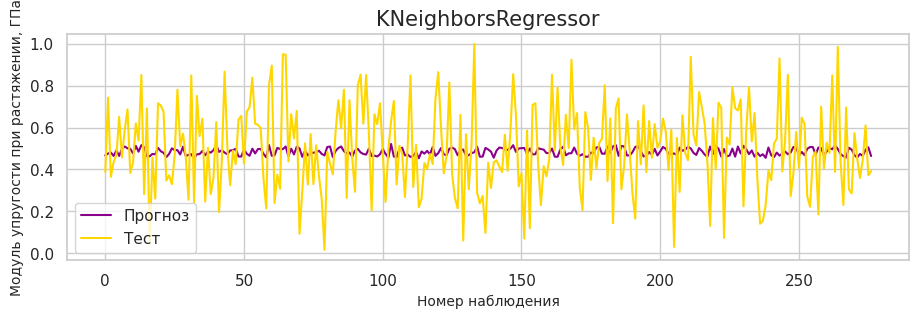

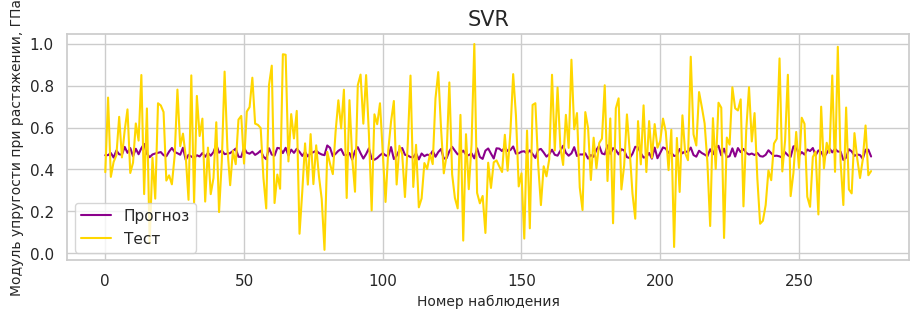

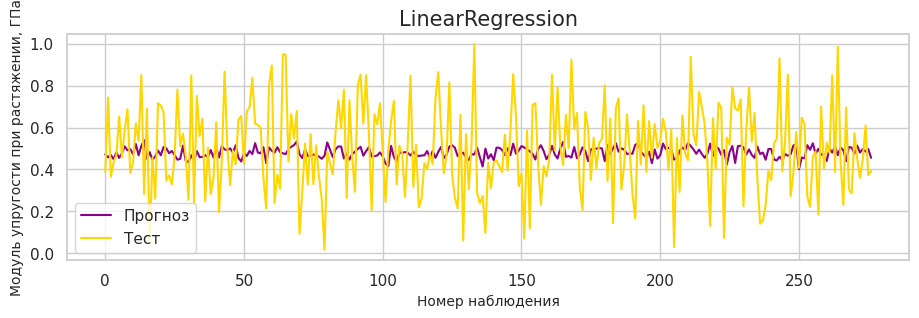

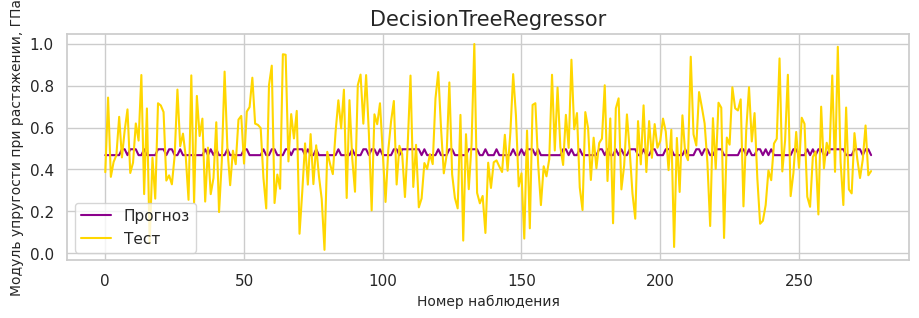

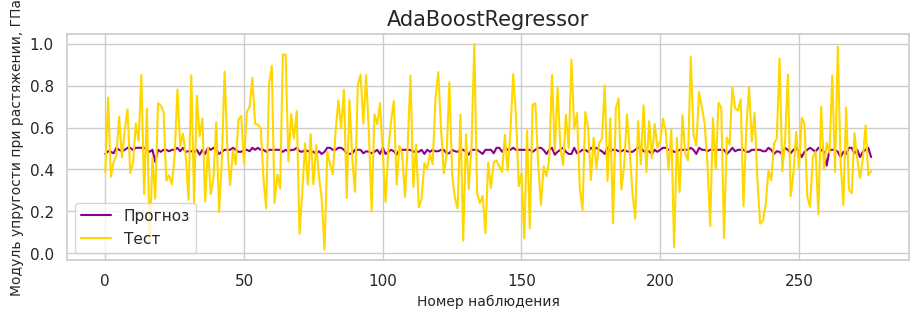

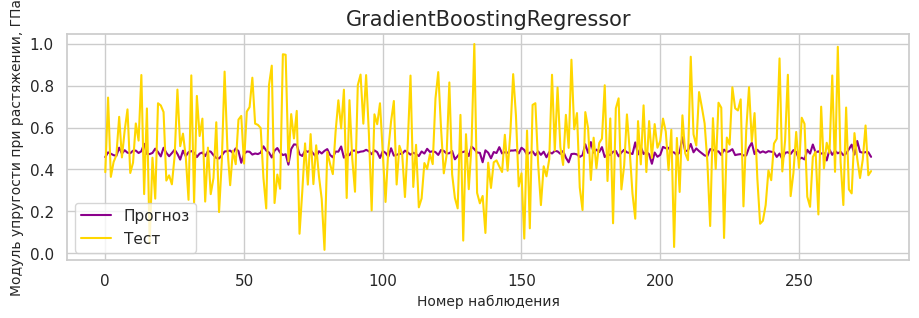

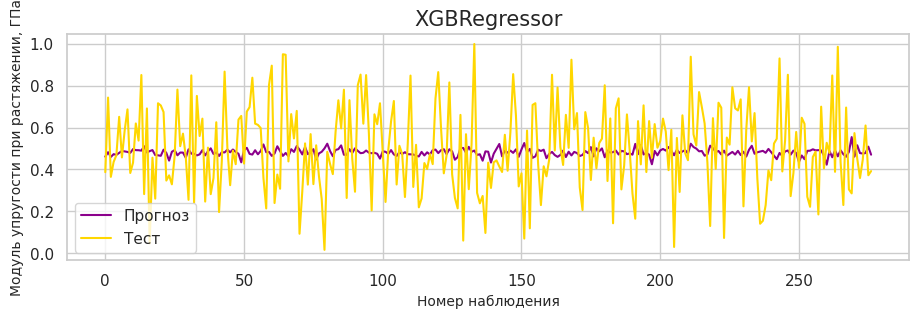

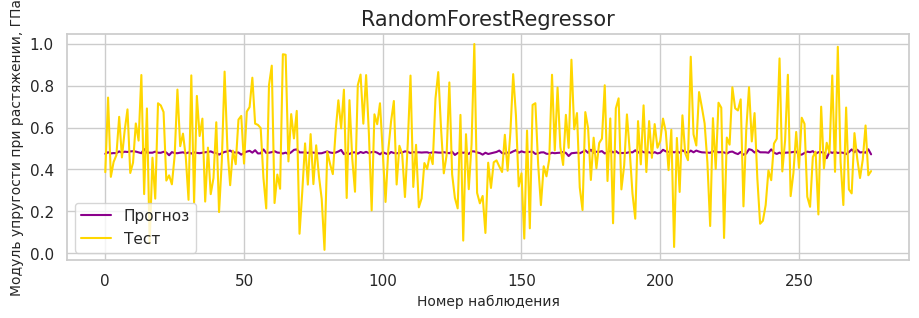

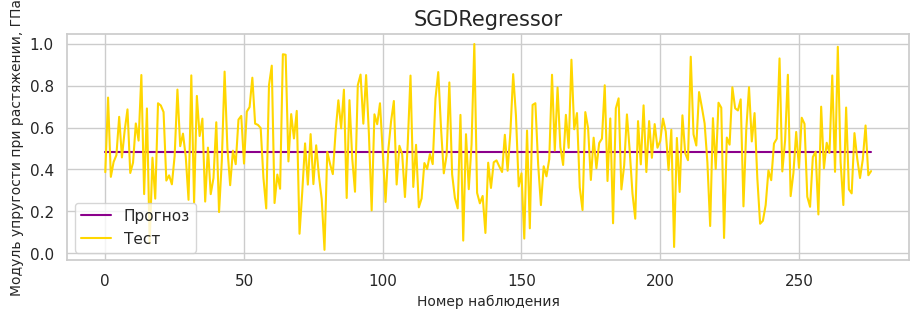

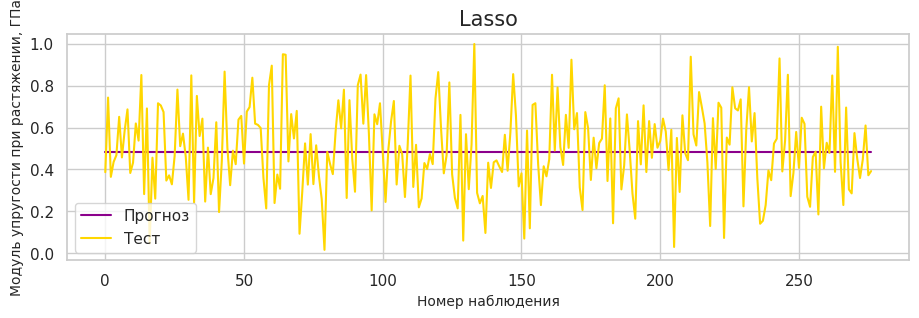

In [ ]:
# Визуализируем прогнозные результаты y_pred для каждой модели после настройки гиперпараметров
Model_Comparision_Visualization([KNR_best, SVReg_best, LR_best, DTR_best, Abr_best, Gbr_best, XgbR_best, RFR_best, SGDR_best, LassoR_best], X_train_elastic, np.ravel(y_train_elastic), X_test_elastic, np.ravel(y_test_elastic))

Визуализация показывает, что после подбора гиперпараметров модели стали хуже прогнозировать результат.

Все использованные модели плохо справились с поставленной задачей прогнозирования модуля упругости при растяжении. 

Получен неудовлетворительный результат.

### _05.2. Прогнозирование прочности при растяжении.

In [ ]:
# Разделим датасет на тренировочную и тестовую выборки. 
# При построении модели 30% данных оставим на тестирование модели, на остальных происходит обучение моделей. 
X_train_strong, X_test_strong, y_train_strong, y_test_strong = train_test_split(
                                                               df_norm.drop(['Прочность при растяжении, МПа', 'Модуль упругости при растяжении, ГПа'], axis=1), 
                                                               df_norm[['Прочность при растяжении, МПа']], 
                                                               test_size = 0.3, 
                                                               random_state = 42, 
                                                               shuffle = True
                                                               )

In [ ]:
# Посмотрим размерность тренировочной и тестовой выборок
print('Размер тренировочного датасета: {}\nРазмер тестового датасета:{}'.format(X_train_strong.shape, X_test_strong.shape))

Размер тренировочного датасета: (645, 11)
Размер тестового датасета:(277, 11)


In [ ]:
X_train_strong

,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Потребление смолы, г/м2",Угол нашивки,Шаг нашивки,Плотность нашивки
481,0.266219,0.643037,0.278232,0.234584,0.439240,0.321655,0.495611,0.623998,1.0,0.571430,0.433990
650,0.178334,0.586130,0.463191,0.348338,0.616075,0.320131,0.204285,0.391352,1.0,0.317517,0.537455
483,0.297796,0.532890,0.354250,0.758052,0.625457,0.716345,0.348479,0.237919,1.0,0.554280,0.619605
355,0.590224,0.605695,0.692900,0.360136,0.654481,0.389632,0.456376,0.392215,0.0,0.474980,0.306469
850,0.258455,0.170680,0.502517,0.470569,0.576124,0.477262,0.229392,0.682036,1.0,0.623942,0.429910
...,...,...,...,...,...,...,...,...,...,...,...
106,0.803910,0.303772,0.201130,0.287544,0.329381,0.622672,0.026298,0.576014,0.0,0.549851,0.495193
270,0.577452,0.777923,0.431133,0.526907,0.377453,0.646398,0.841346,0.500515,0.0,0.584309,0.410964
860,0.359950,0.378127,0.731477,0.305836,0.655804,0.372042,0.227940,0.590147,1.0,0.380169,0.529197
435,0.517953,0.781825,0.688797,0.467451,0.715422,0.431429,0.226518,0.329278,0.0,0.050576,0.965176


In [ ]:
y_train_strong

,"Прочность при растяжении, МПа"
481,0.578683
650,0.479890
483,0.569650
355,0.641999
850,0.436179
...,...
106,0.309596
270,0.486406
860,0.627286
435,0.456208


In [ ]:
# Рассчитаем метрики для всех моделей
Model_Comparision_Train_Test([KNR, SVReg, LR, DTR, Abr, Gbr, XgbR, RFR, SGDR, LassoR], X_train_strong, np.ravel(y_train_strong), X_test_strong, np.ravel(y_test_strong))

,R2_score,MAE,MSE,RMSE,MAPE
Model,,,,,
KNeighborsRegressor,-0.1709 (0.2163),0.17 (0.13),0.04 (0.03),0.21 (0.17),9889558054234.58 (0.59)
SVR,-0.143 (0.4812),0.17 (0.11),0.04 (0.02),0.21 (0.13),8845741152738.04 (0.49)
LinearRegression,-0.0035 (0.017),0.15 (0.15),0.04 (0.03),0.19 (0.19),9069348467609.18 (0.68)
DecisionTreeRegressor,-0.8441 (1.0),0.21 (0.0),0.07 (0.0),0.26 (0.0),11200413065091.62 (0.0)
AdaBoostRegressor,-0.1108 (1.0),0.16 (0.0),0.04 (0.0),0.2 (0.0),8150490315018.01 (0.0)
GradientBoostingRegressor,-0.054 (0.5301),0.16 (0.1),0.04 (0.02),0.2 (0.13),8315009586345.83 (0.46)
XGBRegressor,-0.2193 (0.9992),0.17 (0.0),0.05 (0.0),0.21 (0.01),7914619789460.38 (0.01)
RandomForestRegressor,-0.0338 (0.8552),0.16 (0.06),0.04 (0.01),0.2 (0.07),8935552845106.92 (0.27)
SGDRegressor,-0.0442 (-0.0769),0.16 (0.16),0.04 (0.04),0.2 (0.19),6902333851895.17 (0.72)


Когда R2 отрицательно, это означает, что модель хуже, чем предсказание среднего значения.

Лучшие показатели R2 и MAE на тестовой выборке у алгоритма регрессии «Lasso», на тренировочной выборке - у алгоритмов DecisionTreeRegressor, XGBRegressor и AdaBoostRegressor.

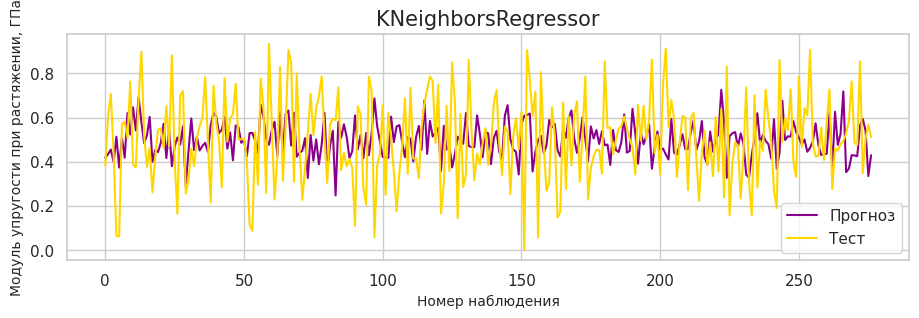

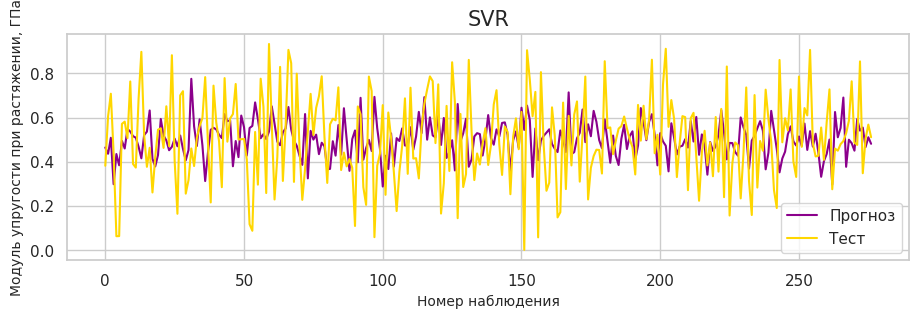

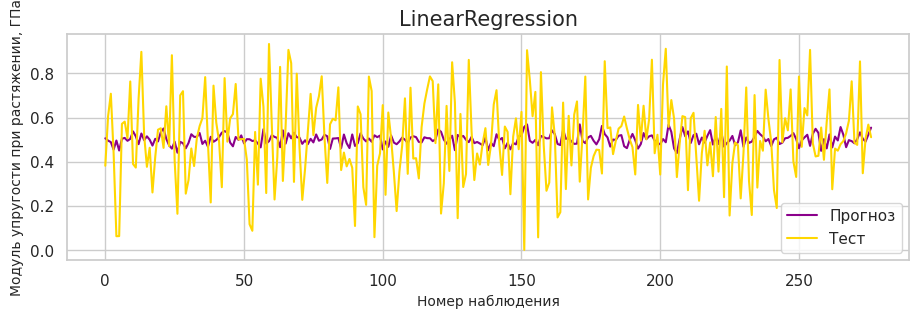

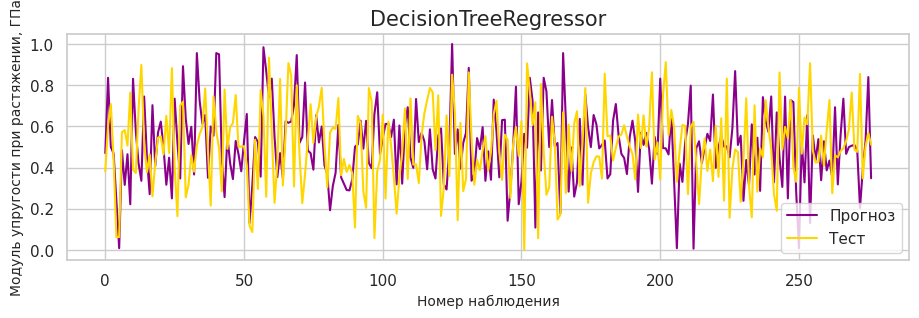

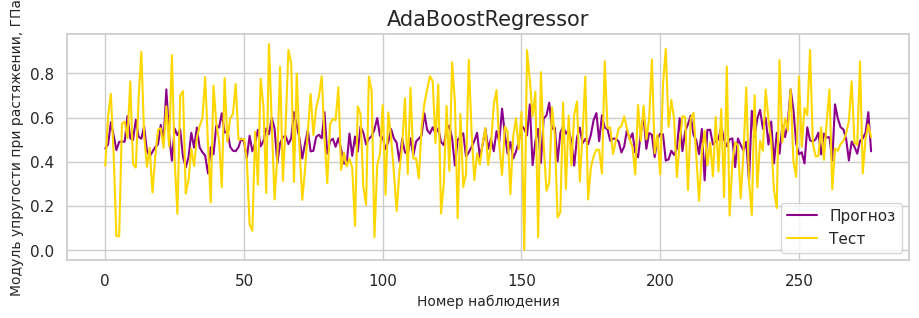

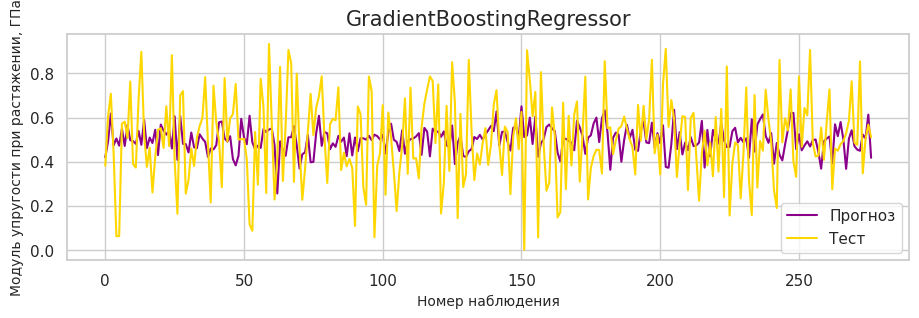

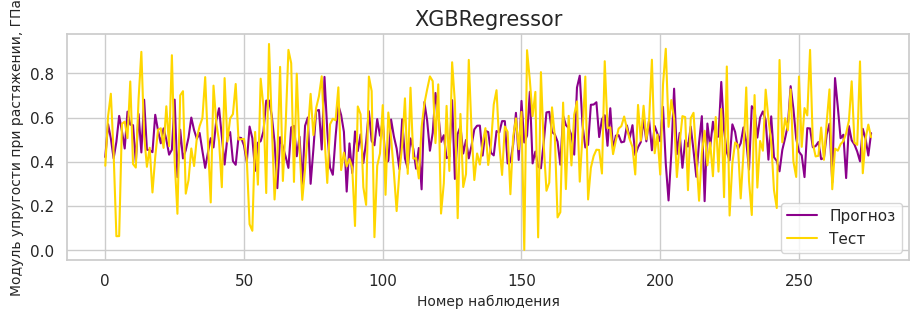

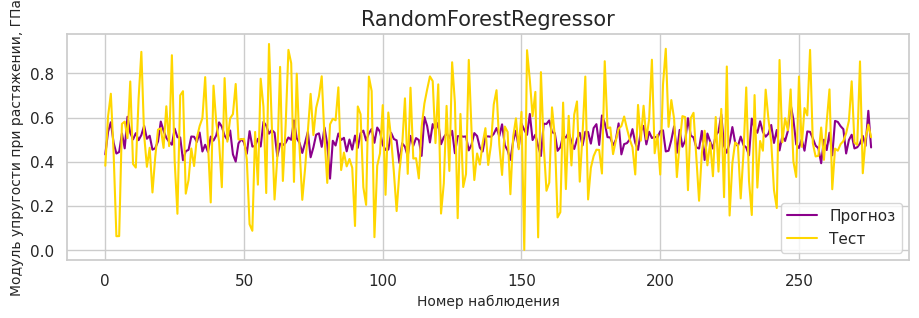

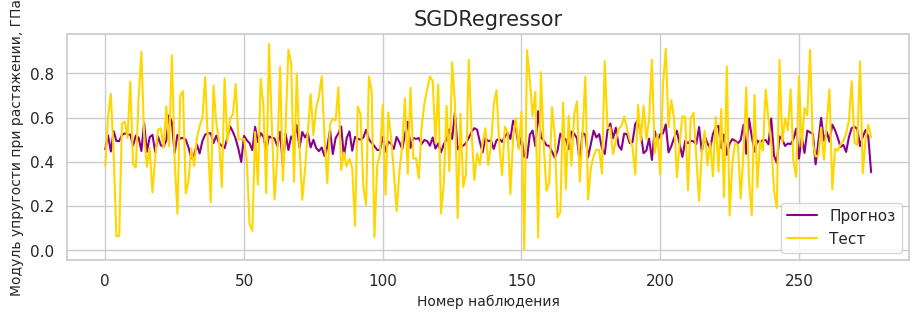

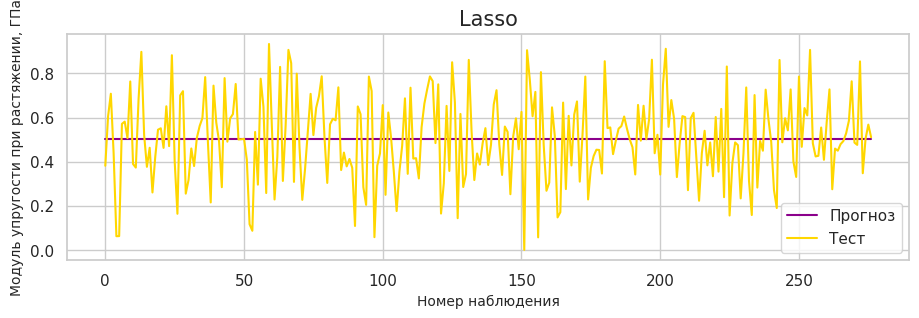

In [ ]:
# Визуализируем прогнозные результаты y_pred для каждой модели
Model_Comparision_Visualization([KNR, SVReg, LR, DTR, Abr, Gbr, XgbR, RFR, SGDR, LassoR], X_train_strong, np.ravel(y_train_strong), X_test_strong, np.ravel(y_test_strong))

In [ ]:
# Проведем поиск гиперпараметров моделей с помощью поиска по сетке с перекрестной проверкой, количество блоков равно 10 (cv = 10)
Model_Selection(X_train_strong, np.ravel(y_train_strong), X_test_strong, np.ravel(y_test_strong))

KNeighborsRegressor() Лучшее значение R2 на тренировочной выборке: 1.0000
KNeighborsRegressor() Лучшее значение R2 на тестовой выборке -0.0020
KNeighborsRegressor() Лучшее значение R2 на перекрестной проверке: -0.0136
KNeighborsRegressor() Лучшие параметры модели: {'kneighborsregressor__algorithm': 'auto', 'kneighborsregressor__n_neighbors': 159, 'kneighborsregressor__weights': 'distance'}

______________________________________________________________________________________________________

SVR() Лучшее значение R2 на тренировочной выборке: 0.0012
SVR() Лучшее значение R2 на тестовой выборке -0.0012
SVR() Лучшее значение R2 на перекрестной проверке: -0.0103
SVR() Лучшие параметры модели: {'svr__C': 0.01, 'svr__gamma': 0.1, 'svr__kernel': 'poly'}

______________________________________________________________________________________________________

LinearRegression() Лучшее значение R2 на тренировочной выборке: 0.0170
LinearRegression() Лучшее значение R2 на тестовой выборке -0.0035


In [ ]:
# Рассчитаем метрики для моделей с их лучшими параметрами:
KNR_best = KNeighborsRegressor(algorithm='auto', n_neighbors=159, weights='distance')
SVReg_best = SVR(C=0.01, gamma=0.1, kernel='poly')
LR_best = LinearRegression(fit_intercept=True)
DTR_best = DecisionTreeRegressor(max_depth=15, max_features='sqrt', min_samples_leaf=100, min_samples_split=250)
Abr_best = AdaBoostRegressor(base_estimator=DecisionTreeRegressor(max_depth=2, min_samples_leaf=10), learning_rate=0.01, n_estimators=50)
Gbr_best = GradientBoostingRegressor(learning_rate=0.01, max_depth=8, n_estimators=100, subsample=0.1)
XgbR_best = XGBRegressor(colsample_bytree=0.3, gamma=0.2, learning_rate=0.05, max_depth=3, min_child_weight=5)
RFR_best = RandomForestRegressor(max_depth=1, max_features='log2', min_samples_leaf=2, n_estimators=30)
SGDR_best = SGDRegressor(alpha=0.1, penalty='l1')
LassoR_best = Lasso(alpha=0.01)

Model_Comparision_Train_Test([KNR_best, SVReg_best, LR_best, DTR_best, Abr_best, Gbr_best, XgbR_best, RFR_best, SGDR_best, LassoR_best], X_train_strong, np.ravel(y_train_strong), X_test_strong, np.ravel(y_test_strong))

,R2_score,MAE,MSE,RMSE,MAPE
Model,,,,,
KNeighborsRegressor,-0.002 (1.0),0.15 (0.0),0.04 (0.0),0.19 (0.0),8176160847752.77 (0.0)
SVR,-0.0012 (0.0012),0.15 (0.15),0.04 (0.03),0.19 (0.19),8151410332325.56 (0.69)
LinearRegression,-0.0035 (0.017),0.15 (0.15),0.04 (0.03),0.19 (0.19),9069348467609.18 (0.68)
DecisionTreeRegressor,0.0056 (0.0231),0.15 (0.15),0.04 (0.03),0.19 (0.18),8408376981617.02 (0.68)
AdaBoostRegressor,-0.0056 (0.0503),0.15 (0.15),0.04 (0.03),0.19 (0.18),8876086597728.5 (0.67)
GradientBoostingRegressor,-0.0242 (0.1577),0.16 (0.14),0.04 (0.03),0.19 (0.17),8718839315761.45 (0.64)
XGBRegressor,0.0005 (0.1155),0.15 (0.14),0.04 (0.03),0.19 (0.18),8709751775321.21 (0.65)
RandomForestRegressor,-0.0027 (0.0224),0.15 (0.15),0.04 (0.03),0.19 (0.18),8470893491267.1 (0.68)
SGDRegressor,-0.0 (-0.0),0.15 (0.15),0.04 (0.03),0.19 (0.19),8189794025175.98 (0.69)


Если R2 отрицательна, то модель работает хуже, чем простой подсчет среднего.

Отрицательные значение коэффициента детерминации означают слабую обобщающую способность моделей.

Коэффициент MAE одинаков у всех моделей.

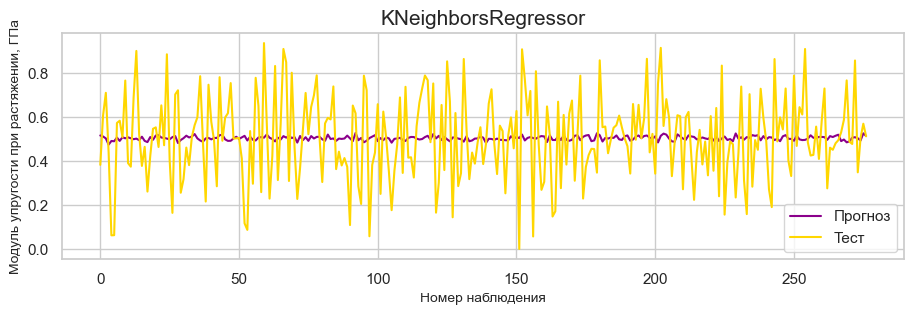

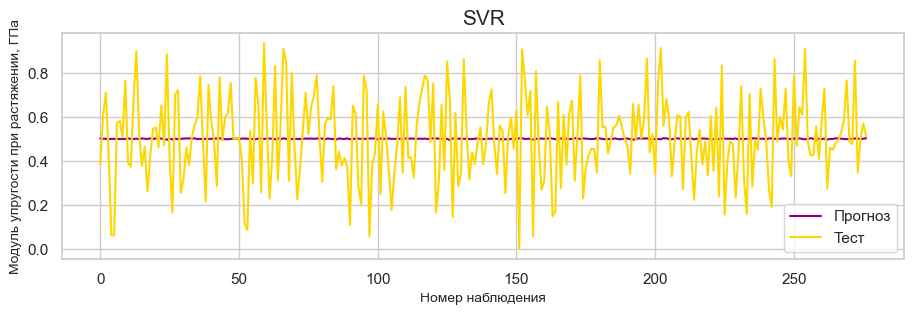

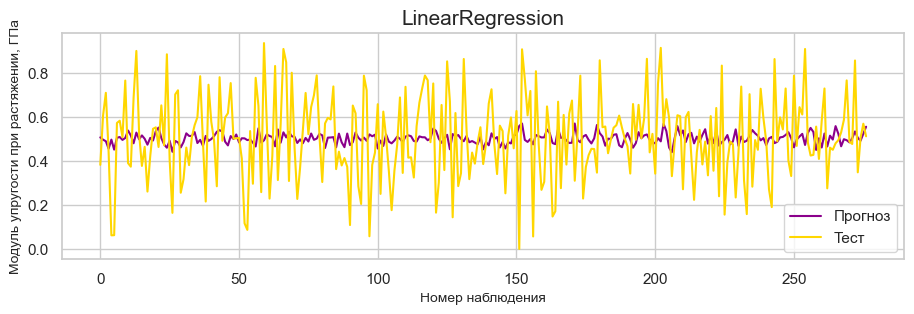

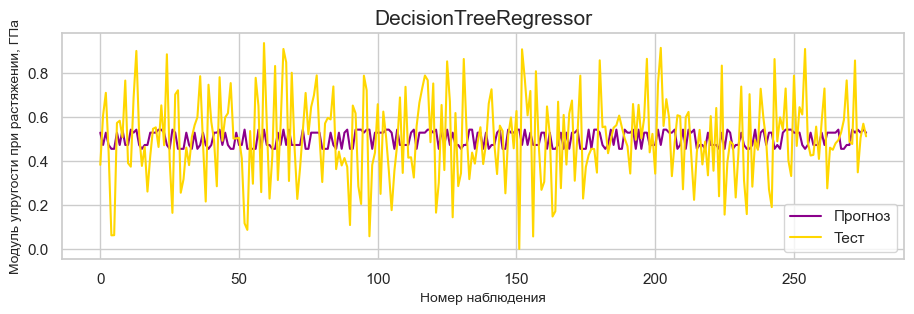

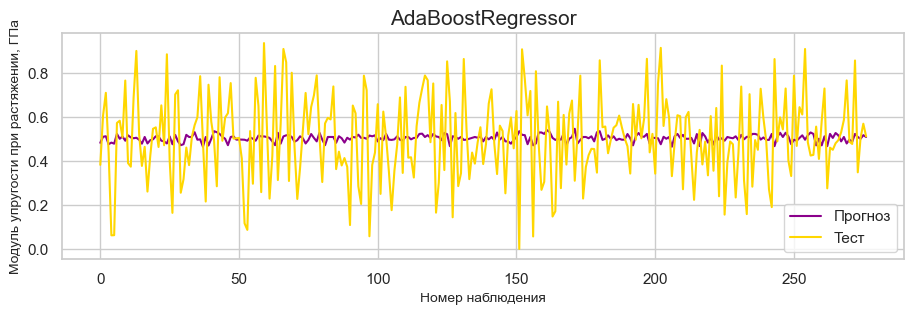

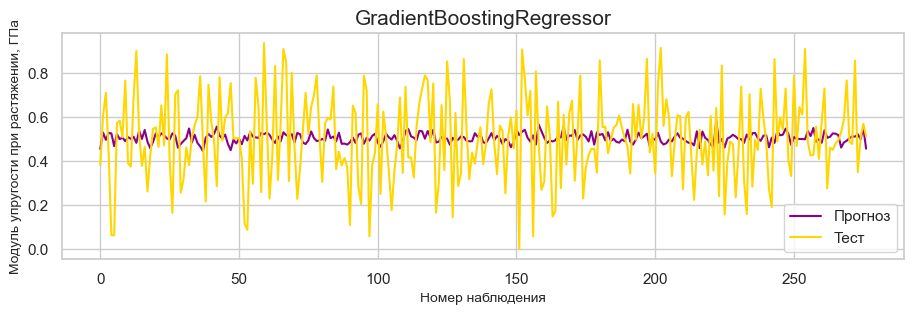

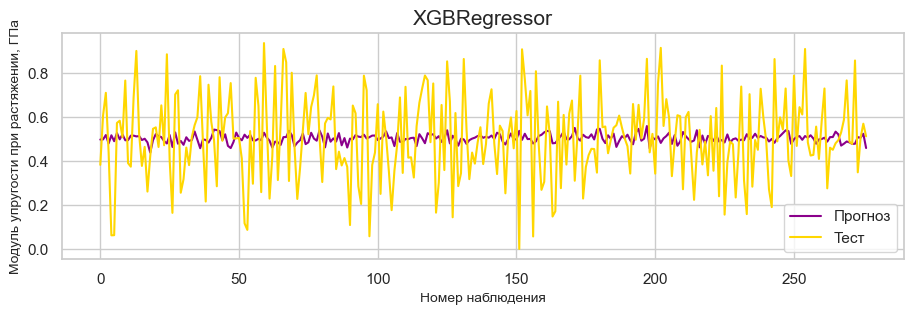

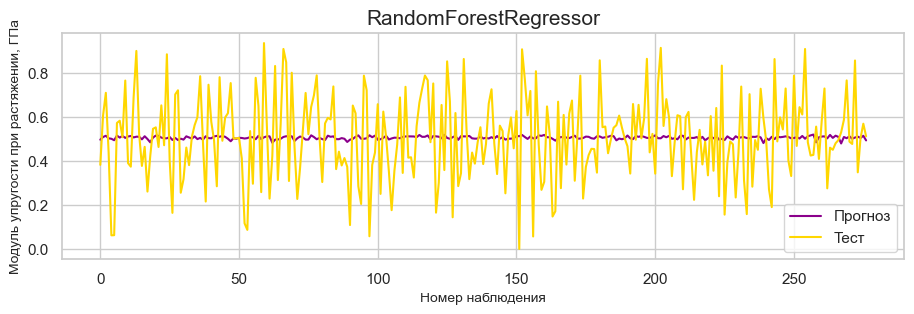

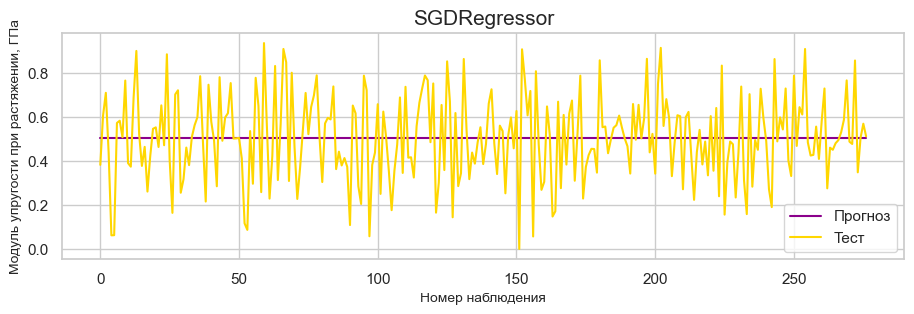

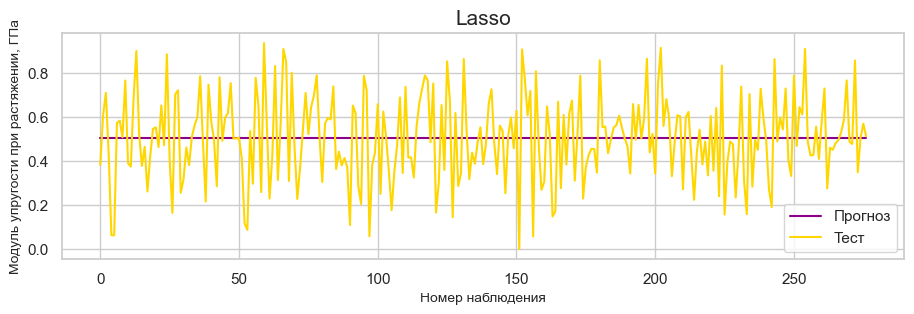

In [ ]:
# Визуализируем прогнозные результаты y_pred для каждой модели после настройки гиперпараметров
Model_Comparision_Visualization([KNR_best, SVReg_best, LR_best, DTR_best, Abr_best, Gbr_best, XgbR_best, RFR_best, SGDR_best, LassoR_best], X_train_strong, np.ravel(y_train_strong), X_test_strong, np.ravel(y_test_strong))

Визуализация показывает, что после подбора гиперпараметров модели стали хуже прогнозировать результат.

Обратим внимание на параметр MAPE. Наилучшее значение данного параметра равно 0.0. Но необходимо учесть, что неверные прогнозы могут привести к сколь угодно большим значениям MAPE, особенно если некоторые y_true значения очень близки к нулю.

#### Вывод: 

Все использованные модели плохо справились с поставленной задачей прогнозирования прочности при растяжении.

Полученный результат не решает поставленную задачу.

С учетом полученных неудовлетворительных результатов в качестве прогноза для модуля упругости при растяжении и прочности при растяжении можно использовать среднее значение признака

## _06. Нейронная сеть для рекомендации соотношения "матрица - наполнитель".

In [ ]:
# Разделим датасет на тренировочную и тестовую выборки. 
# При построении модели 30% данных оставим на тестирование модели, на остальных происходит обучение моделей. 
X_train_matrix, X_test_matrix, y_train_matrix, y_test_matrix = train_test_split(
                                                               df_norm.drop(['Соотношение матрица-наполнитель'], axis=1), 
                                                               df_norm[['Соотношение матрица-наполнитель']], 
                                                               test_size = 0.3, 
                                                               random_state = 42, 
                                                               shuffle = True
                                                               )

In [ ]:
# Посмотрим размерность тренировочной и тестовой выборок
print('Размер тренировочного датасета: {}\nРазмер тестового датасета:{}'.format(X_train_matrix.shape, X_test_matrix.shape))

Размер тренировочного датасета: (645, 12)
Размер тестового датасета:(277, 12)


In [ ]:
# Создадим функцию для генерации слоев нейронной сети
def create_NN_model(layers, activation, drop, opt): 
        model= Sequential()
        for i, neurons in enumerate(layers):
            if i==0:
                model.add(Dense(neurons, input_dim=X_train_matrix.shape[1], activation = activation))  # входной слой
            else:
                model.add(Dense(neurons, activation))                                                  # добавляем полносвязный слой
                model.add(Dropout(drop))                                                               # исключаем переобучения
            model.add(Dense(1))                                                                        # выходной слой
        
            # Компиляция модели: определяем метрики и алгоритм оптимизации
            model.compile(loss = 'mse', optimizer = opt, metrics = ['mae'])
           
            return model

In [ ]:
# Построим нейронную сеть с помощью поиска по сетке с перекрестной проверкой, количество блоков равно 5 (cv = 5)
# Воспользуемся методом GridSearchCV() 

reg = KerasRegressor(model = create_NN_model, layers = [128], activation = 'relu', drop = 0.1, opt = 'Adam', verbose = 2)

# Зададим параметры для модели
param_grid = {'activation': ['relu', 'softmax', 'sigmoid'],
                  'layers': [[128, 64, 16], [128, 128, 64, 32], [128, 128, 64, 16]],                 
                     'opt': ['Adam', 'SGD'],   
                    'drop': [0.0, 0.1, 0.2],   
              'batch_size': [10, 20, 40],     
                  'epochs': [10, 50, 100]
             }            
                                                
# Произведем поиск лучших параметров
grid = GridSearchCV(estimator = reg, 
                    param_grid = param_grid,
                    cv = 5,
                    verbose = 0, 
                    n_jobs = -1)

grid_result = grid.fit(X_train_matrix, np.ravel(y_train_matrix))

C:\Users\Asus\anaconda3\lib\site-packages\joblib\externals\loky\process_executor.py:702: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(


Epoch 1/10
65/65 - 13s - loss: 0.1267 - mae: 0.2981 - 13s/epoch - 192ms/step
Epoch 2/10
65/65 - 0s - loss: 0.0424 - mae: 0.1635 - 151ms/epoch - 2ms/step
Epoch 3/10
65/65 - 0s - loss: 0.0365 - mae: 0.1520 - 74ms/epoch - 1ms/step
Epoch 4/10
65/65 - 0s - loss: 0.0360 - mae: 0.1513 - 101ms/epoch - 2ms/step
Epoch 5/10
65/65 - 0s - loss: 0.0360 - mae: 0.1514 - 76ms/epoch - 1ms/step
Epoch 6/10
65/65 - 0s - loss: 0.0360 - mae: 0.1514 - 79ms/epoch - 1ms/step
Epoch 7/10
65/65 - 0s - loss: 0.0360 - mae: 0.1516 - 77ms/epoch - 1ms/step
Epoch 8/10
65/65 - 0s - loss: 0.0360 - mae: 0.1516 - 62ms/epoch - 959us/step
Epoch 9/10
65/65 - 0s - loss: 0.0360 - mae: 0.1514 - 63ms/epoch - 962us/step
Epoch 10/10
65/65 - 0s - loss: 0.0360 - mae: 0.1514 - 61ms/epoch - 944us/step


In [ ]:
print('Лучший коэффициент R2: {:.4f} при использовании модели с параметрами {} \n'.format(grid_result.best_score_, grid_result.best_params_))

Лучший коэффициент R2: -0.0021 при использовании модели с параметрами {'activation': 'softmax', 'batch_size': 10, 'drop': 0.0, 'epochs': 10, 'layers': [128, 128, 64, 32], 'opt': 'SGD'} 



In [ ]:
# Создадим модель с полученными значениями
best_model = Sequential()
best_model.add(Dense(128, input_dim = X_train_matrix.shape[1], activation = 'softmax'))      # входной слой
best_model.add(Dense(128, activation = 'softmax'))                                           # добавляем полносвязный слой
best_model.add(Dropout(0.0))                                                                 # исключаем переобучения
best_model.add(Dense(64, activation = 'softmax'))                                            # добавляем полносвязный слой
best_model.add(Dropout(0.0))                                                                 # исключаем переобучения
best_model.add(Dense(32, activation = 'softmax'))                                            # добавляем полносвязный слой
best_model.add(Dropout(0.0))                                                                 # исключаем переобучения
best_model.add(Dense(1))                                                                     # выходной слой
 
# Компиляция модели: определяем метрики и алгоритм оптимизации    
best_model.compile(loss = 'mse', 
                   optimizer = 'SGD', 
                   metrics = ['mae'])

# Обучение модели
best_history = best_model.fit(X_train_matrix, np.ravel(y_train_matrix), 
                              epochs=10,
                              batch_size=10,
                              verbose=1, 
                              validation_split=0.2) 

Epoch 1/10
52/52 [==============================] - 5s 14ms/step - loss: 0.1375 - mae: 0.3145 - val_loss: 0.0667 - val_mae: 0.2158
Epoch 2/10
52/52 [==============================] - 0s 2ms/step - loss: 0.0476 - mae: 0.1731 - val_loss: 0.0407 - val_mae: 0.1608
Epoch 3/10
52/52 [==============================] - 0s 3ms/step - loss: 0.0372 - mae: 0.1525 - val_loss: 0.0373 - val_mae: 0.1526
Epoch 4/10
52/52 [==============================] - 0s 2ms/step - loss: 0.0360 - mae: 0.1512 - val_loss: 0.0368 - val_mae: 0.1519
Epoch 5/10
52/52 [==============================] - 0s 3ms/step - loss: 0.0359 - mae: 0.1512 - val_loss: 0.0367 - val_mae: 0.1518
Epoch 6/10
52/52 [==============================] - 0s 2ms/step - loss: 0.0358 - mae: 0.1511 - val_loss: 0.0367 - val_mae: 0.1517
Epoch 7/10
52/52 [==============================] - 0s 2ms/step - loss: 0.0358 - mae: 0.1514 - val_loss: 0.0367 - val_mae: 0.1518
Epoch 8/10
52/52 [==============================] - 0s 2ms/step - loss: 0.0358 - mae: 0.1

In [ ]:
# Оценка получившейся модели
best_model.evaluate(X_test_matrix, np.ravel(y_test_matrix), verbose = 1)

9/9 [==============================] - 0s 4ms/step - loss: 0.0336 - mae: 0.1491


[0.0336499847471714, 0.14910170435905457]

In [ ]:
# Структура нейронной сети   
best_model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 128)               1664      
                                                                 
 dense_1 (Dense)             (None, 128)               16512     
                                                                 
 dropout (Dropout)           (None, 128)               0         
                                                                 
 dense_2 (Dense)             (None, 64)                8256      
                                                                 
 dropout_1 (Dropout)         (None, 64)                0         
                                                                 
 dense_3 (Dense)             (None, 32)                2080      
                                                                 
 dropout_2 (Dropout)         (None, 32)                0

In [ ]:
# Напишем функцию для построения графика потерь на тренировочной и тестовой выборок
def model_loss_plot(model_history):
    plt.figure(figsize = (25,15))
    plt.plot(model_history.history['loss'], label = 'Ошибка на обучающей выборке', color = "gold")
    plt.plot(model_history.history['val_loss'], label = 'Ошибка на валидацинной (тестовой) выборке', color = "darkmagenta")
    plt.title('График потерь модели', size=25, y=1.02)
    plt.ylabel('Значение ошибки MAE', size=20)
    plt.xlabel('Эпоха', size=20)
    plt.legend(prop={'size': 18})
    plt.show()

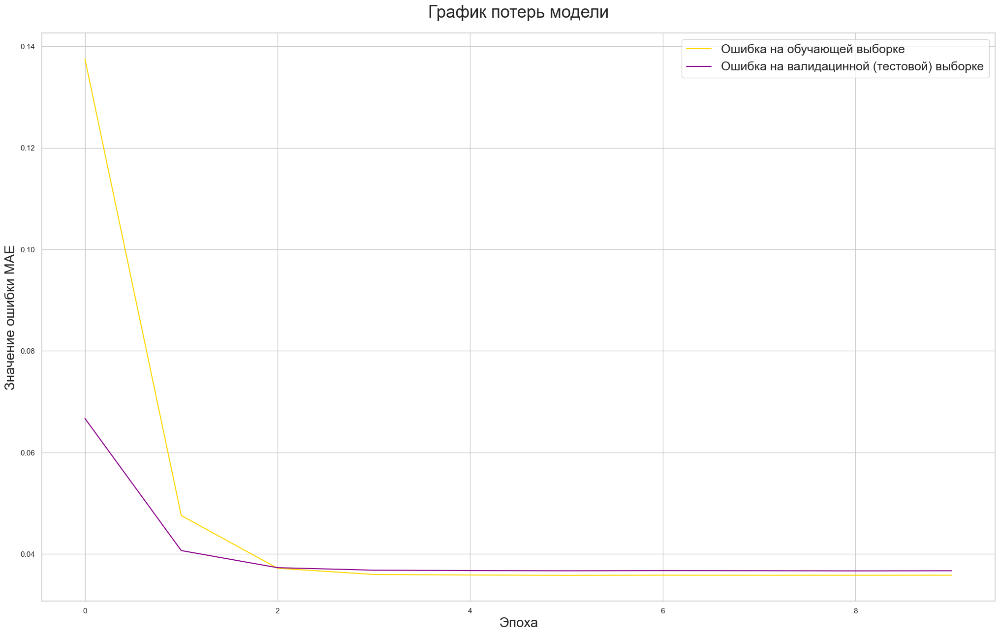

In [ ]:
# Построим график потерь на тренировочной и тестовой выборках
model_loss_plot(best_history)

In [ ]:
# Создадим функцию для визуализации прогнозных результатов y_pred для модели
def Comparision_Visualization_NN(y_test, y_pred):
    plt.figure(figsize=(15,7))
    plt.title(f'Тест и прогноз, Соотношение матрица-наполнитель', size=15)
    plt.plot(np.ravel(y_test), label = 'Тест', color = "gold")
    plt.plot(y_pred, label = 'Прогноз', color = "darkmagenta")
    plt.xlabel("Номер наблюдения", size=10)
    plt.ylabel("Соотношение матрица-наполнитель", size=10)
    plt.legend(loc='best')
    plt.show()

9/9 [==============================] - 0s 1ms/step


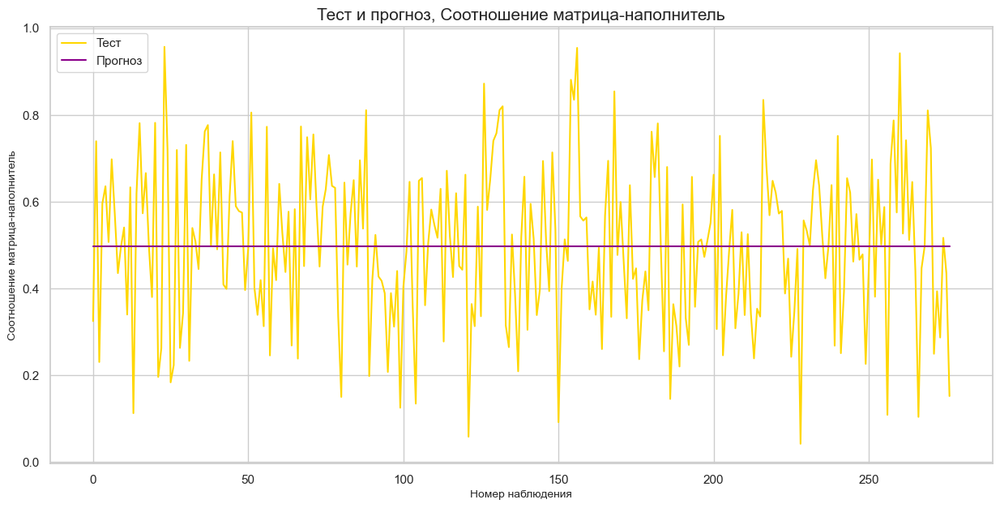

In [ ]:
Comparision_Visualization_NN(y_test_matrix, best_model.predict(X_test_matrix))

#### Вывод: 

Результат прогноза нейронной сети неудовлетворительный. Значение функции потерь - среднего квадрата ошибки (MSE) - составило 0.0336, а средней абсолютной ошибки (MAE) - 0.1491.

Полученная модель нейронной сети плохо справились с поставленной задачей прогнозирования соотношения "матрица-наполнитель".

In [ ]:
# Сохраняем модель для дальнейшего испльзования в приложении
best_model.save('model_matrix', 'C:/Users/Asus/Documents/УЧЕБА_Data Science/0. ВКР')

INFO:tensorflow:Assets written to: model_matrix\assets


INFO:tensorflow:Assets written to: model_matrix\assets


In [ ]:
# Сохраняем модель для дальнейшего испльзования в приложении
dump(best_model, 'best_model_matrix')

INFO:tensorflow:Assets written to: C:\Users\Asus\AppData\Local\Temp\tmp3emr7b44\assets


INFO:tensorflow:Assets written to: C:\Users\Asus\AppData\Local\Temp\tmp3emr7b44\assets


['best_model_matrix']

## _07. Разработка приложения для прогнозирования соотношения "матрица-наполнитель"

Создадим два варианта приложения:

* веб-приложение
* консольное

#### _07.1. Веб-приложение Flask.

Для удобства использования создан отдельный файл Application.ipynb

In [ ]:
# Инициализируем приложение Flask
app = Flask(__name__)

In [ ]:
# Загружаем модель и масштабаторы
nn_model = keras.models.load_model('C:/Users/Asus/Documents/УЧЕБА_Data Science/0. ВКР/Application//model_matrix/')
scaler_x = load('C:/Users/Asus/Documents/УЧЕБА_Data Science/0. ВКР/Application//minmax_scl_x.pkl')
scaler_y = load('C:/Users/Asus/Documents/УЧЕБА_Data Science/0. ВКР/Application//minmax_scl_y.pkl')

In [ ]:
# Определяем маршрут приложения для страницы веб-приложения по умолчанию
@app.route('/')
def home():
    return render_template('main.html')

In [ ]:
# Создаем новый маршрут приложения, который считывает ввод из формы «main.html» 
# и при нажатии кнопки "Рассчитать" выводит результат
@app.route('/predict', methods = ['POST'])
def predict():
    int_features = [float(x) for x in request.form.values()]
    X = scaler_x.transform(np.array(int_features).reshape(1,-1))
    prediction = nn_model.predict(X)
    output = scaler_y.inverse_transform(prediction) 
    return render_template('main.html', 
                           prediction_text = 'Прогнозное значение соотношения "матрица - наполнитель": {}'.format(output[0][0]))

In [ ]:
# Запуск сервера Flask
if __name__ == "__main__":
    app.run(debug=True, use_reloader=False)

 * Serving Flask app "__main__" (lazy loading)
 * Environment: production
   Use a production WSGI server instead.
 * Debug mode: on


INFO:werkzeug: * Running on http://127.0.0.1:5000/ (Press CTRL+C to quit)
INFO:werkzeug:127.0.0.1 - - [31/Mar/2023 17:01:34] "GET / HTTP/1.1" 200 -


Приложение выдает значение 2.914088010787964

Соотношение "матрица-наполнитель" для аналогичных показателей (позиция 3 датафрейма df_clean) составляет 2.767918

In [ ]:
df_clean.iloc[3]

Соотношение матрица-наполнитель            2.767918
Плотность, кг/м3                        2000.000000
модуль упругости, ГПа                    748.000000
Количество отвердителя, м.%              111.860000
Содержание эпоксидных групп,%_2           22.267857
Температура вспышки, С_2                 284.615385
Поверхностная плотность, г/м2            210.000000
Модуль упругости при растяжении, ГПа      70.000000
Прочность при растяжении, МПа           3000.000000
Потребление смолы, г/м2                  220.000000
Угол нашивки                               0.000000
Шаг нашивки                                5.000000
Плотность нашивки                         60.000000
Name: 3, dtype: float64

#### _07.2. Консольное приложение.

In [ ]:
# Создадим функцию для ввода данных
def input_variable():
    x1 = float(input('Плотность, кг/м3: '))
    x2 = float(input('Модуль упругости, ГПа: '))
    x3 = float(input('Количество отвердителя, м.%: '))
    x4 = float(input('Содержание эпоксидных групп,%_2: '))
    x5 = float(input('Температура вспышки, С_2: '))
    x6 = float(input('Поверхностная плотность, г/м2: '))
    x7 = float(input('Модуль упругости при растяжении, ГПа: '))
    x8 = float(input('Прочность при растяжении, МПа: '))
    x9 = float(input('Потребление смолы, г/м2: '))
    x10 = float(input('Угол нашивки: '))
    x11 = float(input('Шаг нашивки: '))
    x12 = float(input('Плотность нашивки: '))
    return x1, x2, x3, x4, x5, x6, x7, x8, x9, x10, x11, x12

In [ ]:
# Создадим функцию для вызова приложения
def app_model():
    # Загружаем модель и масштабаторы
    nn_model = load_model('C:/Users/Asus/Documents/УЧЕБА_Data Science/0. ВКР/Application//model_matrix/')
    scaler_x = load('C:/Users/Asus/Documents/УЧЕБА_Data Science/0. ВКР/Application//minmax_scl_x.pkl')
    scaler_y = load('C:/Users/Asus/Documents/УЧЕБА_Data Science/0. ВКР/Application//minmax_scl_y.pkl')
   
    print('Приложение прогнозирует соотношение "матрица-наполнитель"')
    for i in range(110):
        try:
            print('Введите "1" для прогноза, "2" для выхода')
            check = input()
      
            if check == '1':
                print('Введите данные для прогноза')
                X = input_variable()
                X =  scaler_x.transform(np.array(X).reshape(1,-1))
                prediction = nn_model.predict(X)
                output = scaler_y.inverse_transform(prediction) 
                print('Прогнозное значение соотношения "матрица-наполнитель": ')
                print(output[0][0])

            elif check == '2':
                break
            else:
                print('Повторите выбор')
                
        except Exception as e:
            print(e)
            print('Введены некорректные данные. Пожалуйста, повторите операцию')
            
# Запускаем приложение
app_model()

Приложение прогнозирует соотношение "матрица-наполнитель"
Введите "1" для прогноза, "2" для выхода
1
Введите данные для прогноза
Плотность, кг/м3: 2000
Модуль упругости, ГПа: 748
Количество отвердителя, м.%: 111.860000
Содержание эпоксидных групп,%_2: 22.267857
Температура вспышки, С_2: 284.615385
Поверхностная плотность, г/м2: 210
Модуль упругости при растяжении, ГПа: 70
Прочность при растяжении, МПа: 3000
Потребление смолы, г/м2: 220
Угол нашивки: 0
Шаг нашивки: 5
Плотность нашивки: 60
1/1 [==============================] - 0s 63ms/step
Прогнозное значение соотношения "матрица-наполнитель": 
2.914088
Введите "1" для прогноза, "2" для выхода
2


Приложение выдает значение 2.914088

Соотношение "матрица-наполнитель" для аналогичных показателей (позиция 3 датафрейма df_clean) составляет 2.767918

In [ ]:
df_clean.iloc[3]

Соотношение матрица-наполнитель            2.767918
Плотность, кг/м3                        2000.000000
модуль упругости, ГПа                    748.000000
Количество отвердителя, м.%              111.860000
Содержание эпоксидных групп,%_2           22.267857
Температура вспышки, С_2                 284.615385
Поверхностная плотность, г/м2            210.000000
Модуль упругости при растяжении, ГПа      70.000000
Прочность при растяжении, МПа           3000.000000
Потребление смолы, г/м2                  220.000000
Угол нашивки                               0.000000
Шаг нашивки                                5.000000
Плотность нашивки                         60.000000
Name: 3, dtype: float64

## _08. Выводы:

   В ходе работы с использованием разработанных алгоритмов была проведена обработка экспериментальных данных модуля упругости при растяжении, прочности при растяжении и соотношения «матрица-наполнитель» с использованием языка программирования python.
    
   Как показал анализ исходных данных, корреляционная зависимость между характеристиками композитов крайне слабая и стремится к нулю. Этот факт непосредственно повлиял на результат работы регрессионных моделей. Все использованные модели показали низкую прогнозирующую способность. Лучшим алгоритмом для прогноза модуля упругости при растяжении выбран AdaBoostRegressor, для прогнозирования прочности при растяжении – XGBRegressor.
    
   Созданная для рекомендации соотношения «матрица-наполнитель» нейронная сеть также плохо справилась с поставленной задачей прогноза. Такие низкие показатели работы алгоритмов машинного обучения говорят о том, что прогнозирование свойств композиционных материалов – достаточно сложный процесс, требующий  как знаний в области композиционных материалов, так и опыта в построении и использовании алгоритмов машинного обучения.
    
   Полученный неудовлетворительный результат может также свидетельствовать о недостатках и ошибках в наборе исходных данных, недостаточно глубокой и детальной обработке данных, неточностях в выборе алгоритмов машинного обучения и их параметров. 
    
   Таким образом, для успешного решения задачи, поставленной в выпускной квалификационной работе, необходимы более глубокие знания в области материаловедения и технологии конструкционных материалов, математического анализа и статистики, а также в области решения задач машинного обучения и обработки данных. Более детальное изучение данных вопросов и консультация квалифицированных специалистов из указанных областей определенно положительно повлияют на уточнение подходов и оптимизацию алгоритмов для решения задачи прогнозирования конечных свойств композиционных материалов.